<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_tumor_effnet_def.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'


/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
!pip install --upgrade tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetV2B0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [8]:
%cd '/dataset unzipped'

/dataset unzipped


In [9]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])

Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
len(X_train)

919

In [12]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_effnet')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [17]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [18]:
#def iou(y_true,y_pred):
  #pred_bbox_val = model.predict(X_val)
  #iou = tf.numpy_function(calculate_iou,[y_true,y_pred],tf.float32)
  #return iou

In [19]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
        #img = cv2.rectangle(img, (0,0),(10,10), (0, 0, 255), 1)
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [20]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [21]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_EFFNET/model_EFFNET.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [22]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    include_optimizer=False,
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [23]:
effnet = EfficientNetV2B0(weights='imagenet',include_top=False,input_shape=(image_size,image_size,3))
model = effnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=effnet.inputs, outputs = model)

24274472/24274472 [==============================] - 1s 0us/step


In [24]:
def get_config(self):
    config = super().get_config()
    return config

In [25]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/200
52/52 [==============================] - ETA: 0s - loss: 48.4466 - IoU: 0.0015
Epoch 1: val_loss improved from inf to 29.64178, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 28ms/step


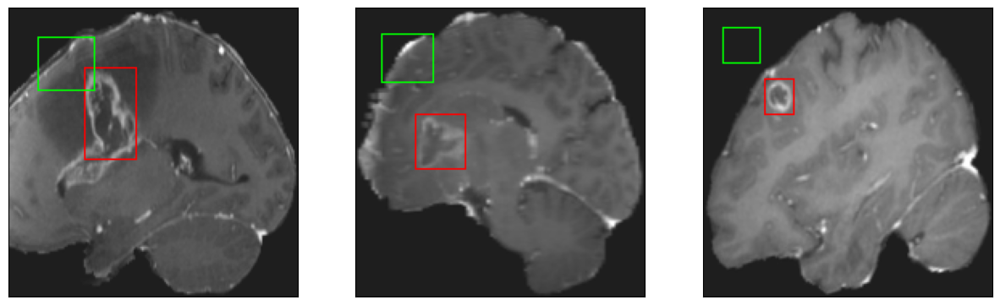

52/52 [==============================] - 80s 316ms/step - loss: 48.4466 - IoU: 0.0015 - val_loss: 29.6418 - val_IoU: 0.0307
Epoch 2/200
52/52 [==============================] - ETA: 0s - loss: 28.6197 - IoU: 0.0436
Epoch 2: val_loss improved from 29.64178 to 20.94197, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 29ms/step


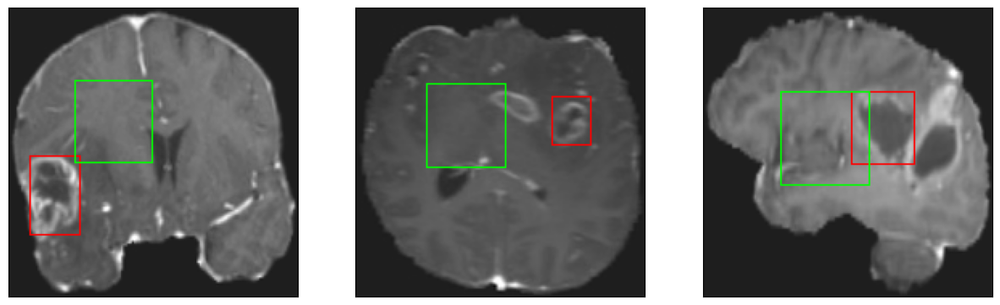

52/52 [==============================] - 9s 171ms/step - loss: 28.6197 - IoU: 0.0436 - val_loss: 20.9420 - val_IoU: 0.1335
Epoch 3/200
52/52 [==============================] - ETA: 0s - loss: 20.6563 - IoU: 0.0924
Epoch 3: val_loss improved from 20.94197 to 19.04727, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


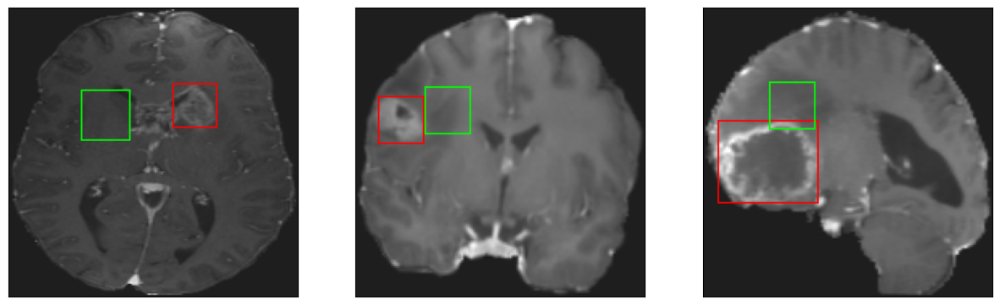

52/52 [==============================] - 7s 142ms/step - loss: 20.6563 - IoU: 0.0924 - val_loss: 19.0473 - val_IoU: 0.0722
Epoch 4/200
52/52 [==============================] - ETA: 0s - loss: 18.0502 - IoU: 0.1155
Epoch 4: val_loss improved from 19.04727 to 14.95494, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


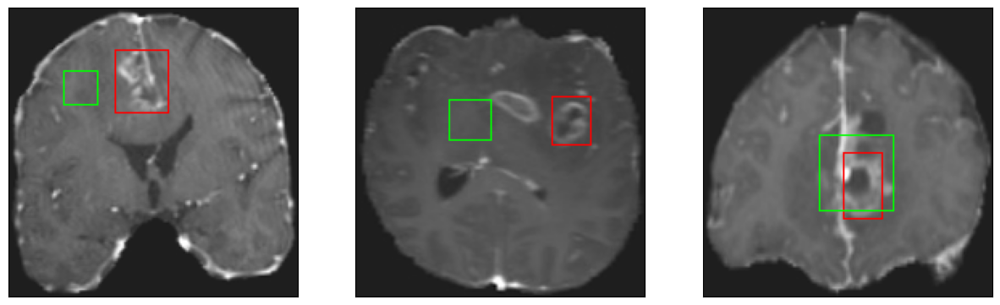

52/52 [==============================] - 8s 148ms/step - loss: 18.0502 - IoU: 0.1155 - val_loss: 14.9549 - val_IoU: 0.1675
Epoch 5/200
52/52 [==============================] - ETA: 0s - loss: 14.2158 - IoU: 0.1888
Epoch 5: val_loss improved from 14.95494 to 12.30035, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


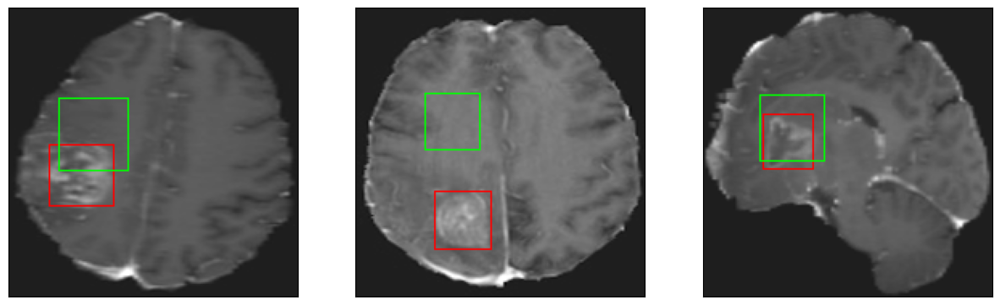

52/52 [==============================] - 8s 160ms/step - loss: 14.2158 - IoU: 0.1888 - val_loss: 12.3003 - val_IoU: 0.2766
Epoch 6/200
52/52 [==============================] - ETA: 0s - loss: 12.2663 - IoU: 0.2440
Epoch 6: val_loss improved from 12.30035 to 10.77281, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


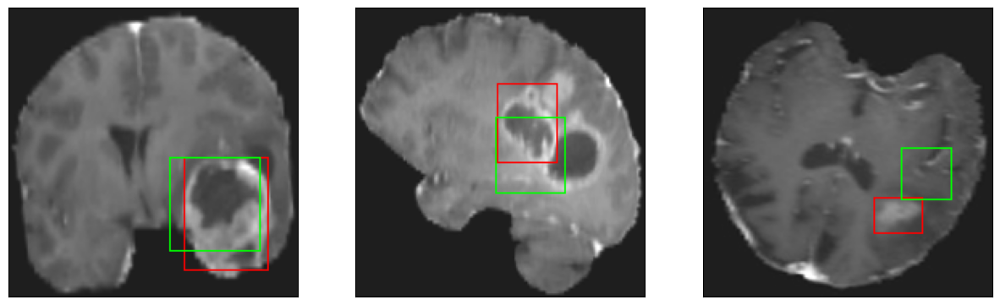

52/52 [==============================] - 7s 138ms/step - loss: 12.2663 - IoU: 0.2440 - val_loss: 10.7728 - val_IoU: 0.3216
Epoch 7/200
52/52 [==============================] - ETA: 0s - loss: 10.1538 - IoU: 0.3157
Epoch 7: val_loss improved from 10.77281 to 7.80608, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


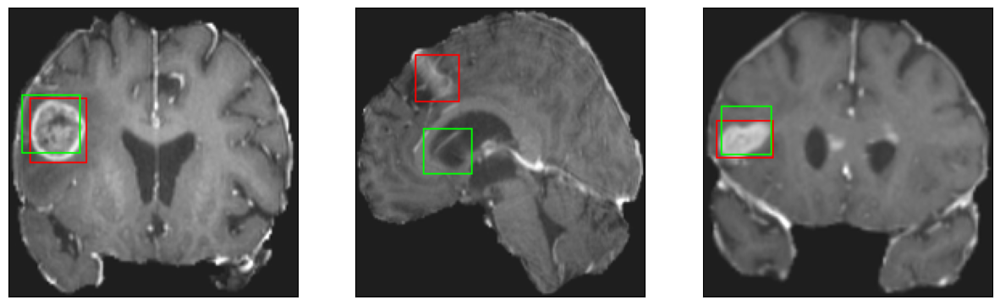

52/52 [==============================] - 8s 160ms/step - loss: 10.1538 - IoU: 0.3157 - val_loss: 7.8061 - val_IoU: 0.4671
Epoch 8/200
52/52 [==============================] - ETA: 0s - loss: 8.7456 - IoU: 0.3644
Epoch 8: val_loss did not improve from 7.80608
8/8 [==============================] - 0s 30ms/step


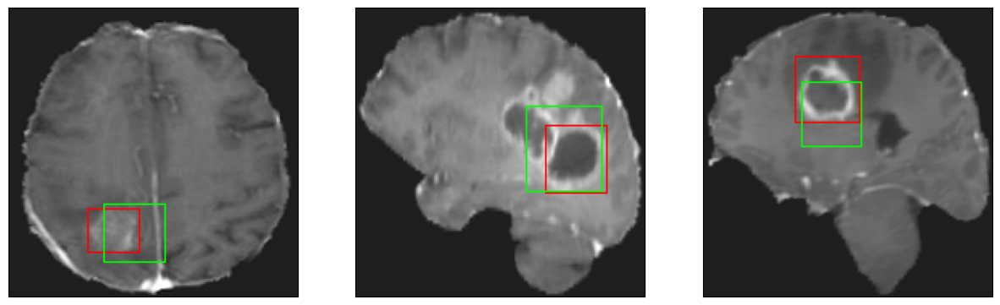

52/52 [==============================] - 6s 116ms/step - loss: 8.7456 - IoU: 0.3644 - val_loss: 9.1063 - val_IoU: 0.3479
Epoch 9/200
52/52 [==============================] - ETA: 0s - loss: 7.8548 - IoU: 0.3962
Epoch 9: val_loss improved from 7.80608 to 7.05391, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


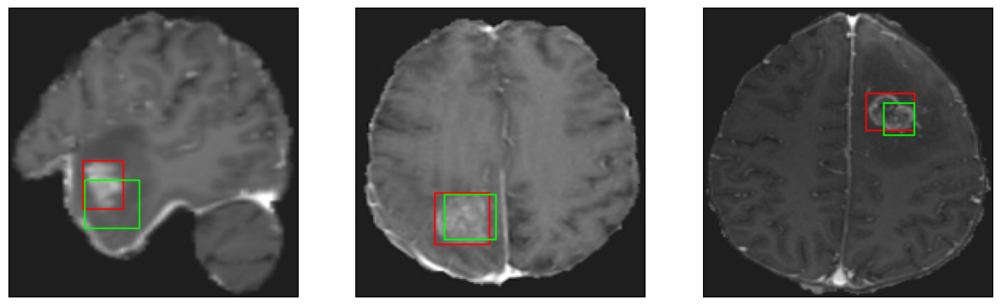

52/52 [==============================] - 8s 159ms/step - loss: 7.8548 - IoU: 0.3962 - val_loss: 7.0539 - val_IoU: 0.4773
Epoch 10/200
52/52 [==============================] - ETA: 0s - loss: 7.4150 - IoU: 0.4295
Epoch 10: val_loss did not improve from 7.05391
8/8 [==============================] - 0s 31ms/step


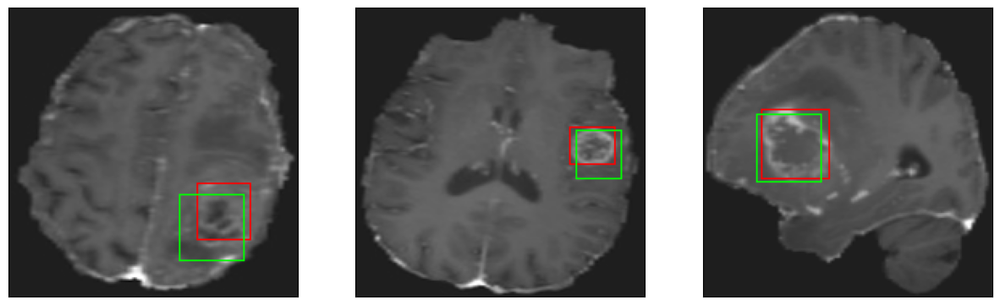

52/52 [==============================] - 7s 131ms/step - loss: 7.4150 - IoU: 0.4295 - val_loss: 7.1023 - val_IoU: 0.4836
Epoch 11/200
52/52 [==============================] - ETA: 0s - loss: 7.3080 - IoU: 0.4365
Epoch 11: val_loss improved from 7.05391 to 6.98962, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


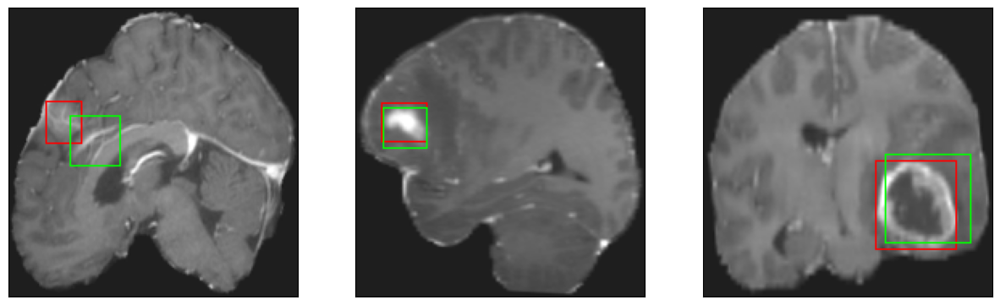

52/52 [==============================] - 9s 167ms/step - loss: 7.3080 - IoU: 0.4365 - val_loss: 6.9896 - val_IoU: 0.5017
Epoch 12/200
52/52 [==============================] - ETA: 0s - loss: 6.7665 - IoU: 0.4613
Epoch 12: val_loss improved from 6.98962 to 6.75291, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


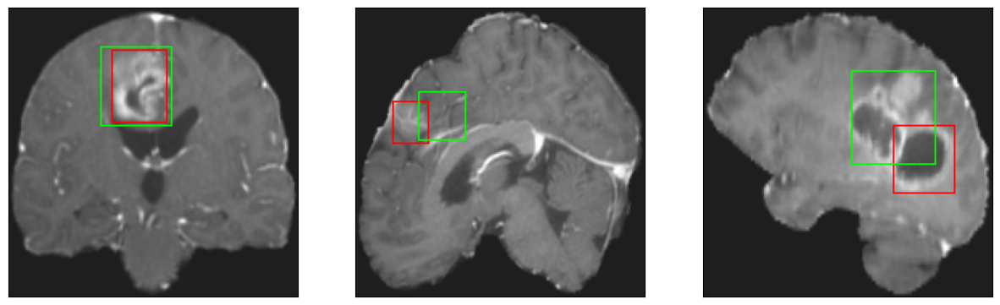

52/52 [==============================] - 7s 144ms/step - loss: 6.7665 - IoU: 0.4613 - val_loss: 6.7529 - val_IoU: 0.5301
Epoch 13/200
52/52 [==============================] - ETA: 0s - loss: 6.3336 - IoU: 0.4889
Epoch 13: val_loss improved from 6.75291 to 6.23066, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


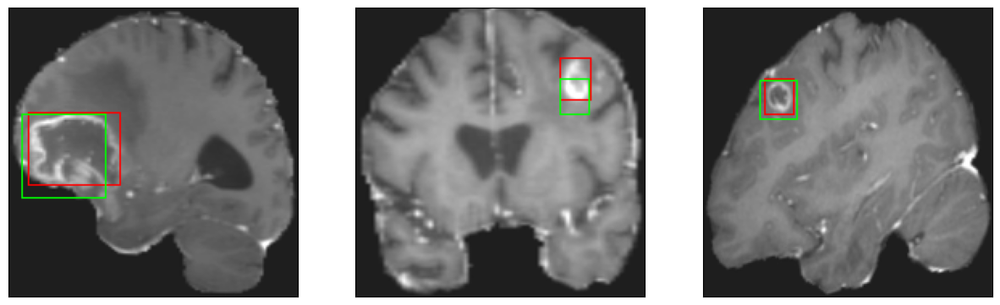

52/52 [==============================] - 8s 157ms/step - loss: 6.3336 - IoU: 0.4889 - val_loss: 6.2307 - val_IoU: 0.5547
Epoch 14/200
52/52 [==============================] - ETA: 0s - loss: 6.5498 - IoU: 0.4693
Epoch 14: val_loss did not improve from 6.23066
8/8 [==============================] - 0s 36ms/step


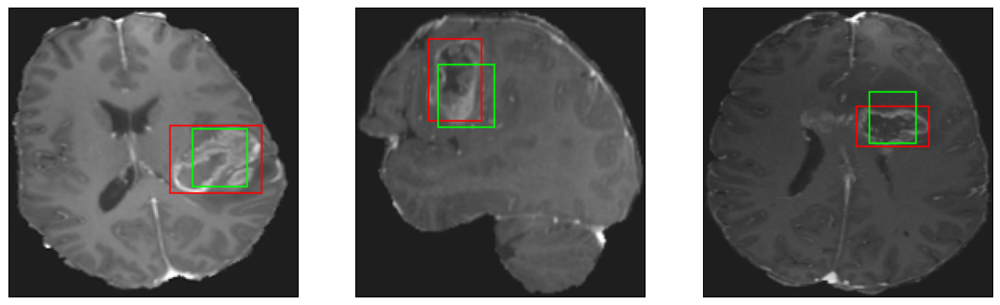

52/52 [==============================] - 7s 130ms/step - loss: 6.5498 - IoU: 0.4693 - val_loss: 6.2807 - val_IoU: 0.5608
Epoch 15/200
52/52 [==============================] - ETA: 0s - loss: 6.2616 - IoU: 0.4869
Epoch 15: val_loss improved from 6.23066 to 6.06677, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


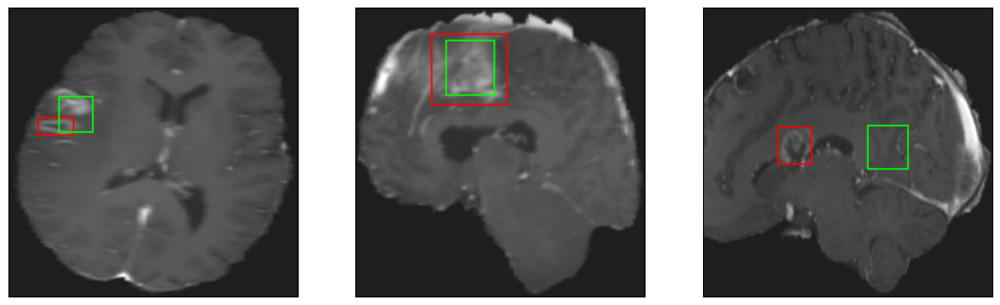

52/52 [==============================] - 9s 176ms/step - loss: 6.2616 - IoU: 0.4869 - val_loss: 6.0668 - val_IoU: 0.6000
Epoch 16/200
52/52 [==============================] - ETA: 0s - loss: 5.9594 - IoU: 0.5147
Epoch 16: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 34ms/step


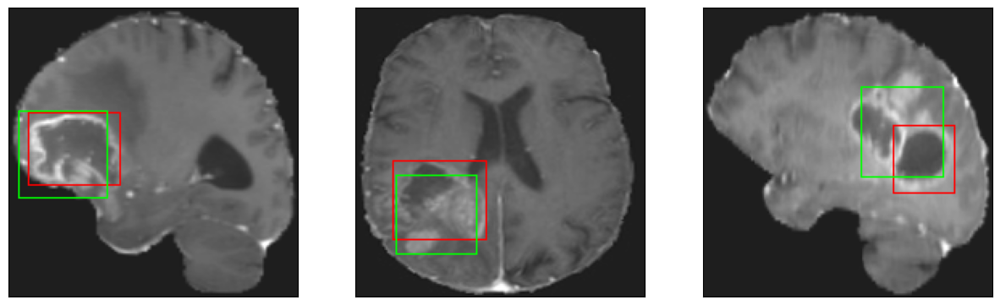

52/52 [==============================] - 8s 147ms/step - loss: 5.9594 - IoU: 0.5147 - val_loss: 6.2214 - val_IoU: 0.5712
Epoch 17/200
52/52 [==============================] - ETA: 0s - loss: 5.8720 - IoU: 0.5244
Epoch 17: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 33ms/step


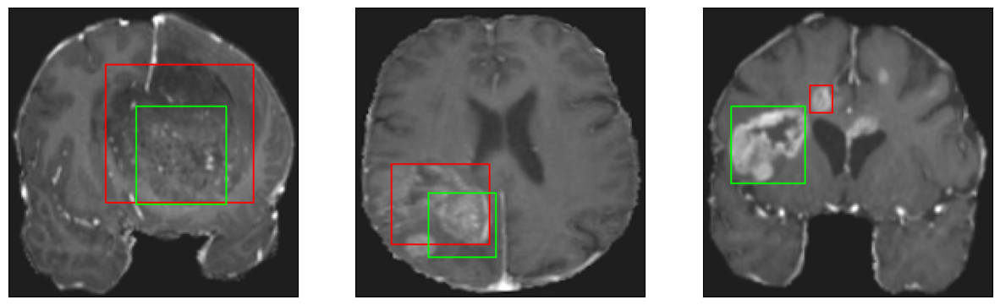

52/52 [==============================] - 7s 126ms/step - loss: 5.8720 - IoU: 0.5244 - val_loss: 6.3096 - val_IoU: 0.5716
Epoch 18/200
52/52 [==============================] - ETA: 0s - loss: 5.7619 - IoU: 0.5353
Epoch 18: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 31ms/step


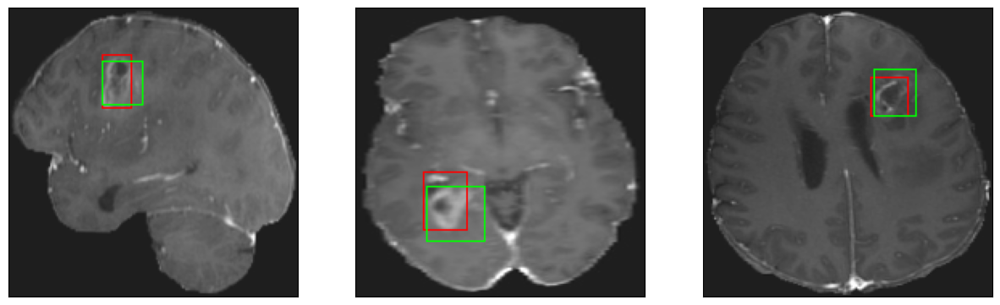

52/52 [==============================] - 8s 147ms/step - loss: 5.7619 - IoU: 0.5353 - val_loss: 6.3758 - val_IoU: 0.5821
Epoch 19/200
52/52 [==============================] - ETA: 0s - loss: 6.0594 - IoU: 0.5109
Epoch 19: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 31ms/step


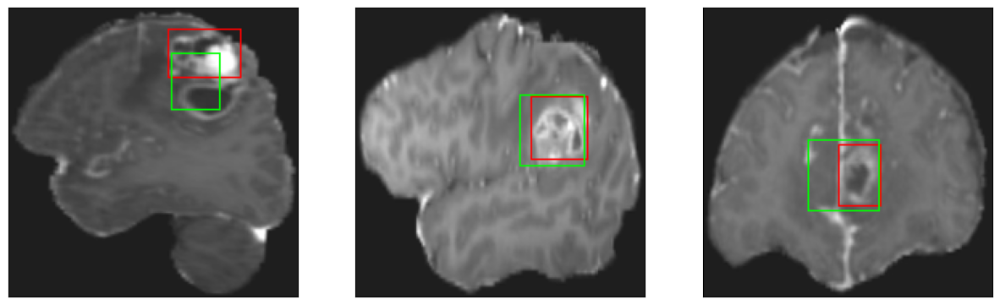

52/52 [==============================] - 6s 124ms/step - loss: 6.0594 - IoU: 0.5109 - val_loss: 6.7785 - val_IoU: 0.5618
Epoch 20/200
52/52 [==============================] - ETA: 0s - loss: 5.5849 - IoU: 0.5501
Epoch 20: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 32ms/step


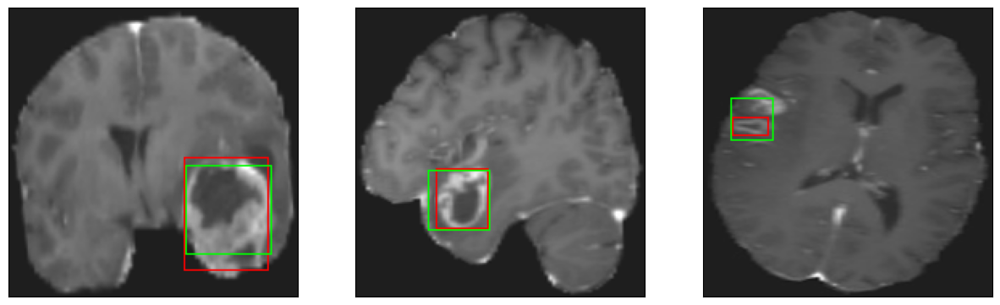

52/52 [==============================] - 8s 145ms/step - loss: 5.5849 - IoU: 0.5501 - val_loss: 6.1689 - val_IoU: 0.5910
Epoch 21/200
52/52 [==============================] - ETA: 0s - loss: 5.6871 - IoU: 0.5279
Epoch 21: val_loss did not improve from 6.06677
8/8 [==============================] - 0s 32ms/step


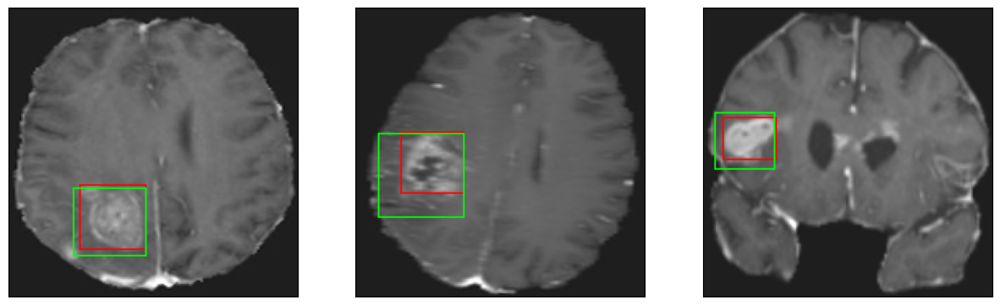

52/52 [==============================] - 7s 127ms/step - loss: 5.6871 - IoU: 0.5279 - val_loss: 7.2365 - val_IoU: 0.5395
Epoch 22/200
52/52 [==============================] - ETA: 0s - loss: 5.4712 - IoU: 0.5516
Epoch 22: val_loss improved from 6.06677 to 5.94344, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


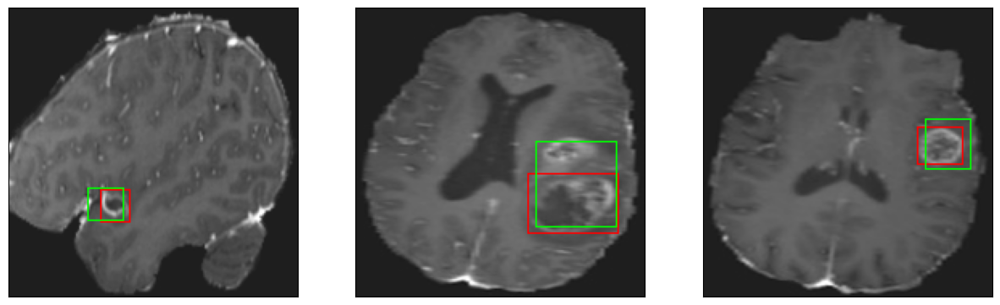

52/52 [==============================] - 8s 164ms/step - loss: 5.4712 - IoU: 0.5516 - val_loss: 5.9434 - val_IoU: 0.5948
Epoch 23/200
52/52 [==============================] - ETA: 0s - loss: 5.3778 - IoU: 0.5601
Epoch 23: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 32ms/step


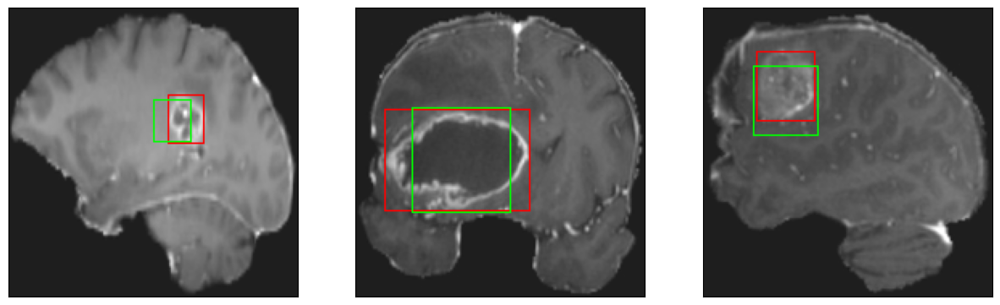

52/52 [==============================] - 7s 143ms/step - loss: 5.3778 - IoU: 0.5601 - val_loss: 6.4484 - val_IoU: 0.5344
Epoch 24/200
52/52 [==============================] - ETA: 0s - loss: 5.5071 - IoU: 0.5487
Epoch 24: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 34ms/step


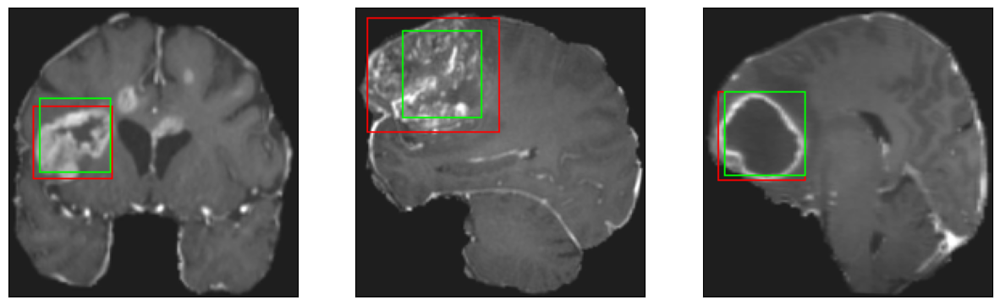

52/52 [==============================] - 7s 136ms/step - loss: 5.5071 - IoU: 0.5487 - val_loss: 6.1048 - val_IoU: 0.5719
Epoch 25/200
52/52 [==============================] - ETA: 0s - loss: 4.9615 - IoU: 0.6011
Epoch 25: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 31ms/step


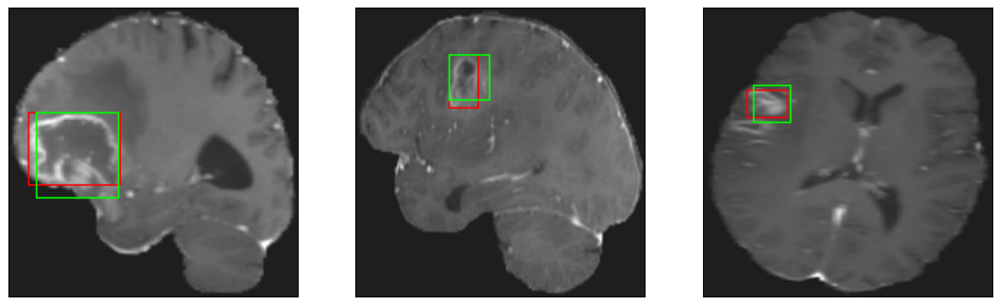

52/52 [==============================] - 7s 137ms/step - loss: 4.9615 - IoU: 0.6011 - val_loss: 6.1918 - val_IoU: 0.5530
Epoch 26/200
52/52 [==============================] - ETA: 0s - loss: 5.2764 - IoU: 0.5639
Epoch 26: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 32ms/step


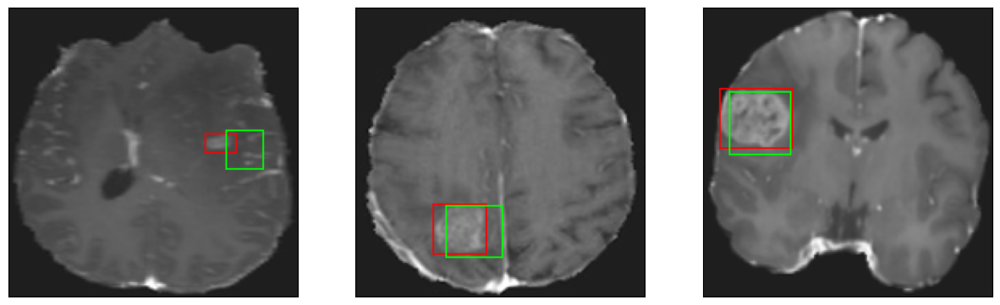

52/52 [==============================] - 6s 122ms/step - loss: 5.2764 - IoU: 0.5639 - val_loss: 6.3293 - val_IoU: 0.5644
Epoch 27/200
52/52 [==============================] - ETA: 0s - loss: 5.0467 - IoU: 0.5880
Epoch 27: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 32ms/step


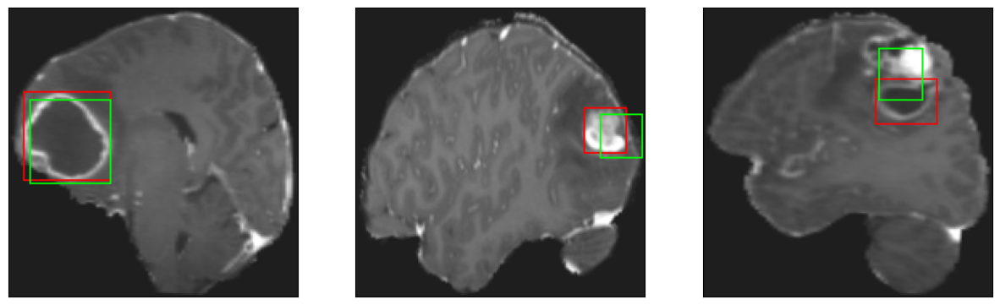

52/52 [==============================] - 8s 151ms/step - loss: 5.0467 - IoU: 0.5880 - val_loss: 6.5449 - val_IoU: 0.5304
Epoch 28/200
52/52 [==============================] - ETA: 0s - loss: 4.8374 - IoU: 0.6144
Epoch 28: val_loss did not improve from 5.94344
8/8 [==============================] - 0s 31ms/step


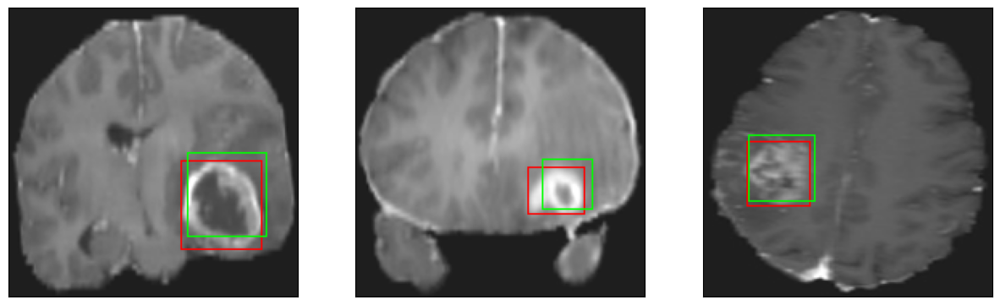

52/52 [==============================] - 7s 128ms/step - loss: 4.8374 - IoU: 0.6144 - val_loss: 6.1615 - val_IoU: 0.5501
Epoch 29/200
52/52 [==============================] - ETA: 0s - loss: 4.6602 - IoU: 0.6141
Epoch 29: val_loss improved from 5.94344 to 5.87439, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


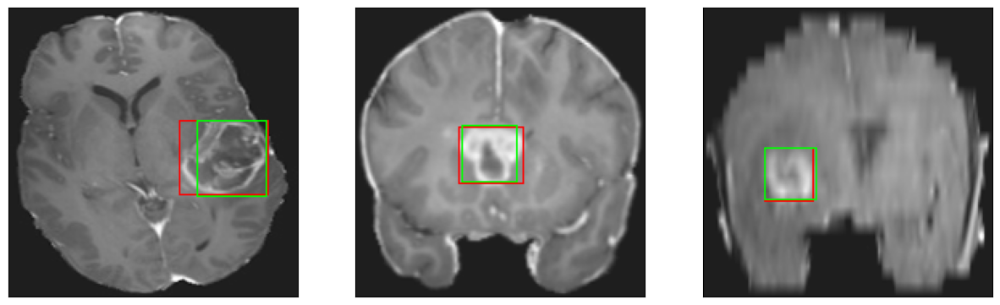

52/52 [==============================] - 9s 179ms/step - loss: 4.6602 - IoU: 0.6141 - val_loss: 5.8744 - val_IoU: 0.6220
Epoch 30/200
52/52 [==============================] - ETA: 0s - loss: 4.7798 - IoU: 0.6132
Epoch 30: val_loss improved from 5.87439 to 5.70911, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


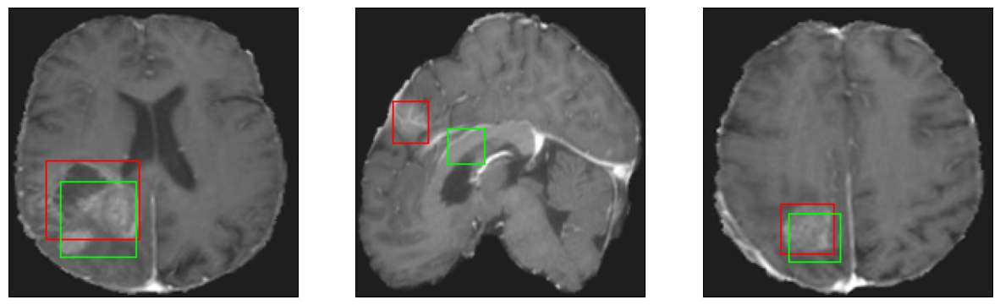

52/52 [==============================] - 8s 157ms/step - loss: 4.7798 - IoU: 0.6132 - val_loss: 5.7091 - val_IoU: 0.6304
Epoch 31/200
52/52 [==============================] - ETA: 0s - loss: 4.6056 - IoU: 0.6209
Epoch 31: val_loss did not improve from 5.70911
8/8 [==============================] - 0s 31ms/step


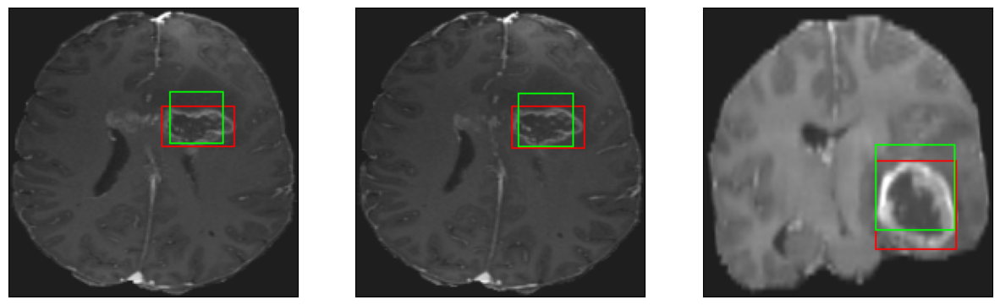

52/52 [==============================] - 7s 129ms/step - loss: 4.6056 - IoU: 0.6209 - val_loss: 6.0052 - val_IoU: 0.5868
Epoch 32/200
52/52 [==============================] - ETA: 0s - loss: 4.5377 - IoU: 0.6255
Epoch 32: val_loss did not improve from 5.70911
8/8 [==============================] - 0s 33ms/step


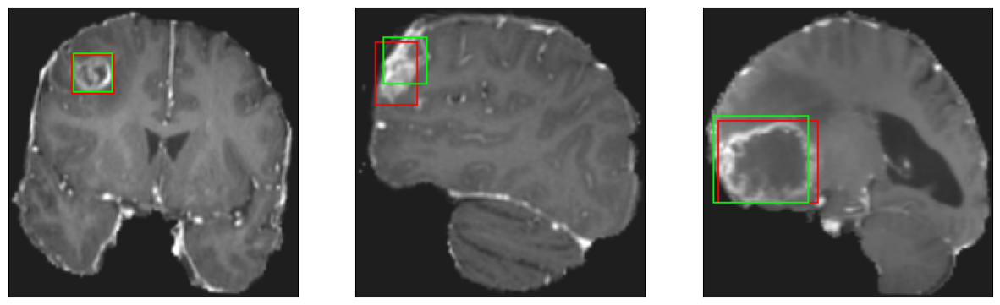

52/52 [==============================] - 7s 143ms/step - loss: 4.5377 - IoU: 0.6255 - val_loss: 5.7109 - val_IoU: 0.5999
Epoch 33/200
52/52 [==============================] - ETA: 0s - loss: 4.2843 - IoU: 0.6283
Epoch 33: val_loss did not improve from 5.70911
8/8 [==============================] - 0s 31ms/step


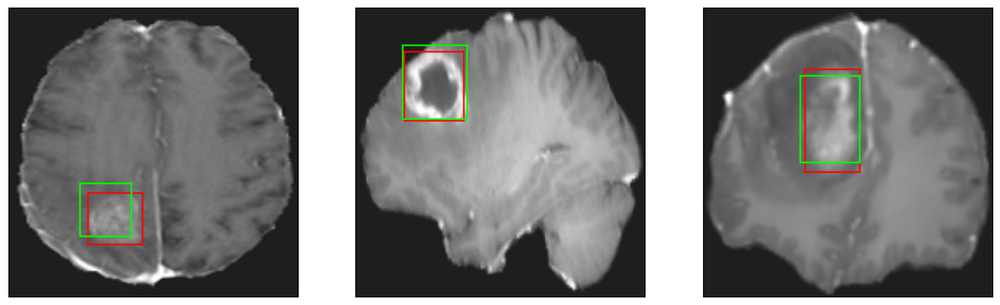

52/52 [==============================] - 7s 125ms/step - loss: 4.2843 - IoU: 0.6283 - val_loss: 5.7817 - val_IoU: 0.5667
Epoch 34/200
52/52 [==============================] - ETA: 0s - loss: 4.2234 - IoU: 0.6406
Epoch 34: val_loss did not improve from 5.70911
8/8 [==============================] - 0s 34ms/step


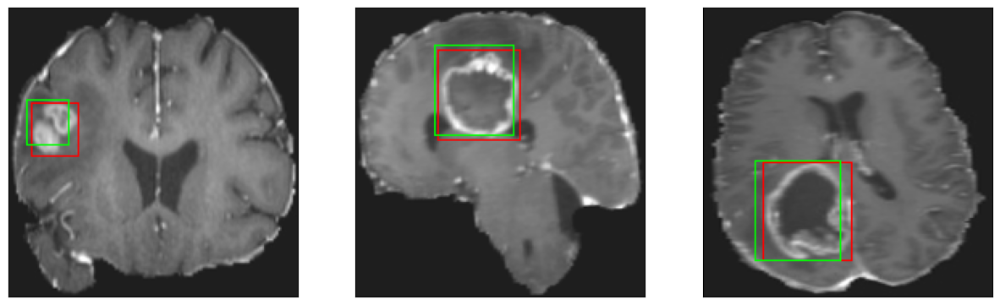

52/52 [==============================] - 7s 142ms/step - loss: 4.2234 - IoU: 0.6406 - val_loss: 5.7749 - val_IoU: 0.5615
Epoch 35/200
52/52 [==============================] - ETA: 0s - loss: 3.9547 - IoU: 0.6574
Epoch 35: val_loss improved from 5.70911 to 5.56426, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 33ms/step


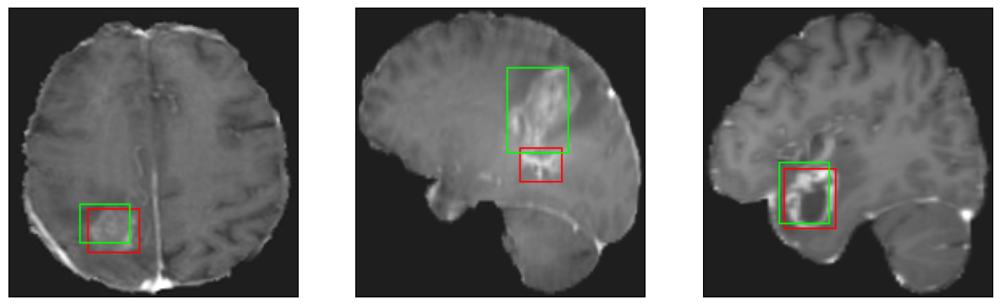

52/52 [==============================] - 9s 172ms/step - loss: 3.9547 - IoU: 0.6574 - val_loss: 5.5643 - val_IoU: 0.6143
Epoch 36/200
52/52 [==============================] - ETA: 0s - loss: 4.1108 - IoU: 0.6415
Epoch 36: val_loss improved from 5.56426 to 5.23711, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 30ms/step


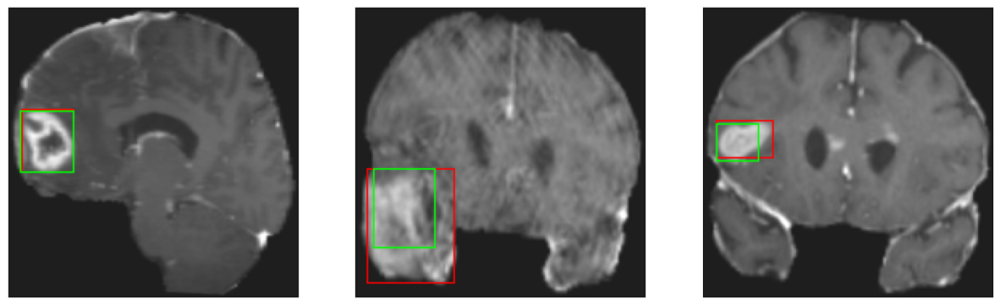

52/52 [==============================] - 9s 169ms/step - loss: 4.1108 - IoU: 0.6415 - val_loss: 5.2371 - val_IoU: 0.6406
Epoch 37/200
52/52 [==============================] - ETA: 0s - loss: 4.0024 - IoU: 0.6602
Epoch 37: val_loss improved from 5.23711 to 5.08114, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


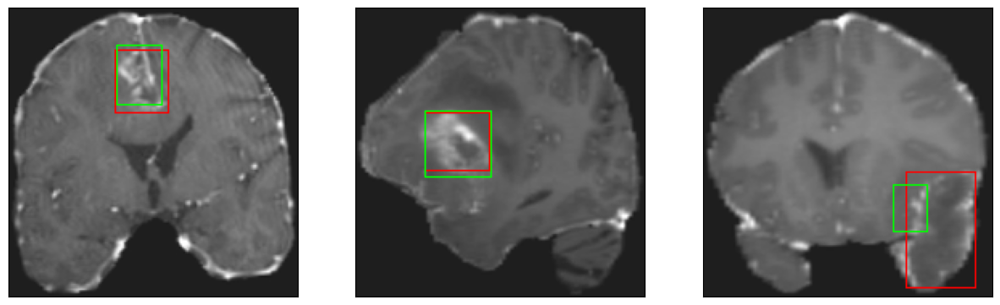

52/52 [==============================] - 10s 188ms/step - loss: 4.0024 - IoU: 0.6602 - val_loss: 5.0811 - val_IoU: 0.6547
Epoch 38/200
52/52 [==============================] - ETA: 0s - loss: 3.8996 - IoU: 0.6629
Epoch 38: val_loss did not improve from 5.08114
8/8 [==============================] - 0s 30ms/step


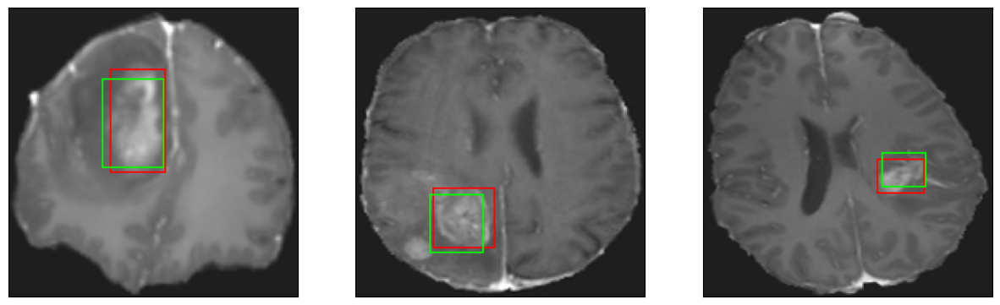

52/52 [==============================] - 7s 128ms/step - loss: 3.8996 - IoU: 0.6629 - val_loss: 5.0843 - val_IoU: 0.6342
Epoch 39/200
52/52 [==============================] - ETA: 0s - loss: 3.7376 - IoU: 0.6687
Epoch 39: val_loss did not improve from 5.08114
8/8 [==============================] - 0s 30ms/step


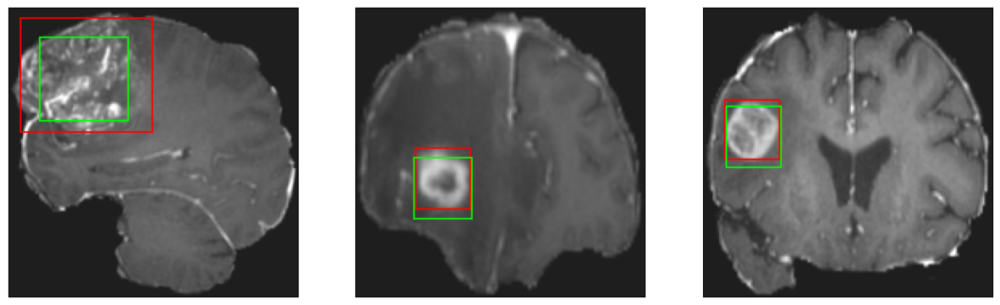

52/52 [==============================] - 7s 128ms/step - loss: 3.7376 - IoU: 0.6687 - val_loss: 5.2266 - val_IoU: 0.6411
Epoch 40/200
52/52 [==============================] - ETA: 0s - loss: 3.7502 - IoU: 0.6725
Epoch 40: val_loss improved from 5.08114 to 4.94210, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


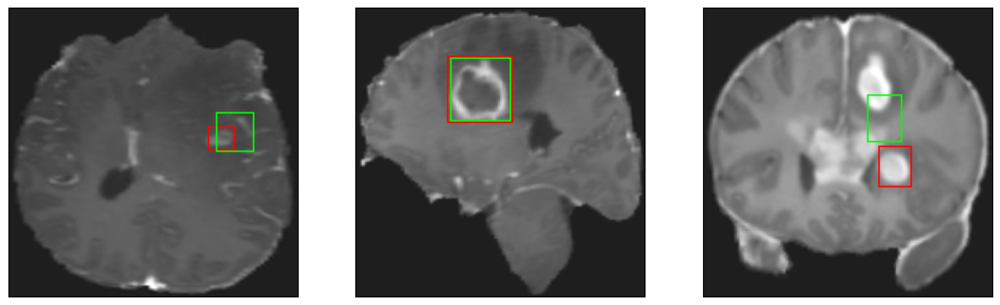

52/52 [==============================] - 10s 188ms/step - loss: 3.7502 - IoU: 0.6725 - val_loss: 4.9421 - val_IoU: 0.6501
Epoch 41/200
52/52 [==============================] - ETA: 0s - loss: 3.7764 - IoU: 0.6644
Epoch 41: val_loss improved from 4.94210 to 4.76813, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


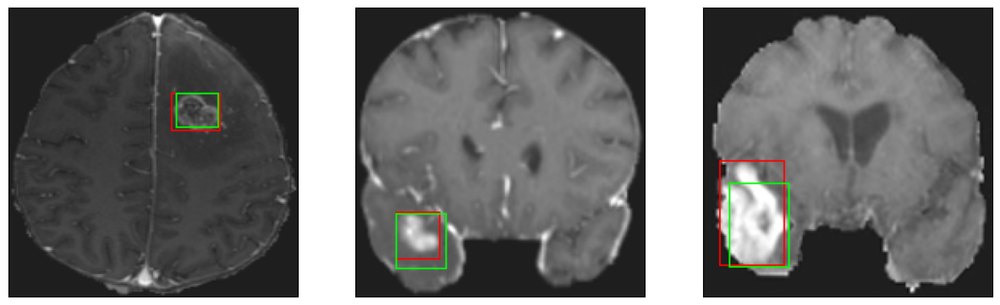

52/52 [==============================] - 8s 152ms/step - loss: 3.7764 - IoU: 0.6644 - val_loss: 4.7681 - val_IoU: 0.6543
Epoch 42/200
52/52 [==============================] - ETA: 0s - loss: 3.7500 - IoU: 0.6726
Epoch 42: val_loss did not improve from 4.76813
8/8 [==============================] - 0s 31ms/step


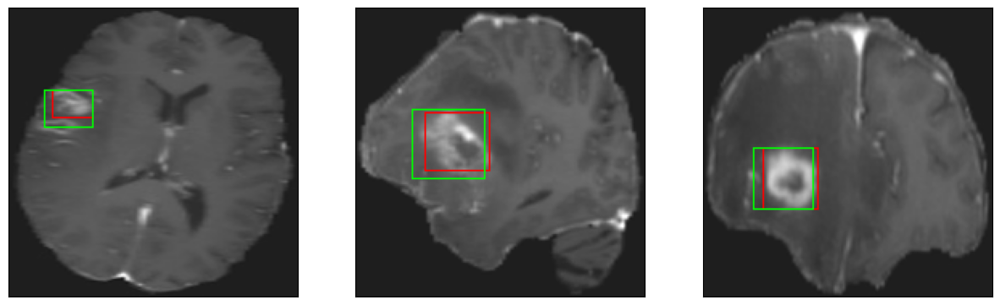

52/52 [==============================] - 8s 146ms/step - loss: 3.7500 - IoU: 0.6726 - val_loss: 5.3328 - val_IoU: 0.6446
Epoch 43/200
52/52 [==============================] - ETA: 0s - loss: 3.9145 - IoU: 0.6660
Epoch 43: val_loss did not improve from 4.76813
8/8 [==============================] - 0s 31ms/step


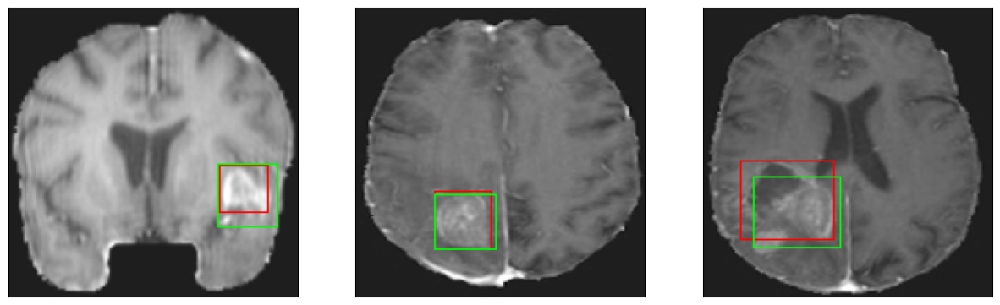

52/52 [==============================] - 7s 133ms/step - loss: 3.9145 - IoU: 0.6660 - val_loss: 5.2957 - val_IoU: 0.6243
Epoch 44/200
52/52 [==============================] - ETA: 0s - loss: 3.5328 - IoU: 0.6916
Epoch 44: val_loss improved from 4.76813 to 4.66198, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


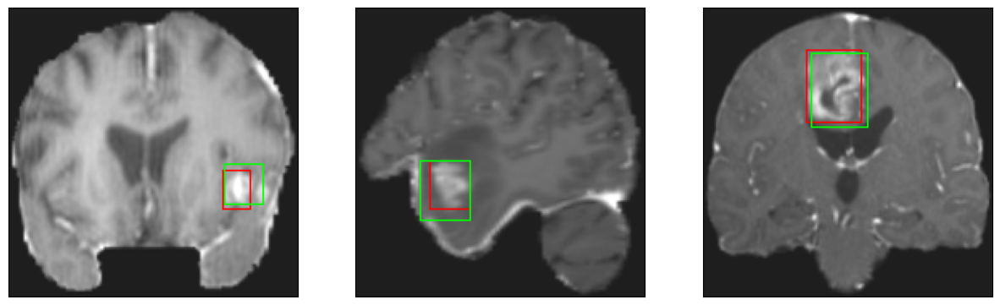

52/52 [==============================] - 10s 186ms/step - loss: 3.5328 - IoU: 0.6916 - val_loss: 4.6620 - val_IoU: 0.6891
Epoch 45/200
52/52 [==============================] - ETA: 0s - loss: 3.6056 - IoU: 0.6751
Epoch 45: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 30ms/step


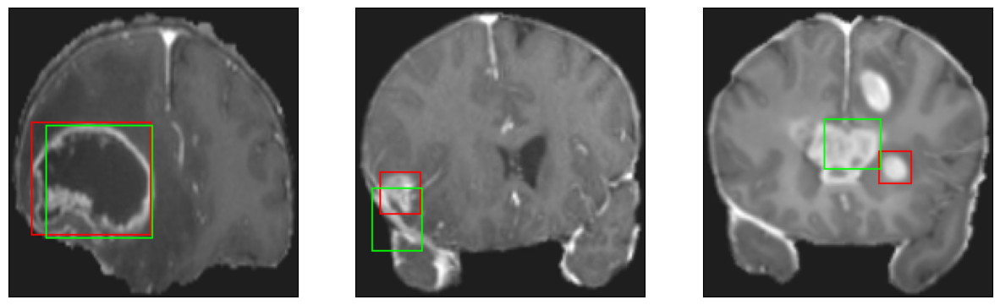

52/52 [==============================] - 7s 126ms/step - loss: 3.6056 - IoU: 0.6751 - val_loss: 5.5658 - val_IoU: 0.6092
Epoch 46/200
52/52 [==============================] - ETA: 0s - loss: 3.7209 - IoU: 0.6846
Epoch 46: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 32ms/step


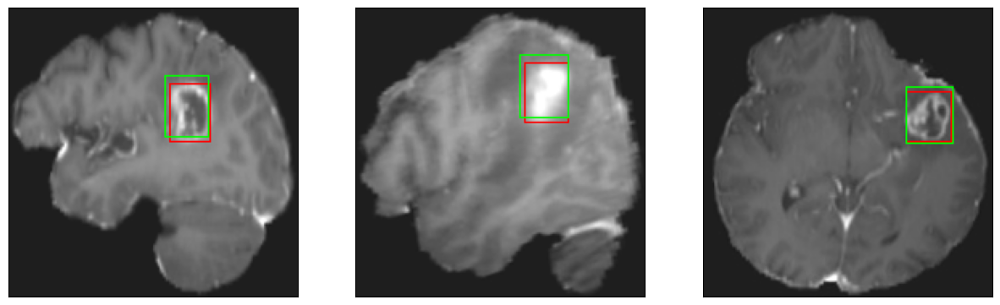

52/52 [==============================] - 8s 145ms/step - loss: 3.7209 - IoU: 0.6846 - val_loss: 4.7144 - val_IoU: 0.6868
Epoch 47/200
52/52 [==============================] - ETA: 0s - loss: 3.6101 - IoU: 0.6797
Epoch 47: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 30ms/step


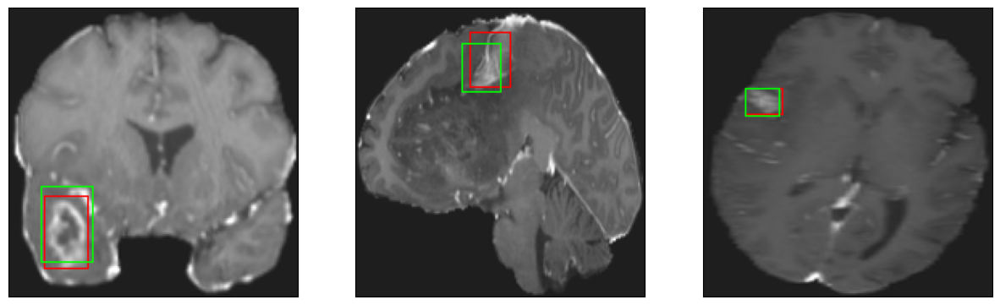

52/52 [==============================] - 7s 127ms/step - loss: 3.6101 - IoU: 0.6797 - val_loss: 4.9459 - val_IoU: 0.6562
Epoch 48/200
52/52 [==============================] - ETA: 0s - loss: 3.4698 - IoU: 0.6918
Epoch 48: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 31ms/step


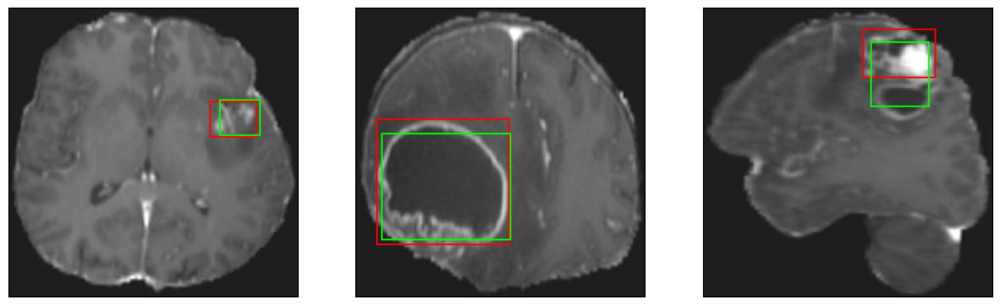

52/52 [==============================] - 7s 130ms/step - loss: 3.4698 - IoU: 0.6918 - val_loss: 5.2896 - val_IoU: 0.6271
Epoch 49/200
52/52 [==============================] - ETA: 0s - loss: 3.4434 - IoU: 0.7013
Epoch 49: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 32ms/step


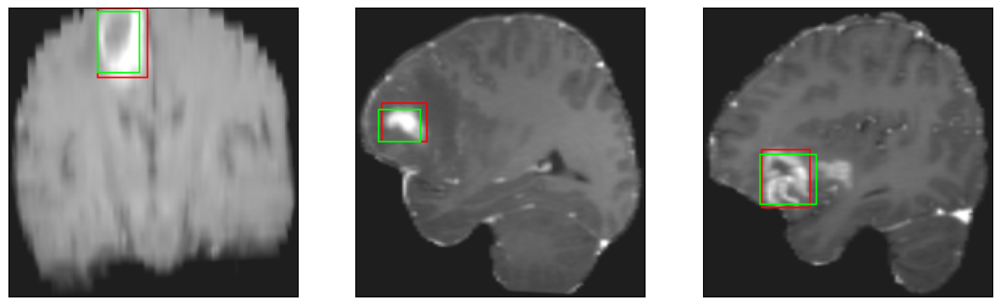

52/52 [==============================] - 7s 134ms/step - loss: 3.4434 - IoU: 0.7013 - val_loss: 5.3669 - val_IoU: 0.6483
Epoch 50/200
52/52 [==============================] - ETA: 0s - loss: 3.3765 - IoU: 0.7054
Epoch 50: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 31ms/step


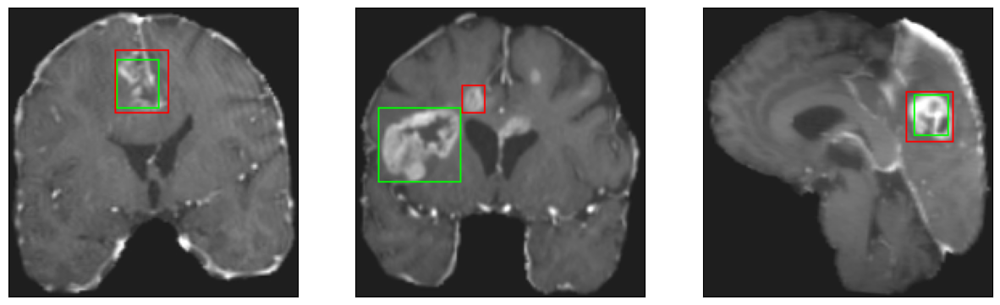

52/52 [==============================] - 7s 128ms/step - loss: 3.3765 - IoU: 0.7054 - val_loss: 4.7775 - val_IoU: 0.6852
Epoch 51/200
52/52 [==============================] - ETA: 0s - loss: 3.2871 - IoU: 0.7064
Epoch 51: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 31ms/step


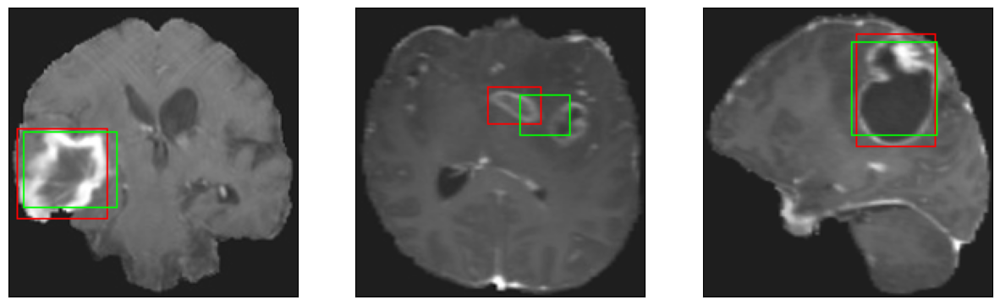

52/52 [==============================] - 8s 145ms/step - loss: 3.2871 - IoU: 0.7064 - val_loss: 4.7789 - val_IoU: 0.6867
Epoch 52/200
52/52 [==============================] - ETA: 0s - loss: 3.1277 - IoU: 0.7158
Epoch 52: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 31ms/step


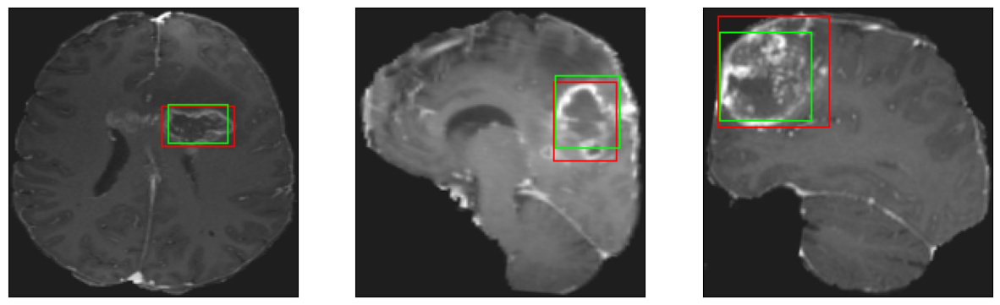

52/52 [==============================] - 7s 134ms/step - loss: 3.1277 - IoU: 0.7158 - val_loss: 4.8360 - val_IoU: 0.6706
Epoch 53/200
52/52 [==============================] - ETA: 0s - loss: 3.1692 - IoU: 0.7158
Epoch 53: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 30ms/step


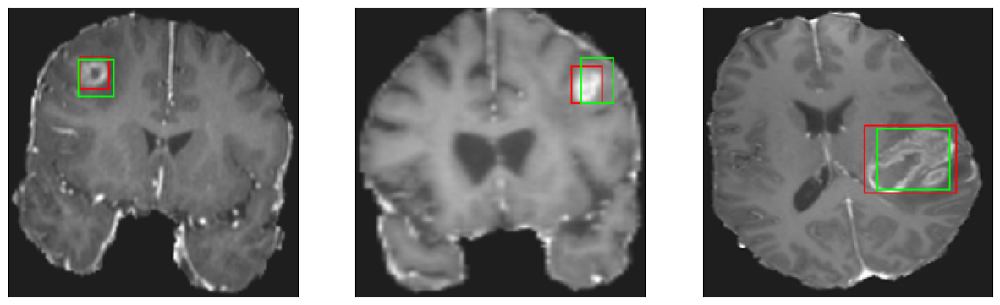

52/52 [==============================] - 7s 133ms/step - loss: 3.1692 - IoU: 0.7158 - val_loss: 4.7533 - val_IoU: 0.6699
Epoch 54/200
52/52 [==============================] - ETA: 0s - loss: 3.2960 - IoU: 0.7143
Epoch 54: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 34ms/step


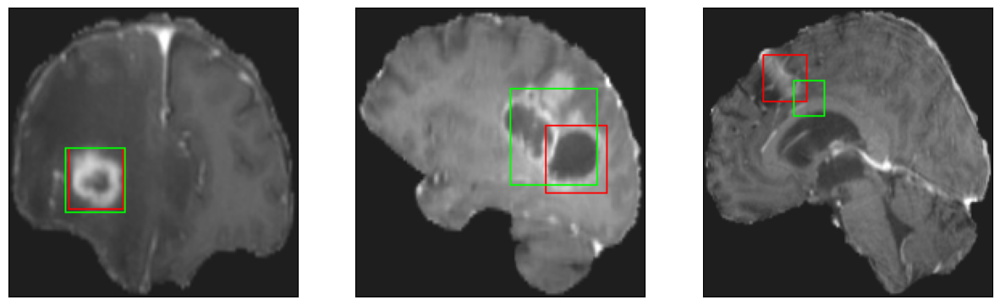

52/52 [==============================] - 7s 134ms/step - loss: 3.2960 - IoU: 0.7143 - val_loss: 4.9998 - val_IoU: 0.6701
Epoch 55/200
52/52 [==============================] - ETA: 0s - loss: 3.2822 - IoU: 0.7046
Epoch 55: val_loss did not improve from 4.66198
8/8 [==============================] - 0s 31ms/step


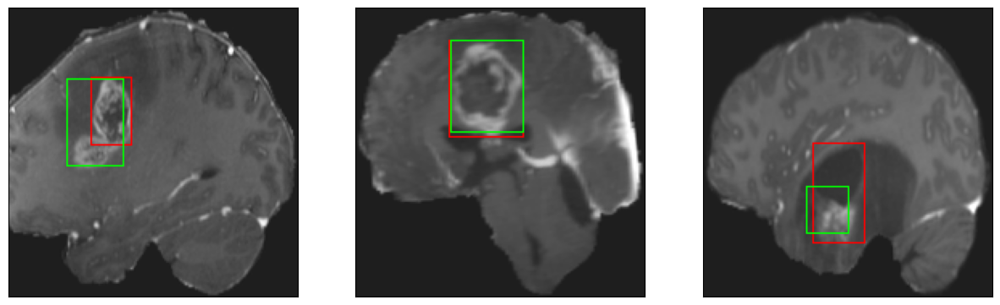

52/52 [==============================] - 7s 138ms/step - loss: 3.2822 - IoU: 0.7046 - val_loss: 5.3364 - val_IoU: 0.6271
Epoch 56/200
52/52 [==============================] - ETA: 0s - loss: 3.0681 - IoU: 0.7257
Epoch 56: val_loss improved from 4.66198 to 4.48707, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


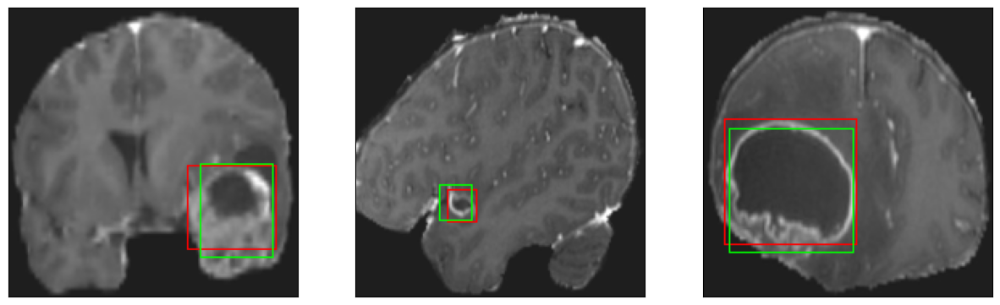

52/52 [==============================] - 10s 190ms/step - loss: 3.0681 - IoU: 0.7257 - val_loss: 4.4871 - val_IoU: 0.7062
Epoch 57/200
52/52 [==============================] - ETA: 0s - loss: 3.0767 - IoU: 0.7273
Epoch 57: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 34ms/step


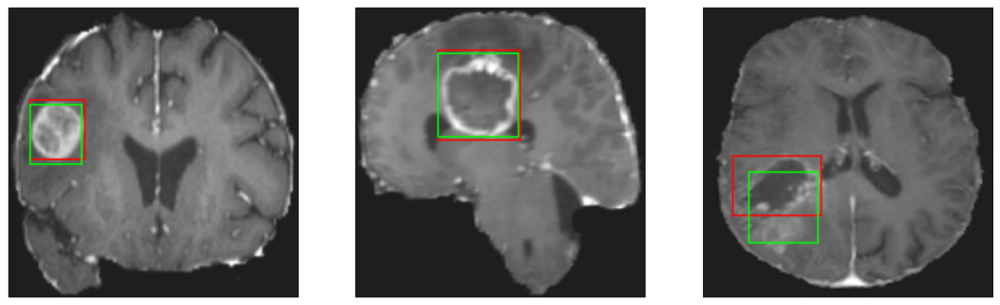

52/52 [==============================] - 7s 144ms/step - loss: 3.0767 - IoU: 0.7273 - val_loss: 4.8854 - val_IoU: 0.6838
Epoch 58/200
52/52 [==============================] - ETA: 0s - loss: 3.1182 - IoU: 0.7234
Epoch 58: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


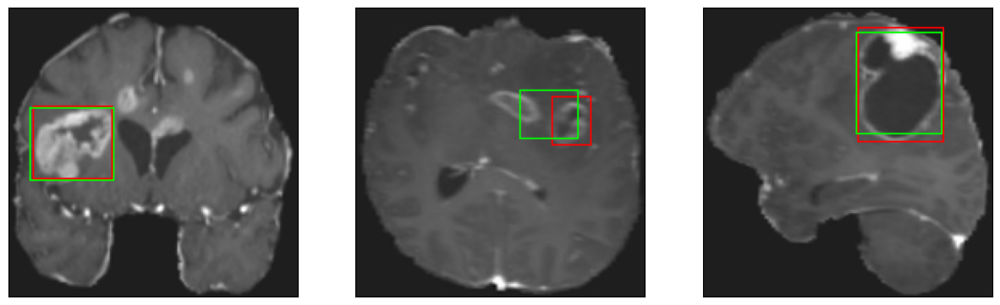

52/52 [==============================] - 7s 128ms/step - loss: 3.1182 - IoU: 0.7234 - val_loss: 4.8953 - val_IoU: 0.6616
Epoch 59/200
52/52 [==============================] - ETA: 0s - loss: 3.0482 - IoU: 0.7237
Epoch 59: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 34ms/step


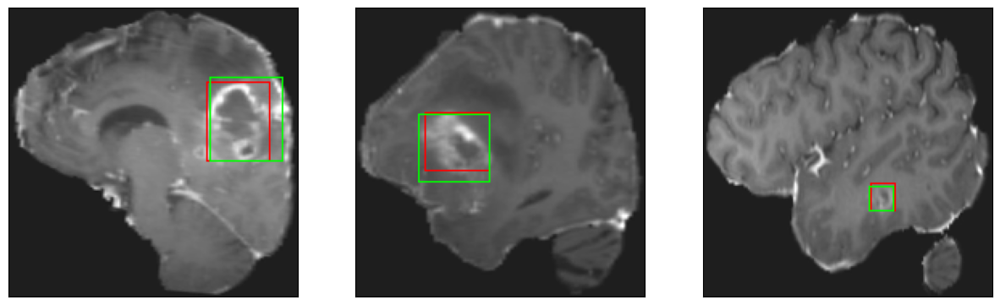

52/52 [==============================] - 7s 144ms/step - loss: 3.0482 - IoU: 0.7237 - val_loss: 4.8038 - val_IoU: 0.6712
Epoch 60/200
52/52 [==============================] - ETA: 0s - loss: 2.9611 - IoU: 0.7342
Epoch 60: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


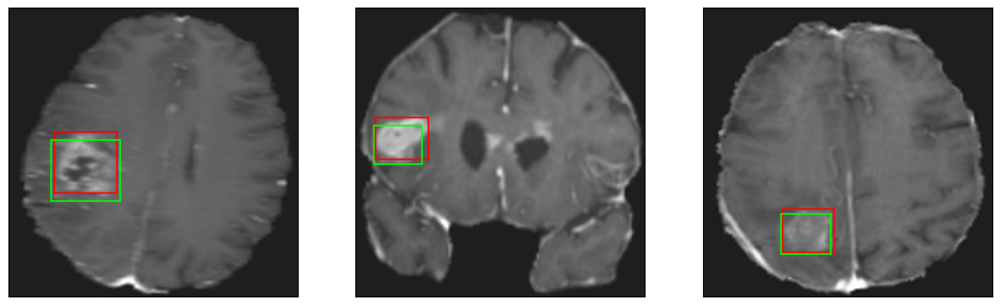

52/52 [==============================] - 7s 131ms/step - loss: 2.9611 - IoU: 0.7342 - val_loss: 4.8495 - val_IoU: 0.6668
Epoch 61/200
52/52 [==============================] - ETA: 0s - loss: 3.0714 - IoU: 0.7108
Epoch 61: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


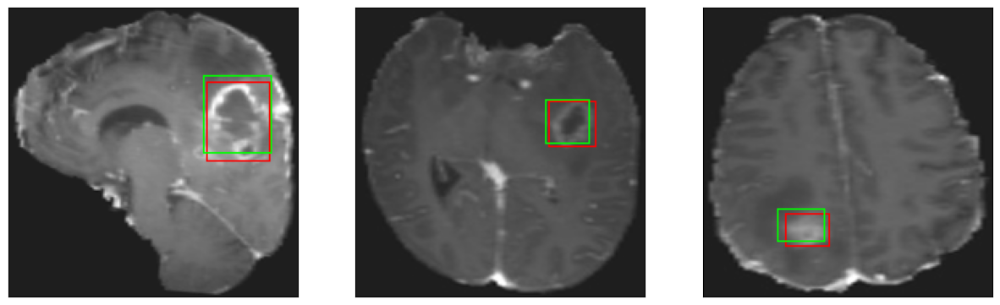

52/52 [==============================] - 7s 128ms/step - loss: 3.0714 - IoU: 0.7108 - val_loss: 4.8218 - val_IoU: 0.6640
Epoch 62/200
52/52 [==============================] - ETA: 0s - loss: 3.1144 - IoU: 0.7115
Epoch 62: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


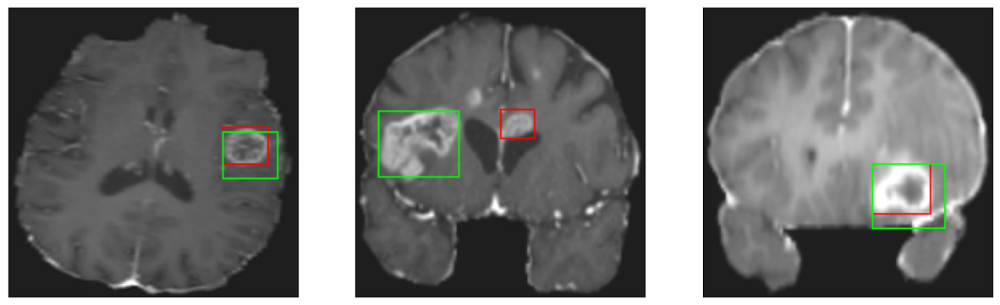

52/52 [==============================] - 7s 134ms/step - loss: 3.1144 - IoU: 0.7115 - val_loss: 5.0944 - val_IoU: 0.6528
Epoch 63/200
52/52 [==============================] - ETA: 0s - loss: 2.9690 - IoU: 0.7258
Epoch 63: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


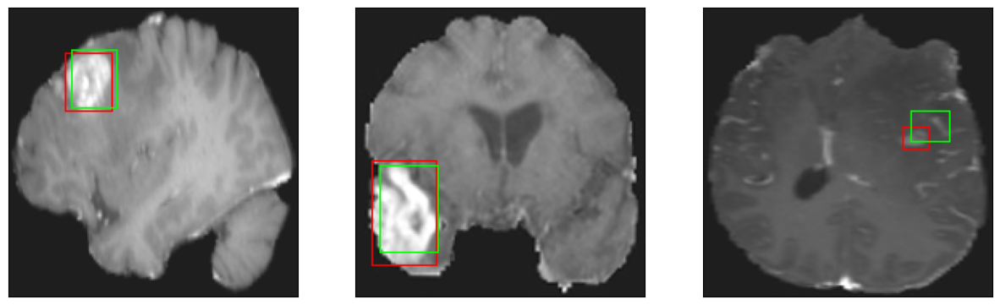

52/52 [==============================] - 7s 138ms/step - loss: 2.9690 - IoU: 0.7258 - val_loss: 5.2526 - val_IoU: 0.6214
Epoch 64/200
52/52 [==============================] - ETA: 0s - loss: 3.1150 - IoU: 0.7176
Epoch 64: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


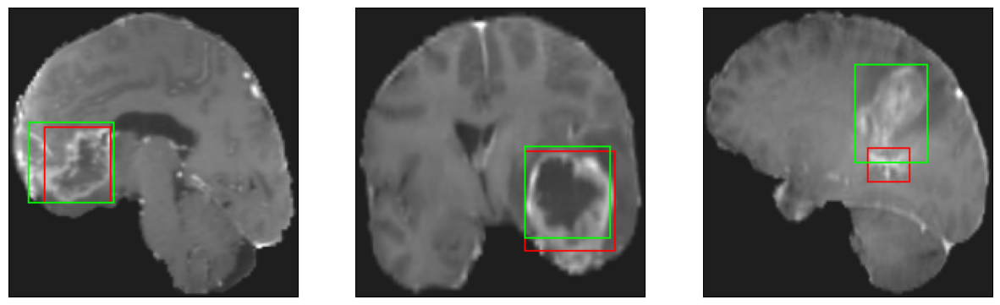

52/52 [==============================] - 7s 129ms/step - loss: 3.1150 - IoU: 0.7176 - val_loss: 5.1309 - val_IoU: 0.6561
Epoch 65/200
52/52 [==============================] - ETA: 0s - loss: 2.9810 - IoU: 0.7293
Epoch 65: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


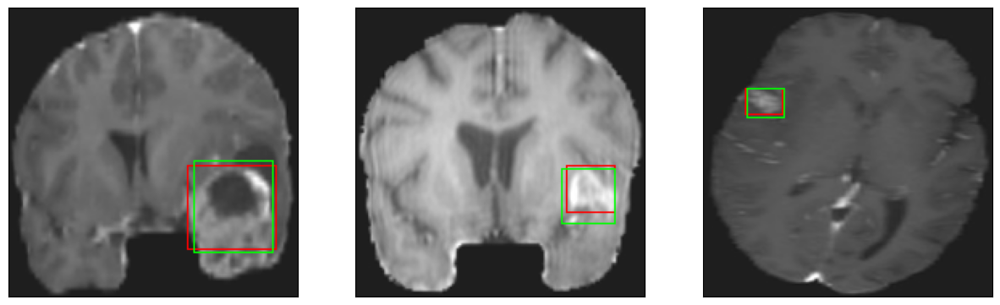

52/52 [==============================] - 6s 124ms/step - loss: 2.9810 - IoU: 0.7293 - val_loss: 4.5194 - val_IoU: 0.7027
Epoch 66/200
52/52 [==============================] - ETA: 0s - loss: 2.8632 - IoU: 0.7390
Epoch 66: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


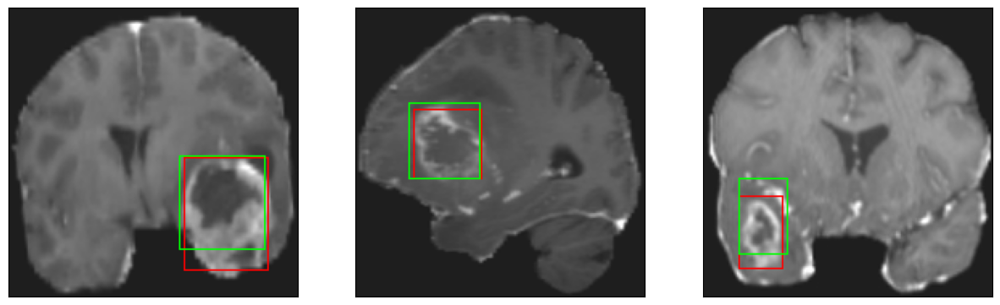

52/52 [==============================] - 8s 145ms/step - loss: 2.8632 - IoU: 0.7390 - val_loss: 4.8801 - val_IoU: 0.6435
Epoch 67/200
52/52 [==============================] - ETA: 0s - loss: 2.7837 - IoU: 0.7367
Epoch 67: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


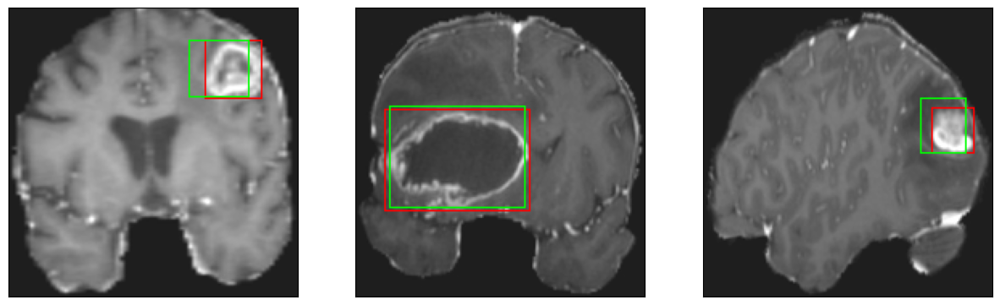

52/52 [==============================] - 7s 128ms/step - loss: 2.7837 - IoU: 0.7367 - val_loss: 4.7149 - val_IoU: 0.6703
Epoch 68/200
52/52 [==============================] - ETA: 0s - loss: 2.9202 - IoU: 0.7331
Epoch 68: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


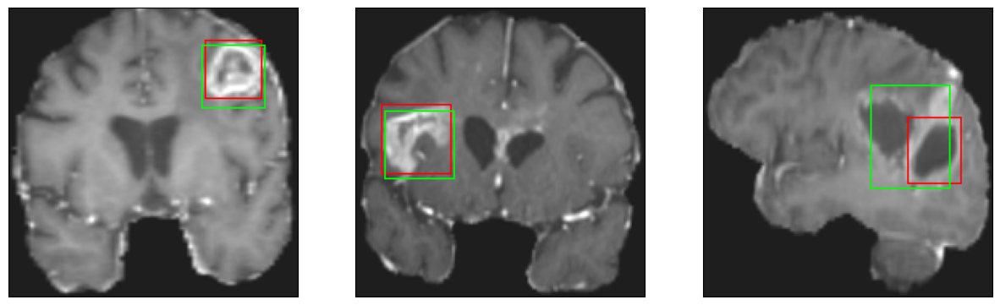

52/52 [==============================] - 7s 132ms/step - loss: 2.9202 - IoU: 0.7331 - val_loss: 4.8955 - val_IoU: 0.6503
Epoch 69/200
52/52 [==============================] - ETA: 0s - loss: 3.0569 - IoU: 0.7298
Epoch 69: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


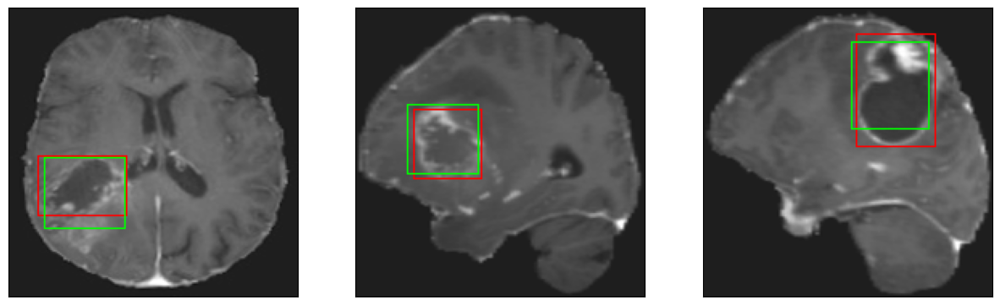

52/52 [==============================] - 7s 144ms/step - loss: 3.0569 - IoU: 0.7298 - val_loss: 5.4163 - val_IoU: 0.6134
Epoch 70/200
52/52 [==============================] - ETA: 0s - loss: 2.8187 - IoU: 0.7442
Epoch 70: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


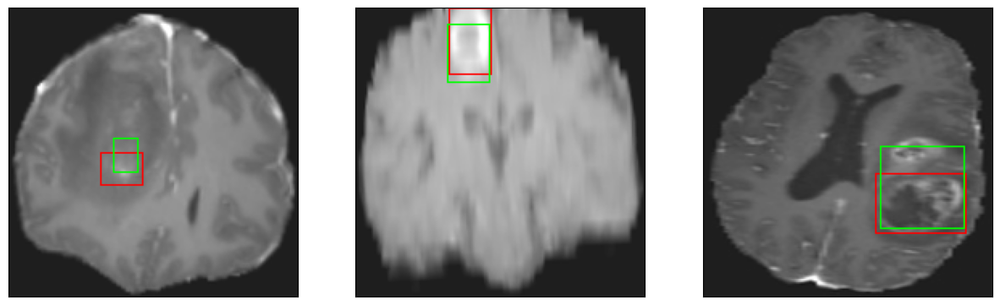

52/52 [==============================] - 7s 127ms/step - loss: 2.8187 - IoU: 0.7442 - val_loss: 4.7633 - val_IoU: 0.6855
Epoch 71/200
52/52 [==============================] - ETA: 0s - loss: 2.8137 - IoU: 0.7389
Epoch 71: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


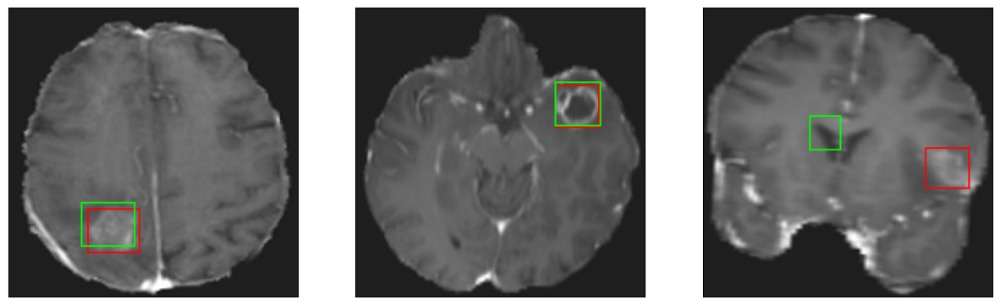

52/52 [==============================] - 8s 144ms/step - loss: 2.8137 - IoU: 0.7389 - val_loss: 4.8123 - val_IoU: 0.6870
Epoch 72/200
52/52 [==============================] - ETA: 0s - loss: 2.7840 - IoU: 0.7416
Epoch 72: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


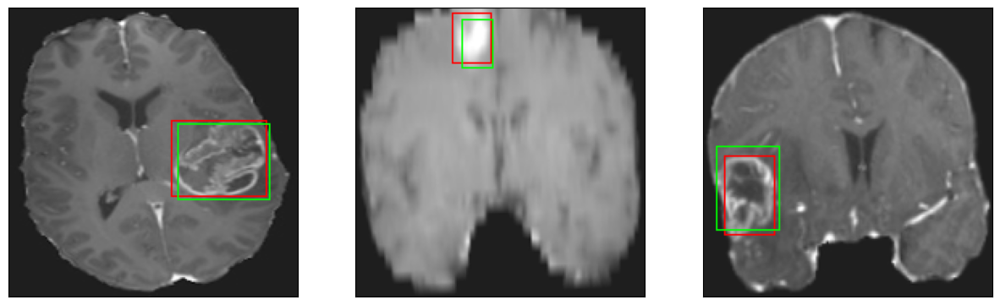

52/52 [==============================] - 7s 139ms/step - loss: 2.7840 - IoU: 0.7416 - val_loss: 4.8079 - val_IoU: 0.6624
Epoch 73/200
52/52 [==============================] - ETA: 0s - loss: 2.6459 - IoU: 0.7542
Epoch 73: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


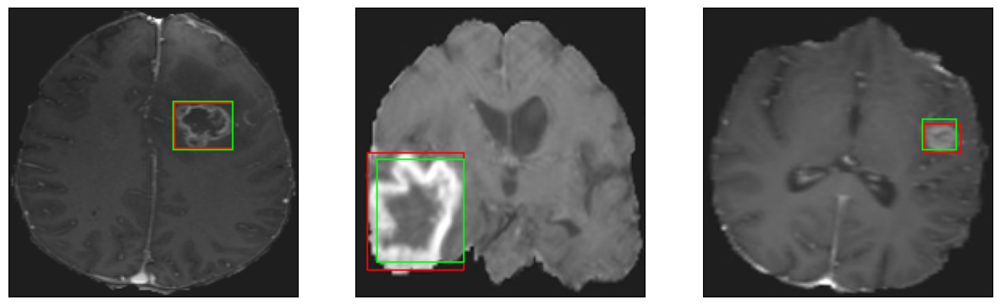

52/52 [==============================] - 7s 136ms/step - loss: 2.6459 - IoU: 0.7542 - val_loss: 5.0147 - val_IoU: 0.6424
Epoch 74/200
52/52 [==============================] - ETA: 0s - loss: 2.6818 - IoU: 0.7483
Epoch 74: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


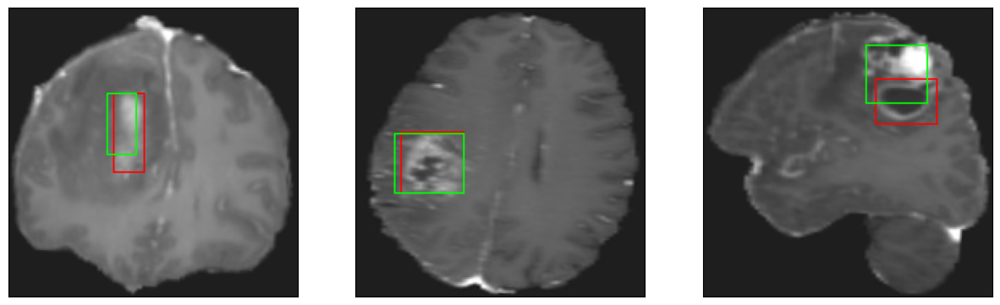

52/52 [==============================] - 7s 128ms/step - loss: 2.6818 - IoU: 0.7483 - val_loss: 5.3479 - val_IoU: 0.6101
Epoch 75/200
52/52 [==============================] - ETA: 0s - loss: 2.6144 - IoU: 0.7600
Epoch 75: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


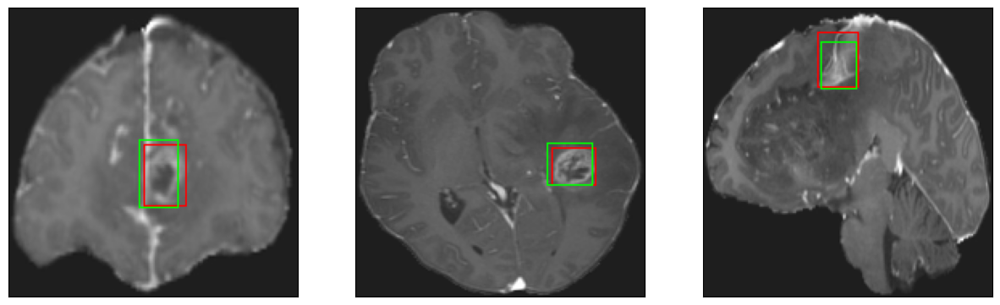

52/52 [==============================] - 7s 131ms/step - loss: 2.6144 - IoU: 0.7600 - val_loss: 4.5292 - val_IoU: 0.6879
Epoch 76/200
52/52 [==============================] - ETA: 0s - loss: 2.6159 - IoU: 0.7546
Epoch 76: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


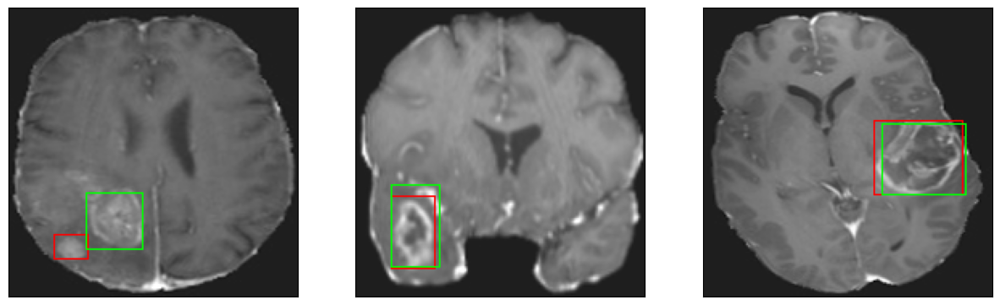

52/52 [==============================] - 7s 135ms/step - loss: 2.6159 - IoU: 0.7546 - val_loss: 4.6572 - val_IoU: 0.6867
Epoch 77/200
52/52 [==============================] - ETA: 0s - loss: 2.5710 - IoU: 0.7621
Epoch 77: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


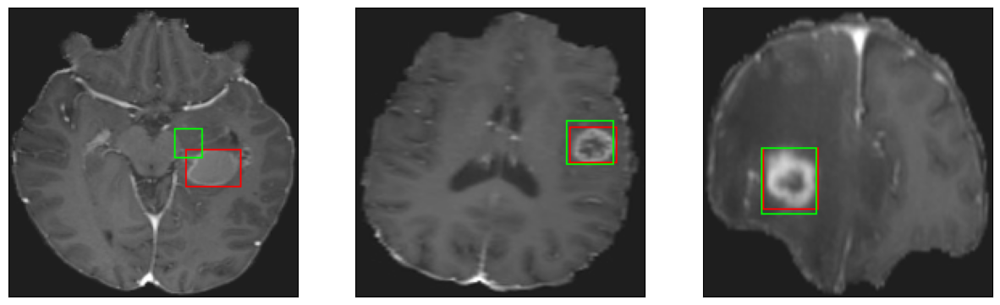

52/52 [==============================] - 7s 134ms/step - loss: 2.5710 - IoU: 0.7621 - val_loss: 4.6752 - val_IoU: 0.6664
Epoch 78/200
52/52 [==============================] - ETA: 0s - loss: 2.6332 - IoU: 0.7508
Epoch 78: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


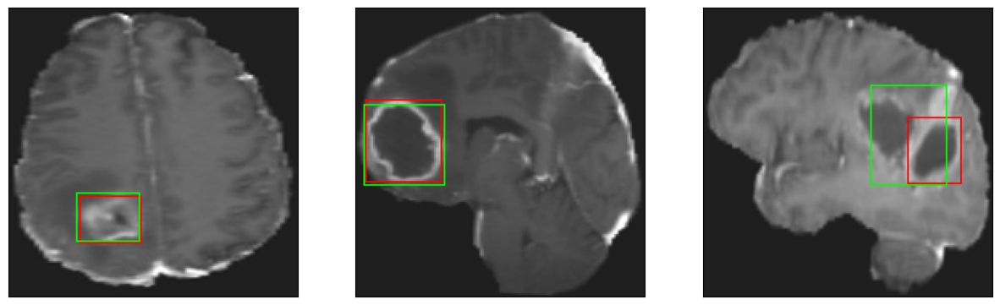

52/52 [==============================] - 7s 130ms/step - loss: 2.6332 - IoU: 0.7508 - val_loss: 4.6647 - val_IoU: 0.6987
Epoch 79/200
52/52 [==============================] - ETA: 0s - loss: 2.6120 - IoU: 0.7601
Epoch 79: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


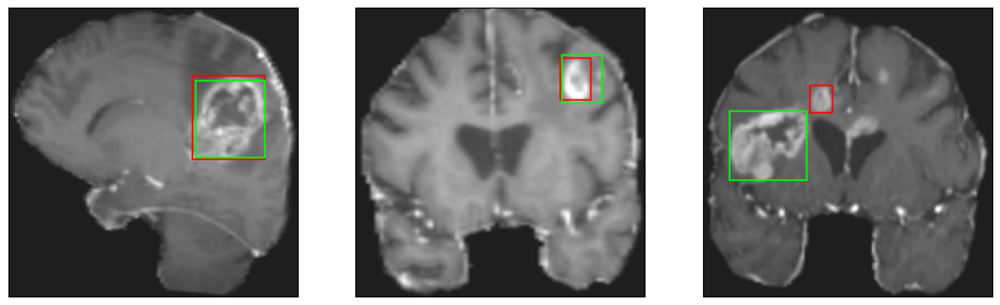

52/52 [==============================] - 7s 142ms/step - loss: 2.6120 - IoU: 0.7601 - val_loss: 4.5607 - val_IoU: 0.7048
Epoch 80/200
52/52 [==============================] - ETA: 0s - loss: 2.5975 - IoU: 0.7547
Epoch 80: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


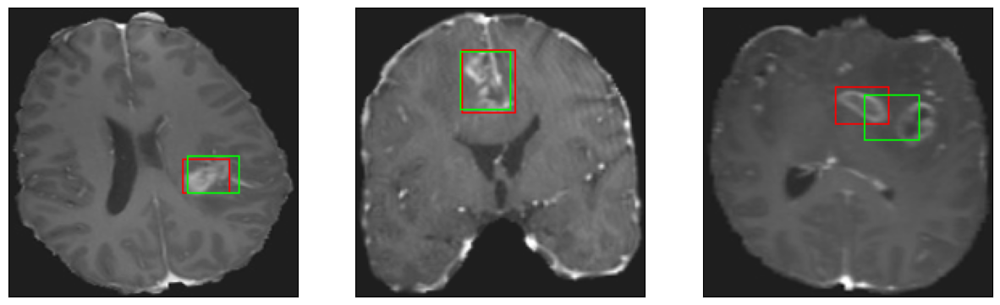

52/52 [==============================] - 7s 135ms/step - loss: 2.5975 - IoU: 0.7547 - val_loss: 4.8007 - val_IoU: 0.6825
Epoch 81/200
52/52 [==============================] - ETA: 0s - loss: 2.5407 - IoU: 0.7634
Epoch 81: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


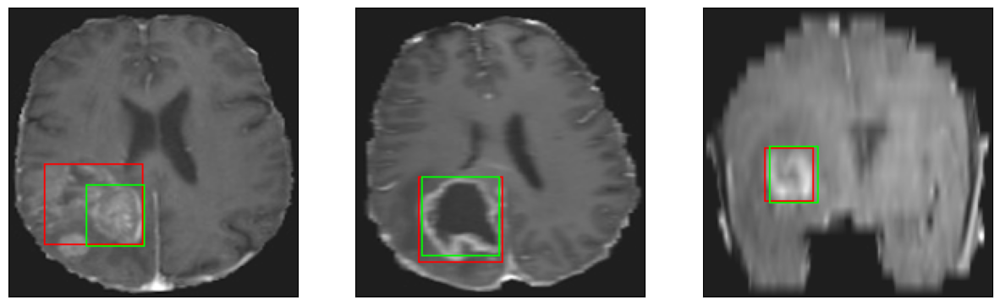

52/52 [==============================] - 7s 139ms/step - loss: 2.5407 - IoU: 0.7634 - val_loss: 4.6617 - val_IoU: 0.6906
Epoch 82/200
52/52 [==============================] - ETA: 0s - loss: 2.6152 - IoU: 0.7539
Epoch 82: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


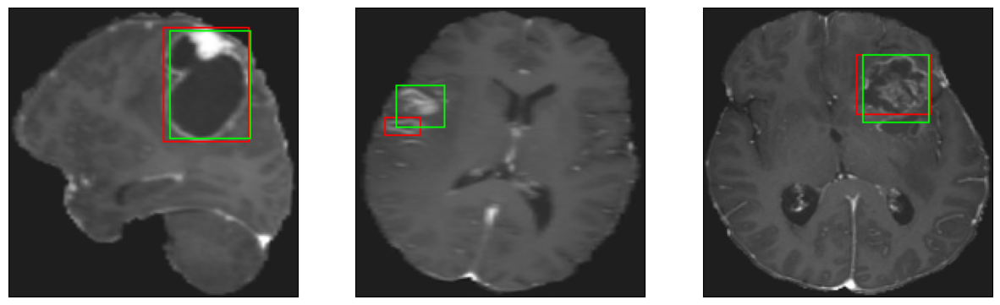

52/52 [==============================] - 7s 125ms/step - loss: 2.6152 - IoU: 0.7539 - val_loss: 4.4910 - val_IoU: 0.7023
Epoch 83/200
52/52 [==============================] - ETA: 0s - loss: 2.6407 - IoU: 0.7513
Epoch 83: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


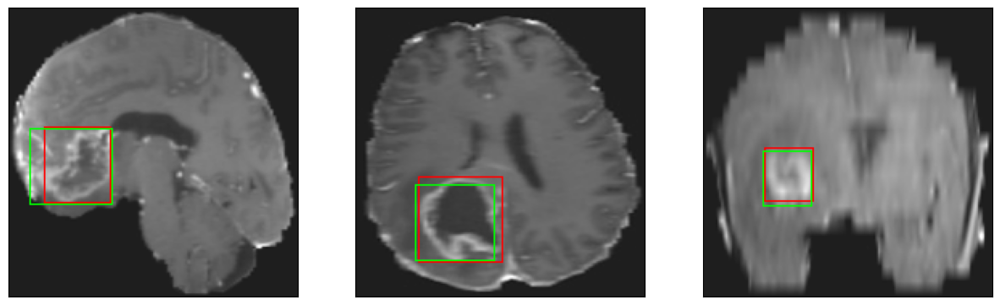

52/52 [==============================] - 8s 148ms/step - loss: 2.6407 - IoU: 0.7513 - val_loss: 5.2844 - val_IoU: 0.6336
Epoch 84/200
52/52 [==============================] - ETA: 0s - loss: 2.6933 - IoU: 0.7494
Epoch 84: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


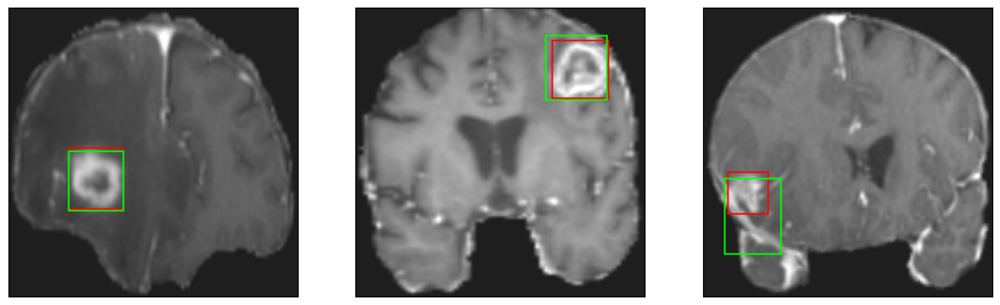

52/52 [==============================] - 7s 134ms/step - loss: 2.6933 - IoU: 0.7494 - val_loss: 4.6103 - val_IoU: 0.6981
Epoch 85/200
52/52 [==============================] - ETA: 0s - loss: 2.5490 - IoU: 0.7606
Epoch 85: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


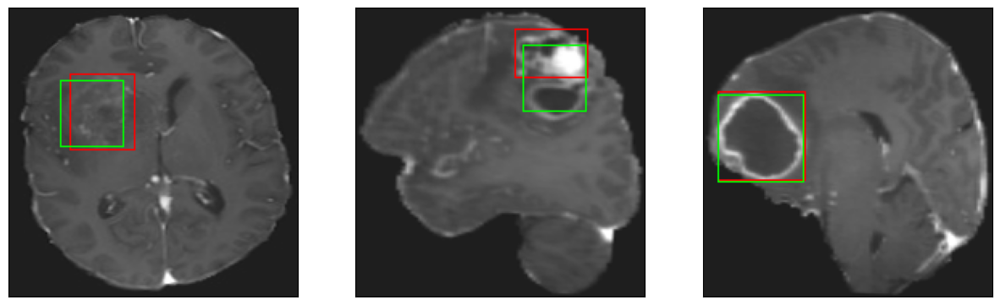

52/52 [==============================] - 8s 146ms/step - loss: 2.5490 - IoU: 0.7606 - val_loss: 4.6625 - val_IoU: 0.6918
Epoch 86/200
52/52 [==============================] - ETA: 0s - loss: 2.5162 - IoU: 0.7596
Epoch 86: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


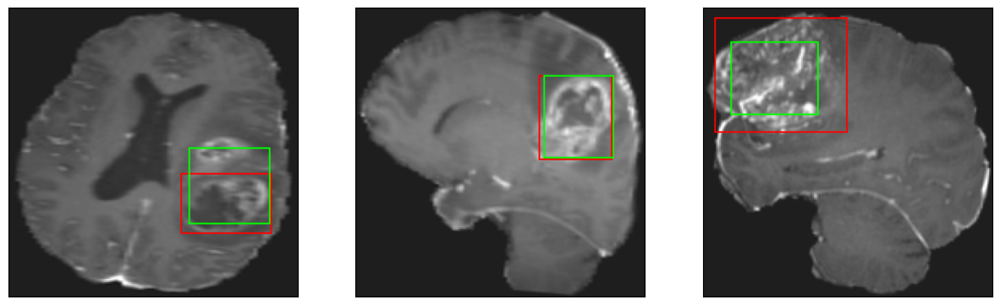

52/52 [==============================] - 7s 140ms/step - loss: 2.5162 - IoU: 0.7596 - val_loss: 4.5805 - val_IoU: 0.7055
Epoch 87/200
52/52 [==============================] - ETA: 0s - loss: 2.4029 - IoU: 0.7787
Epoch 87: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


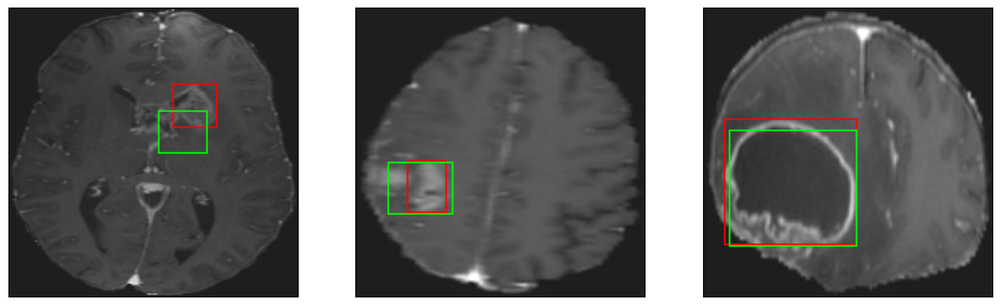

52/52 [==============================] - 7s 132ms/step - loss: 2.4029 - IoU: 0.7787 - val_loss: 4.7807 - val_IoU: 0.6956
Epoch 88/200
52/52 [==============================] - ETA: 0s - loss: 2.4836 - IoU: 0.7706
Epoch 88: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


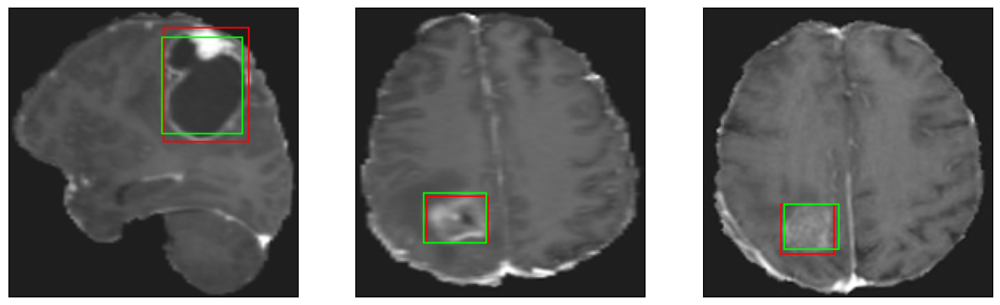

52/52 [==============================] - 7s 135ms/step - loss: 2.4836 - IoU: 0.7706 - val_loss: 4.6052 - val_IoU: 0.7054
Epoch 89/200
52/52 [==============================] - ETA: 0s - loss: 2.3601 - IoU: 0.7832
Epoch 89: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


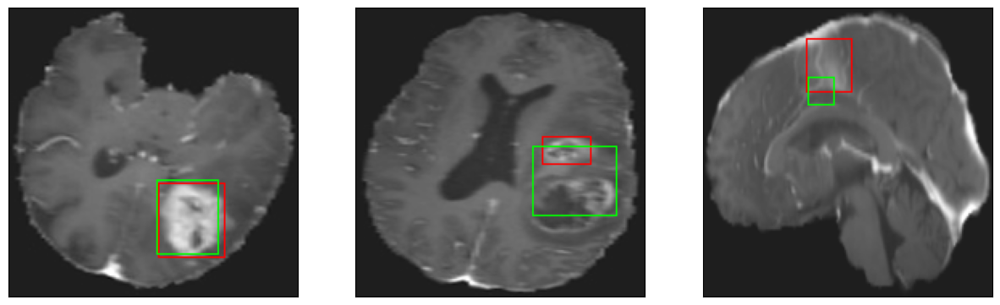

52/52 [==============================] - 7s 139ms/step - loss: 2.3601 - IoU: 0.7832 - val_loss: 4.8123 - val_IoU: 0.6764
Epoch 90/200
52/52 [==============================] - ETA: 0s - loss: 2.5042 - IoU: 0.7644
Epoch 90: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


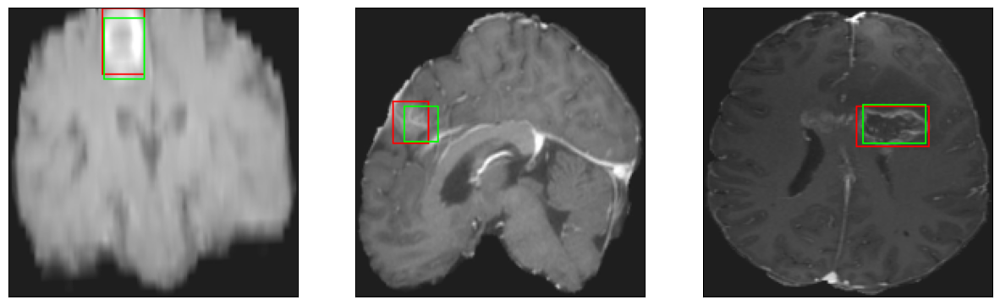

52/52 [==============================] - 7s 129ms/step - loss: 2.5042 - IoU: 0.7644 - val_loss: 4.6081 - val_IoU: 0.6961
Epoch 91/200
52/52 [==============================] - ETA: 0s - loss: 2.4157 - IoU: 0.7716
Epoch 91: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


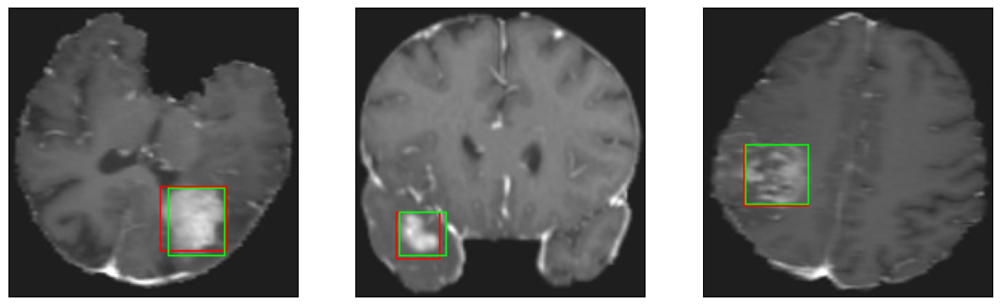

52/52 [==============================] - 7s 135ms/step - loss: 2.4157 - IoU: 0.7716 - val_loss: 4.8981 - val_IoU: 0.6670
Epoch 92/200
52/52 [==============================] - ETA: 0s - loss: 2.4292 - IoU: 0.7619
Epoch 92: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


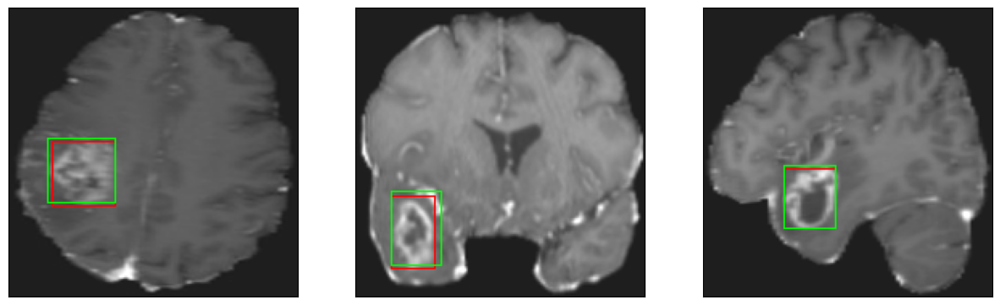

52/52 [==============================] - 7s 140ms/step - loss: 2.4292 - IoU: 0.7619 - val_loss: 4.6011 - val_IoU: 0.6888
Epoch 93/200
52/52 [==============================] - ETA: 0s - loss: 2.5369 - IoU: 0.7671
Epoch 93: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


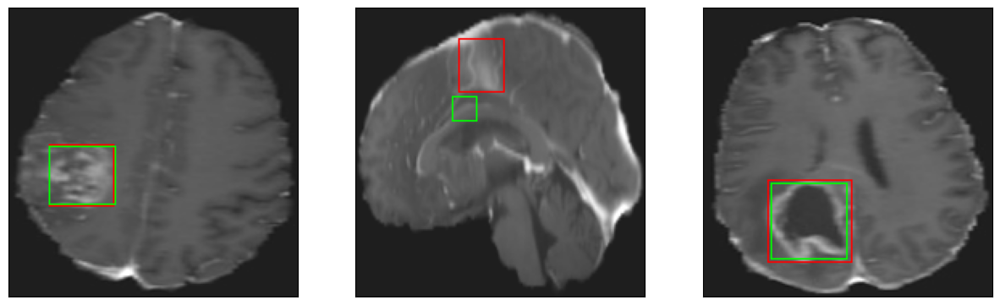

52/52 [==============================] - 7s 128ms/step - loss: 2.5369 - IoU: 0.7671 - val_loss: 5.2422 - val_IoU: 0.6583
Epoch 94/200
52/52 [==============================] - ETA: 0s - loss: 2.4769 - IoU: 0.7705
Epoch 94: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


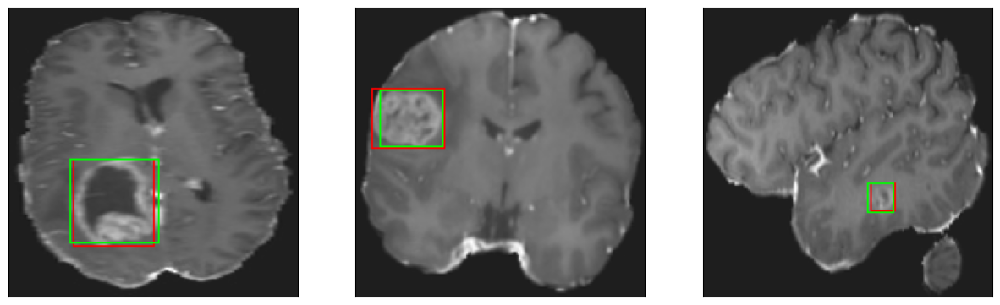

52/52 [==============================] - 8s 152ms/step - loss: 2.4769 - IoU: 0.7705 - val_loss: 4.5591 - val_IoU: 0.7096
Epoch 95/200
52/52 [==============================] - ETA: 0s - loss: 2.4896 - IoU: 0.7654
Epoch 95: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


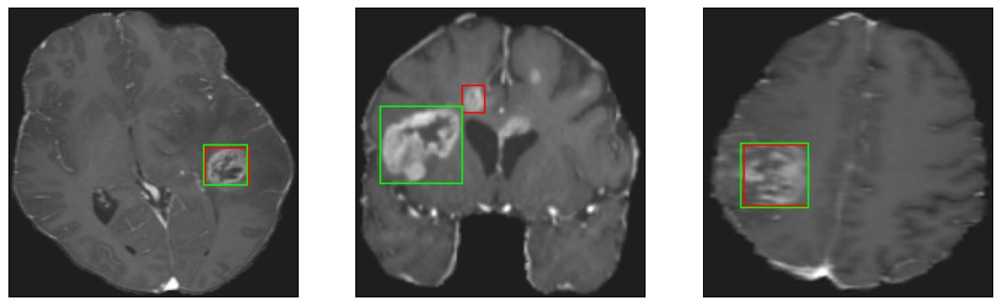

52/52 [==============================] - 7s 131ms/step - loss: 2.4896 - IoU: 0.7654 - val_loss: 4.6699 - val_IoU: 0.7114
Epoch 96/200
52/52 [==============================] - ETA: 0s - loss: 2.3730 - IoU: 0.7793
Epoch 96: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


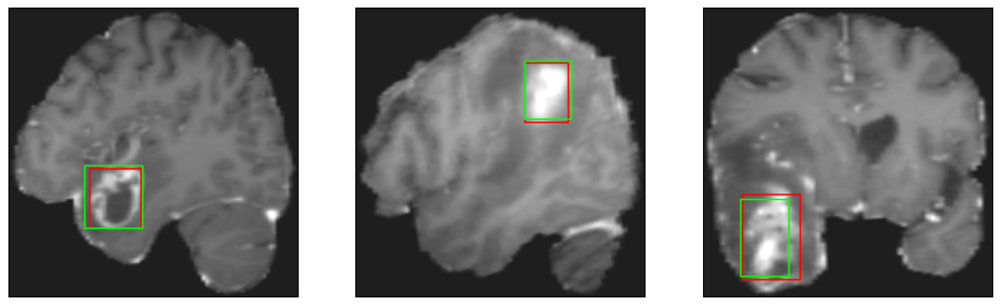

52/52 [==============================] - 7s 129ms/step - loss: 2.3730 - IoU: 0.7793 - val_loss: 4.6675 - val_IoU: 0.7067
Epoch 97/200
52/52 [==============================] - ETA: 0s - loss: 2.4040 - IoU: 0.7749
Epoch 97: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


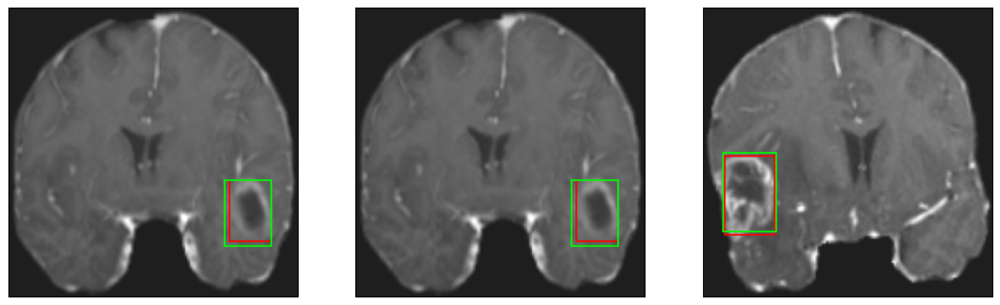

52/52 [==============================] - 7s 135ms/step - loss: 2.4040 - IoU: 0.7749 - val_loss: 4.6576 - val_IoU: 0.6957
Epoch 98/200
52/52 [==============================] - ETA: 0s - loss: 2.3452 - IoU: 0.7804
Epoch 98: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


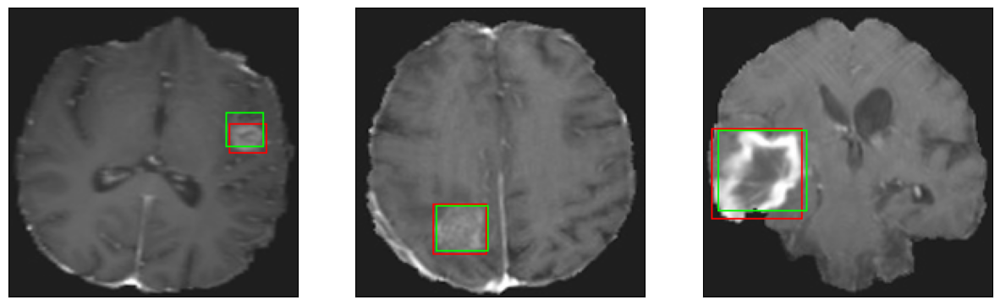

52/52 [==============================] - 7s 129ms/step - loss: 2.3452 - IoU: 0.7804 - val_loss: 4.8230 - val_IoU: 0.6958
Epoch 99/200
52/52 [==============================] - ETA: 0s - loss: 2.3543 - IoU: 0.7777
Epoch 99: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


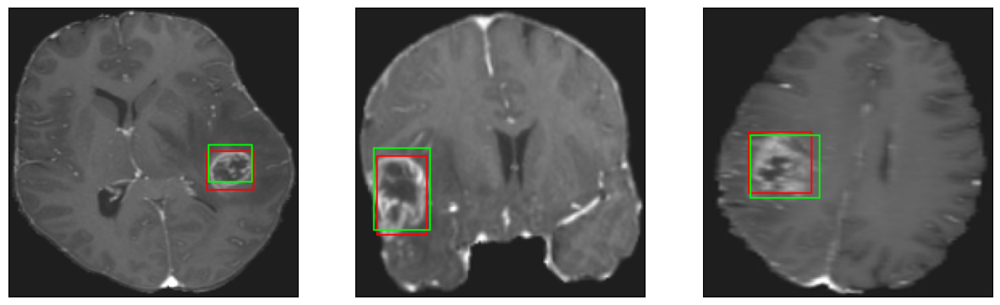

52/52 [==============================] - 7s 136ms/step - loss: 2.3543 - IoU: 0.7777 - val_loss: 4.6601 - val_IoU: 0.7052
Epoch 100/200
52/52 [==============================] - ETA: 0s - loss: 2.3679 - IoU: 0.7812
Epoch 100: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


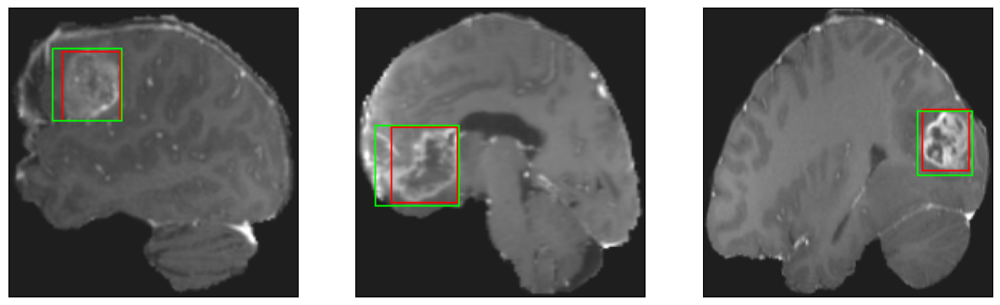

52/52 [==============================] - 7s 125ms/step - loss: 2.3679 - IoU: 0.7812 - val_loss: 4.8020 - val_IoU: 0.7041
Epoch 101/200
52/52 [==============================] - ETA: 0s - loss: 2.2642 - IoU: 0.7940
Epoch 101: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


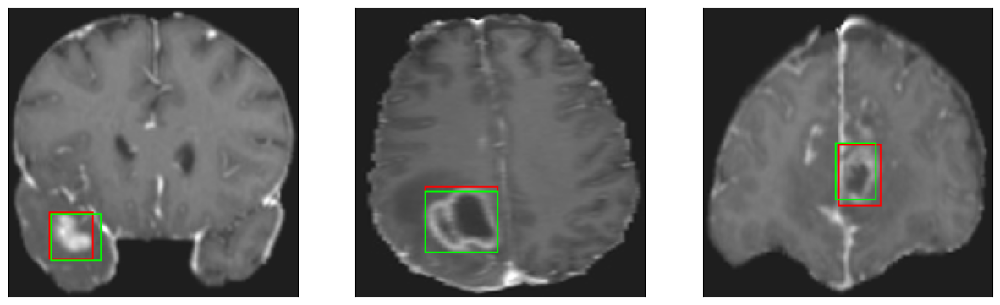

52/52 [==============================] - 7s 142ms/step - loss: 2.2642 - IoU: 0.7940 - val_loss: 4.8075 - val_IoU: 0.7052
Epoch 102/200
52/52 [==============================] - ETA: 0s - loss: 2.2881 - IoU: 0.7842
Epoch 102: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


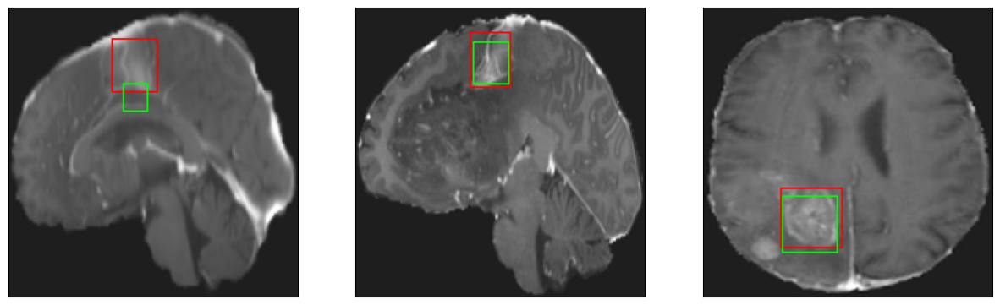

52/52 [==============================] - 7s 132ms/step - loss: 2.2881 - IoU: 0.7842 - val_loss: 4.7453 - val_IoU: 0.7070
Epoch 103/200
52/52 [==============================] - ETA: 0s - loss: 2.4124 - IoU: 0.7806
Epoch 103: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


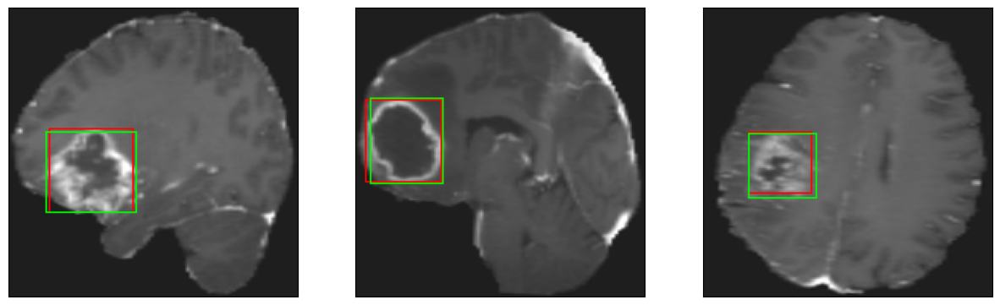

52/52 [==============================] - 7s 144ms/step - loss: 2.4124 - IoU: 0.7806 - val_loss: 4.7316 - val_IoU: 0.7009
Epoch 104/200
52/52 [==============================] - ETA: 0s - loss: 2.4663 - IoU: 0.7749
Epoch 104: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


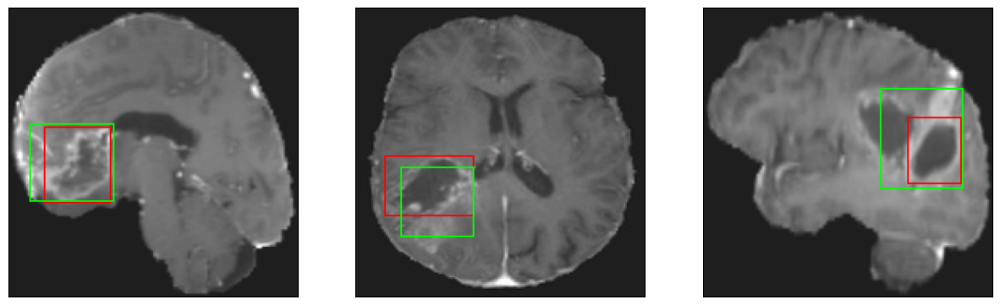

52/52 [==============================] - 7s 138ms/step - loss: 2.4663 - IoU: 0.7749 - val_loss: 4.8678 - val_IoU: 0.6952
Epoch 105/200
52/52 [==============================] - ETA: 0s - loss: 2.3538 - IoU: 0.7856
Epoch 105: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


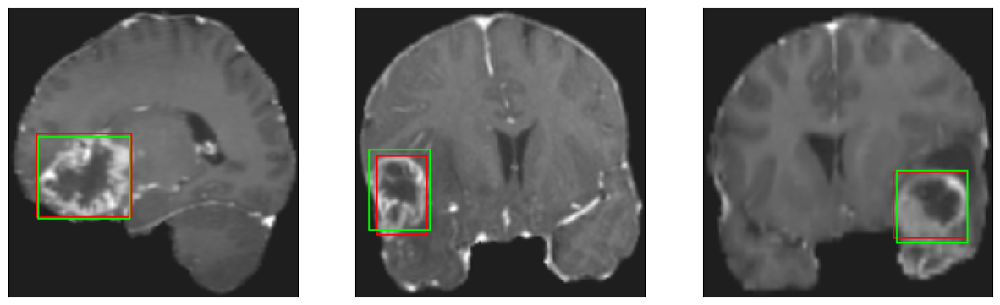

52/52 [==============================] - 7s 133ms/step - loss: 2.3538 - IoU: 0.7856 - val_loss: 4.7511 - val_IoU: 0.6977
Epoch 106/200
52/52 [==============================] - ETA: 0s - loss: 2.3002 - IoU: 0.7804
Epoch 106: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


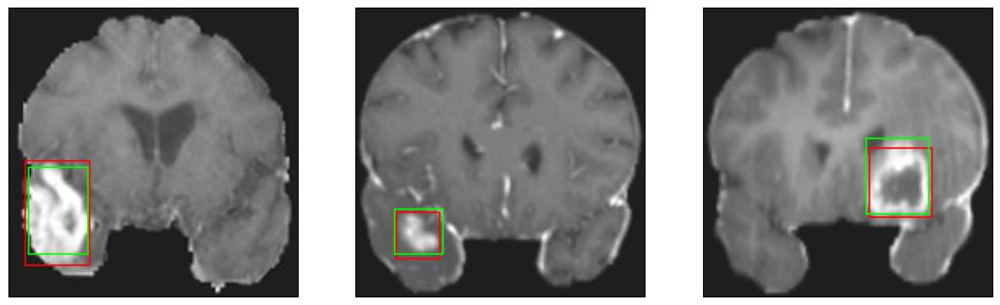

52/52 [==============================] - 8s 149ms/step - loss: 2.3002 - IoU: 0.7804 - val_loss: 4.9263 - val_IoU: 0.6442
Epoch 107/200
52/52 [==============================] - ETA: 0s - loss: 2.3739 - IoU: 0.7741
Epoch 107: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


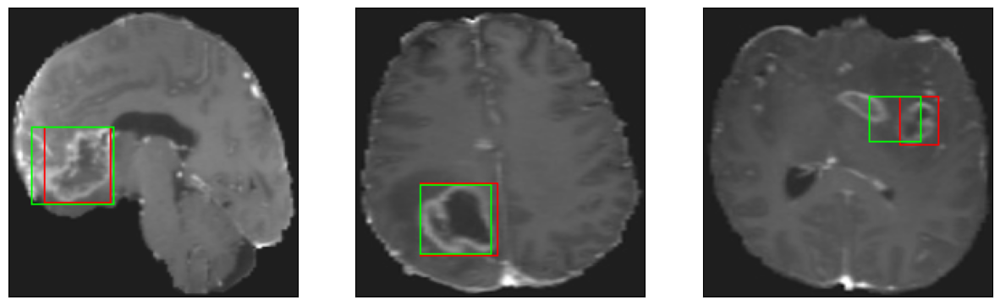

52/52 [==============================] - 6s 124ms/step - loss: 2.3739 - IoU: 0.7741 - val_loss: 4.6836 - val_IoU: 0.7040
Epoch 108/200
52/52 [==============================] - ETA: 0s - loss: 2.2408 - IoU: 0.7917
Epoch 108: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


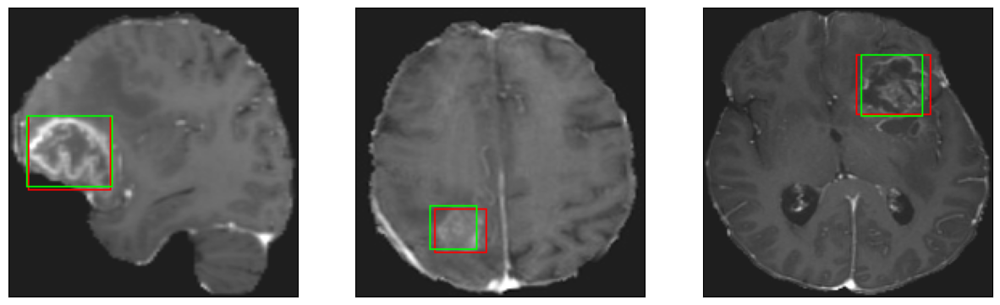

52/52 [==============================] - 7s 130ms/step - loss: 2.2408 - IoU: 0.7917 - val_loss: 4.9051 - val_IoU: 0.6749
Epoch 109/200
52/52 [==============================] - ETA: 0s - loss: 2.2623 - IoU: 0.7927
Epoch 109: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


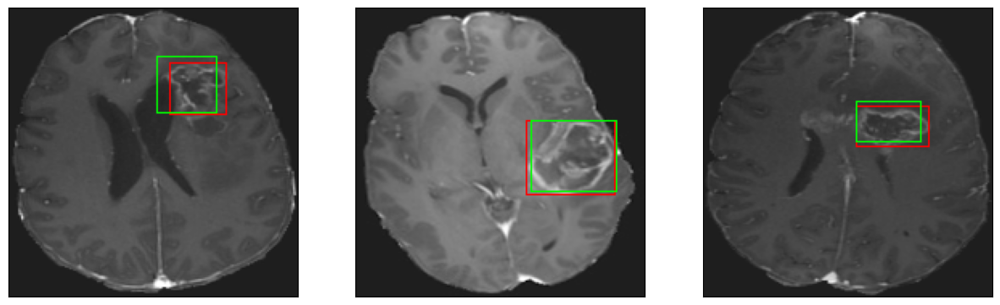

52/52 [==============================] - 7s 129ms/step - loss: 2.2623 - IoU: 0.7927 - val_loss: 4.7116 - val_IoU: 0.7070
Epoch 110/200
52/52 [==============================] - ETA: 0s - loss: 2.2722 - IoU: 0.7899
Epoch 110: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


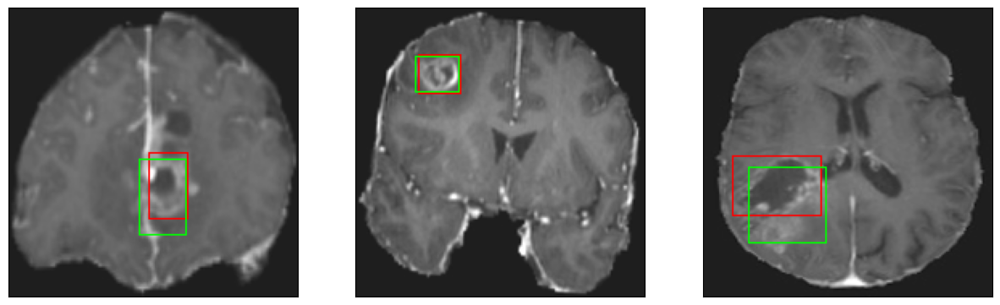

52/52 [==============================] - 7s 140ms/step - loss: 2.2722 - IoU: 0.7899 - val_loss: 4.8481 - val_IoU: 0.6935
Epoch 111/200
52/52 [==============================] - ETA: 0s - loss: 2.4532 - IoU: 0.7672
Epoch 111: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


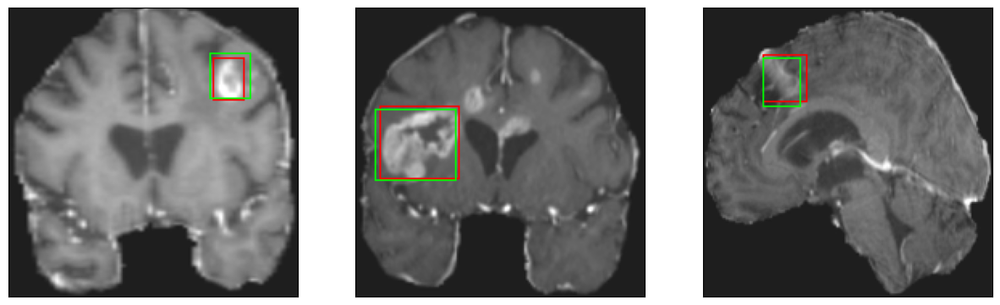

52/52 [==============================] - 7s 129ms/step - loss: 2.4532 - IoU: 0.7672 - val_loss: 4.9359 - val_IoU: 0.6817
Epoch 112/200
52/52 [==============================] - ETA: 0s - loss: 2.3719 - IoU: 0.7752
Epoch 112: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


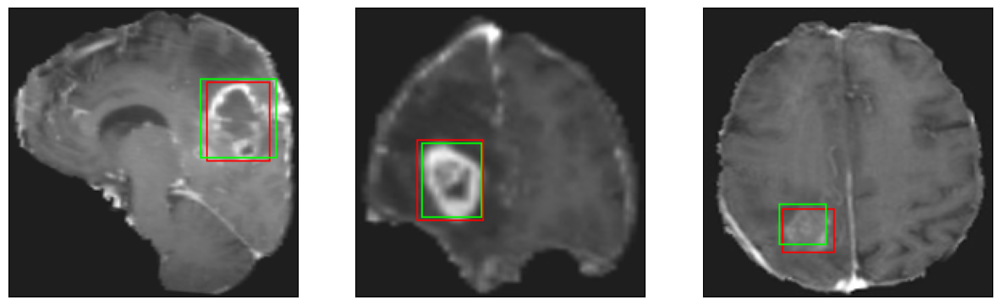

52/52 [==============================] - 7s 136ms/step - loss: 2.3719 - IoU: 0.7752 - val_loss: 4.8540 - val_IoU: 0.6917
Epoch 113/200
52/52 [==============================] - ETA: 0s - loss: 2.2901 - IoU: 0.7879
Epoch 113: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


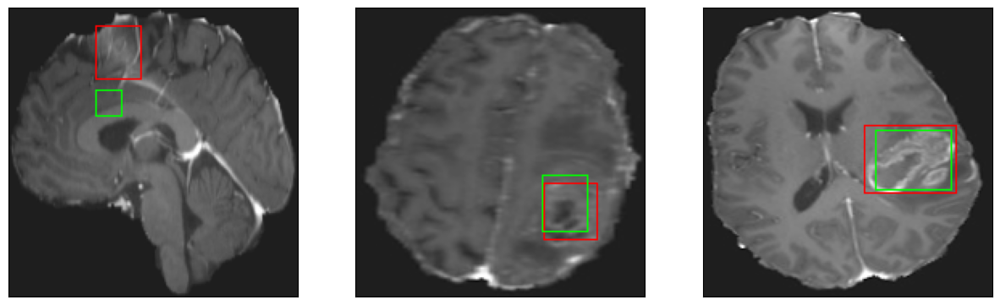

52/52 [==============================] - 7s 128ms/step - loss: 2.2901 - IoU: 0.7879 - val_loss: 4.9663 - val_IoU: 0.7038
Epoch 114/200
52/52 [==============================] - ETA: 0s - loss: 2.2728 - IoU: 0.7883
Epoch 114: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


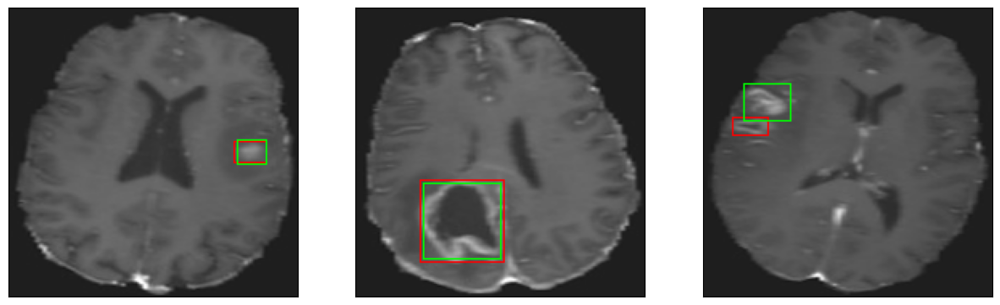

52/52 [==============================] - 7s 138ms/step - loss: 2.2728 - IoU: 0.7883 - val_loss: 4.8898 - val_IoU: 0.6975
Epoch 115/200
52/52 [==============================] - ETA: 0s - loss: 2.2996 - IoU: 0.7873
Epoch 115: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


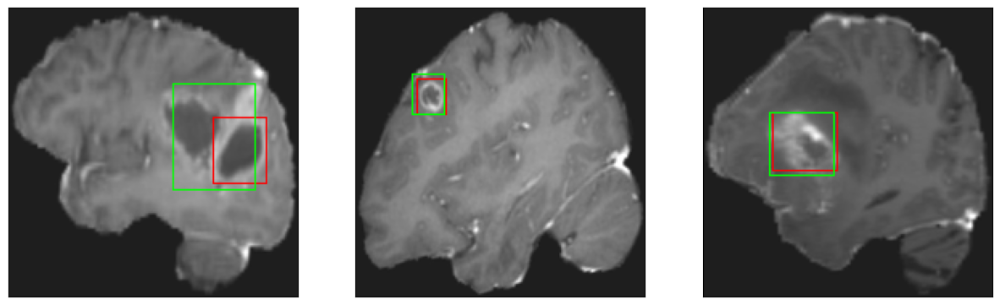

52/52 [==============================] - 7s 139ms/step - loss: 2.2996 - IoU: 0.7873 - val_loss: 4.8182 - val_IoU: 0.6826
Epoch 116/200
52/52 [==============================] - ETA: 0s - loss: 2.4058 - IoU: 0.7727
Epoch 116: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


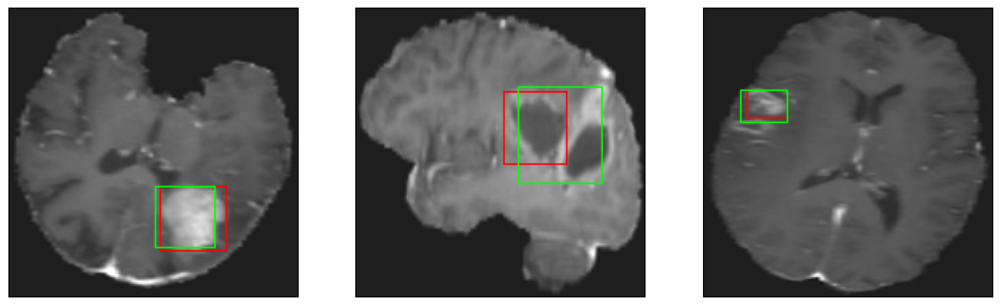

52/52 [==============================] - 7s 135ms/step - loss: 2.4058 - IoU: 0.7727 - val_loss: 5.5078 - val_IoU: 0.6391
Epoch 117/200
52/52 [==============================] - ETA: 0s - loss: 2.4232 - IoU: 0.7797
Epoch 117: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


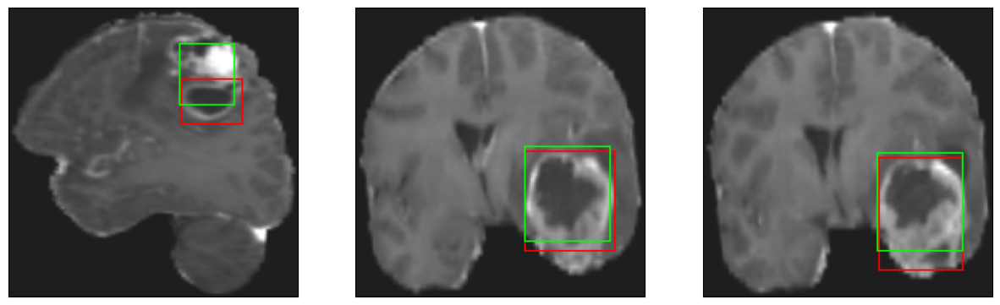

52/52 [==============================] - 7s 129ms/step - loss: 2.4232 - IoU: 0.7797 - val_loss: 4.7958 - val_IoU: 0.6970
Epoch 118/200
52/52 [==============================] - ETA: 0s - loss: 2.2357 - IoU: 0.7937
Epoch 118: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


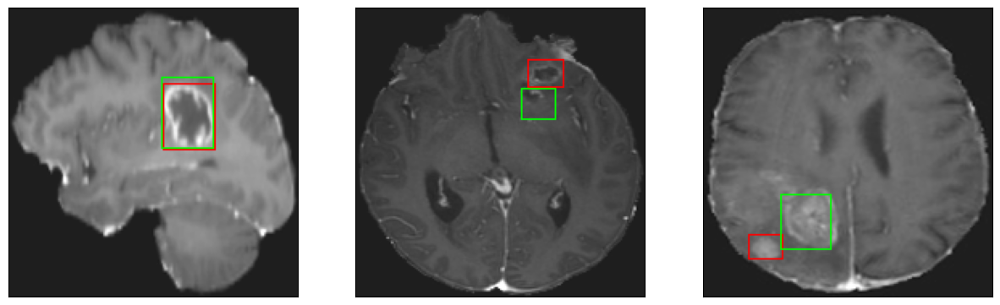

52/52 [==============================] - 8s 147ms/step - loss: 2.2357 - IoU: 0.7937 - val_loss: 4.9046 - val_IoU: 0.6866
Epoch 119/200
52/52 [==============================] - ETA: 0s - loss: 2.2691 - IoU: 0.7885
Epoch 119: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


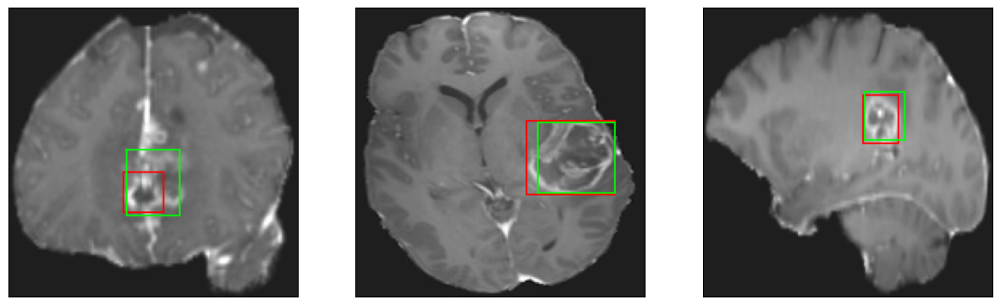

52/52 [==============================] - 7s 129ms/step - loss: 2.2691 - IoU: 0.7885 - val_loss: 4.7653 - val_IoU: 0.6813
Epoch 120/200
52/52 [==============================] - ETA: 0s - loss: 2.2901 - IoU: 0.7868
Epoch 120: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


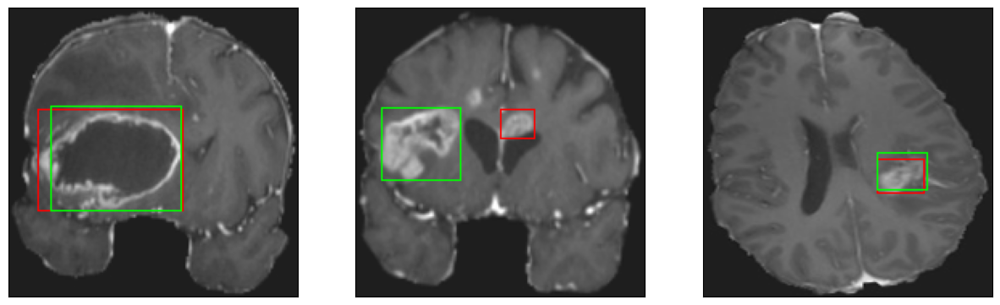

52/52 [==============================] - 7s 136ms/step - loss: 2.2901 - IoU: 0.7868 - val_loss: 4.7931 - val_IoU: 0.6839
Epoch 121/200
52/52 [==============================] - ETA: 0s - loss: 2.3070 - IoU: 0.7885
Epoch 121: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


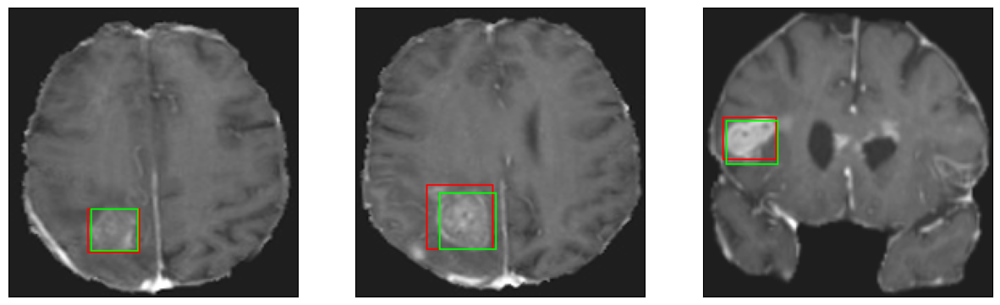

52/52 [==============================] - 7s 141ms/step - loss: 2.3070 - IoU: 0.7885 - val_loss: 5.0395 - val_IoU: 0.6865
Epoch 122/200
52/52 [==============================] - ETA: 0s - loss: 2.2314 - IoU: 0.7950
Epoch 122: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


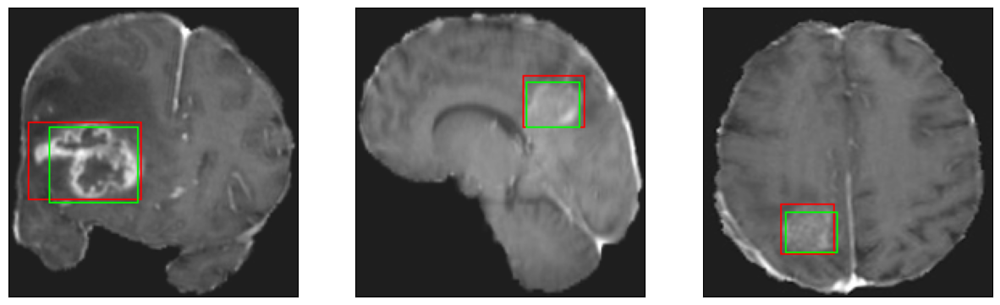

52/52 [==============================] - 7s 131ms/step - loss: 2.2314 - IoU: 0.7950 - val_loss: 4.7823 - val_IoU: 0.7032
Epoch 123/200
52/52 [==============================] - ETA: 0s - loss: 2.2733 - IoU: 0.7810
Epoch 123: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


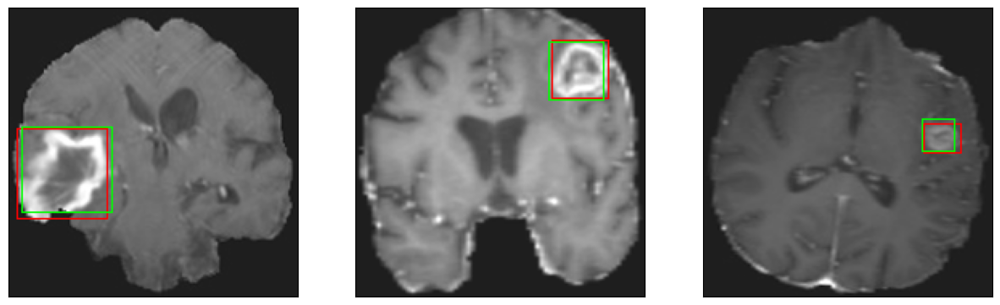

52/52 [==============================] - 8s 147ms/step - loss: 2.2733 - IoU: 0.7810 - val_loss: 4.9357 - val_IoU: 0.6973
Epoch 124/200
52/52 [==============================] - ETA: 0s - loss: 2.2710 - IoU: 0.7908
Epoch 124: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


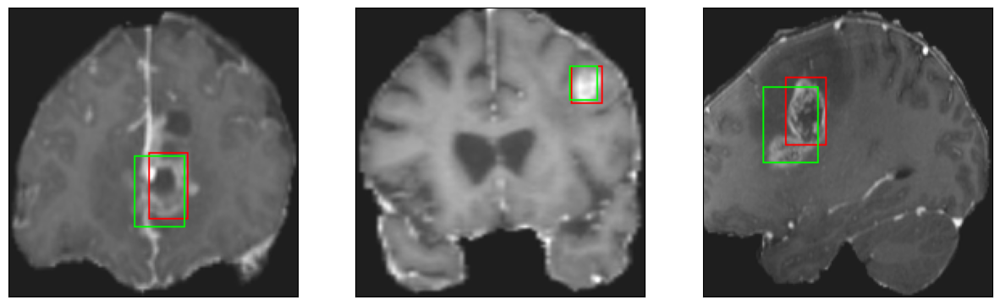

52/52 [==============================] - 6s 124ms/step - loss: 2.2710 - IoU: 0.7908 - val_loss: 4.8718 - val_IoU: 0.6942
Epoch 125/200
52/52 [==============================] - ETA: 0s - loss: 2.1811 - IoU: 0.7987
Epoch 125: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


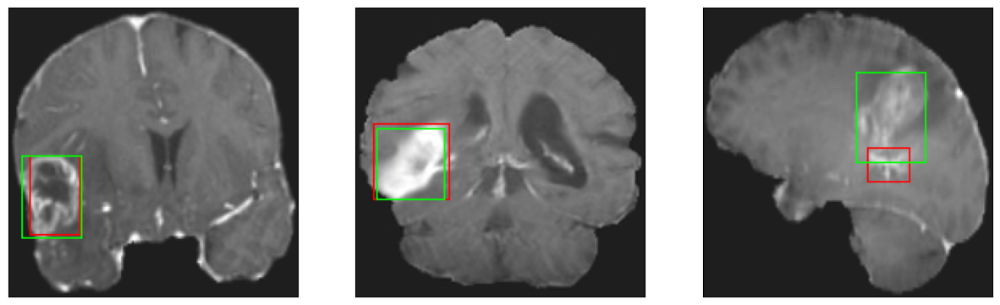

52/52 [==============================] - 8s 146ms/step - loss: 2.1811 - IoU: 0.7987 - val_loss: 5.0508 - val_IoU: 0.6827
Epoch 126/200
52/52 [==============================] - ETA: 0s - loss: 2.2850 - IoU: 0.7818
Epoch 126: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


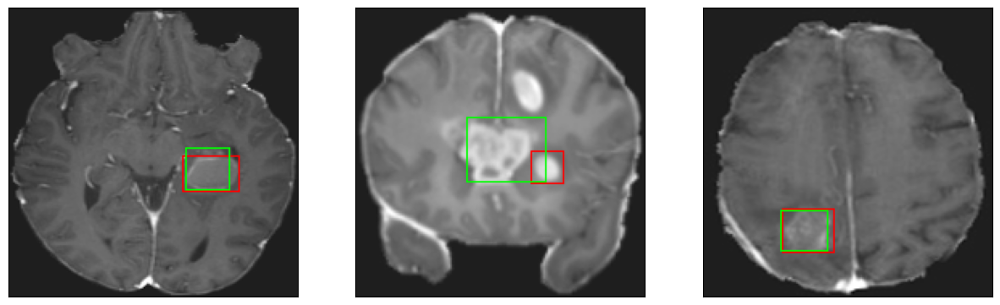

52/52 [==============================] - 7s 128ms/step - loss: 2.2850 - IoU: 0.7818 - val_loss: 4.6554 - val_IoU: 0.7048
Epoch 127/200
52/52 [==============================] - ETA: 0s - loss: 2.1581 - IoU: 0.8007
Epoch 127: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


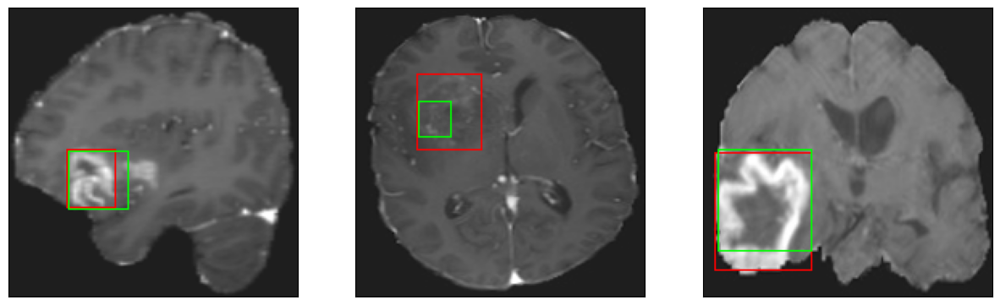

52/52 [==============================] - 8s 150ms/step - loss: 2.1581 - IoU: 0.8007 - val_loss: 4.8076 - val_IoU: 0.6895
Epoch 128/200
52/52 [==============================] - ETA: 0s - loss: 2.3224 - IoU: 0.7738
Epoch 128: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


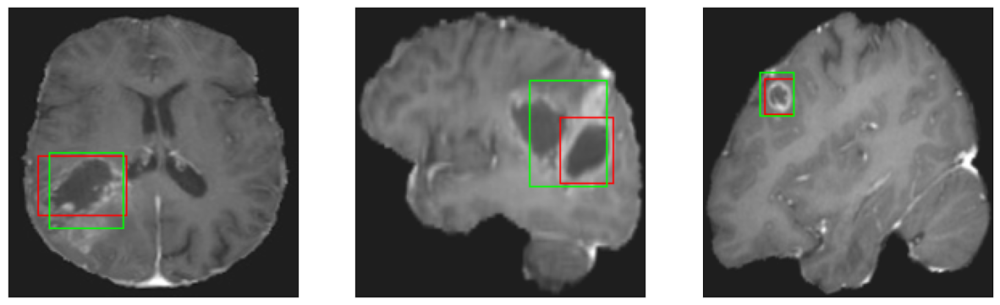

52/52 [==============================] - 7s 129ms/step - loss: 2.3224 - IoU: 0.7738 - val_loss: 5.0515 - val_IoU: 0.6722
Epoch 129/200
52/52 [==============================] - ETA: 0s - loss: 2.1778 - IoU: 0.8014
Epoch 129: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


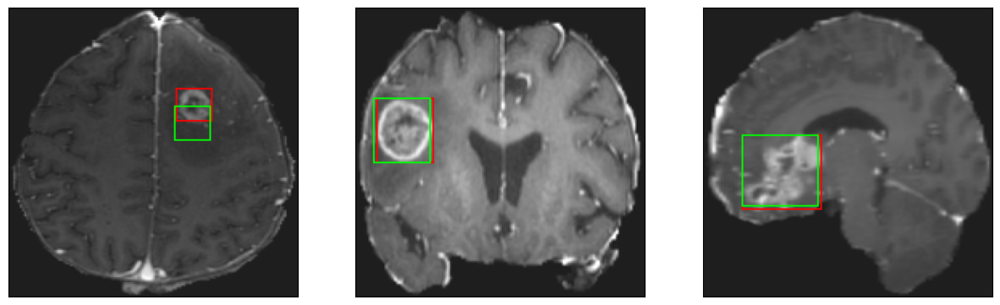

52/52 [==============================] - 8s 150ms/step - loss: 2.1778 - IoU: 0.8014 - val_loss: 4.6765 - val_IoU: 0.7090
Epoch 130/200
52/52 [==============================] - ETA: 0s - loss: 2.0975 - IoU: 0.8044
Epoch 130: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


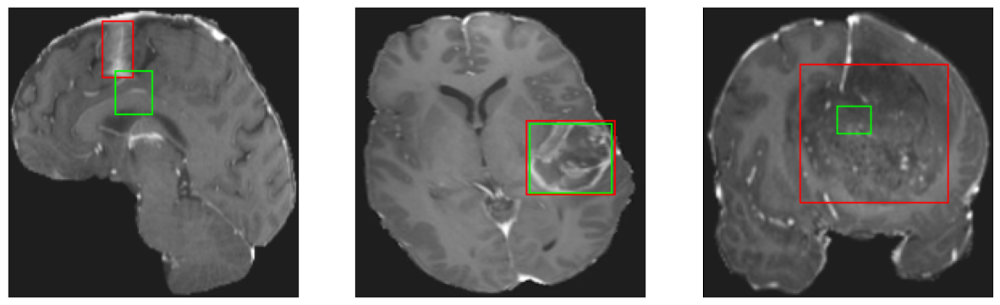

52/52 [==============================] - 7s 136ms/step - loss: 2.0975 - IoU: 0.8044 - val_loss: 4.8956 - val_IoU: 0.6917
Epoch 131/200
52/52 [==============================] - ETA: 0s - loss: 2.1690 - IoU: 0.8017
Epoch 131: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


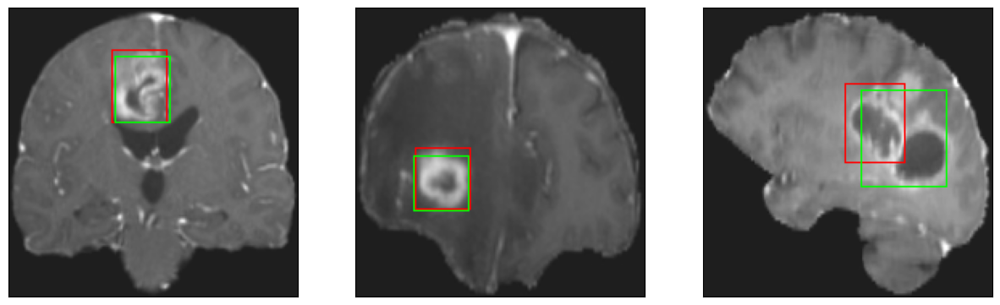

52/52 [==============================] - 7s 126ms/step - loss: 2.1690 - IoU: 0.8017 - val_loss: 4.8642 - val_IoU: 0.6910
Epoch 132/200
52/52 [==============================] - ETA: 0s - loss: 2.0625 - IoU: 0.8140
Epoch 132: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


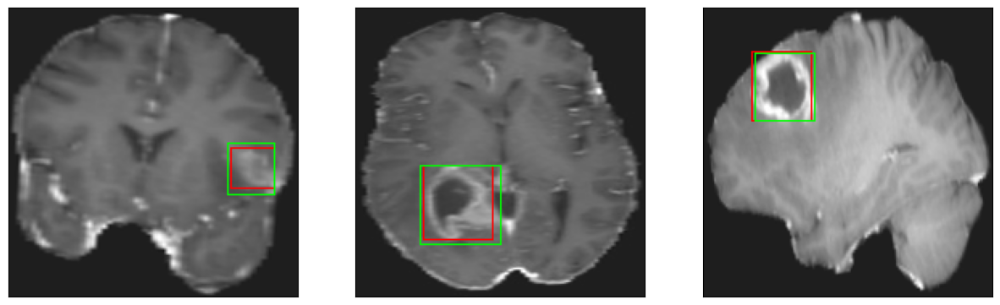

52/52 [==============================] - 7s 138ms/step - loss: 2.0625 - IoU: 0.8140 - val_loss: 4.7867 - val_IoU: 0.6898
Epoch 133/200
52/52 [==============================] - ETA: 0s - loss: 2.1486 - IoU: 0.7928
Epoch 133: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


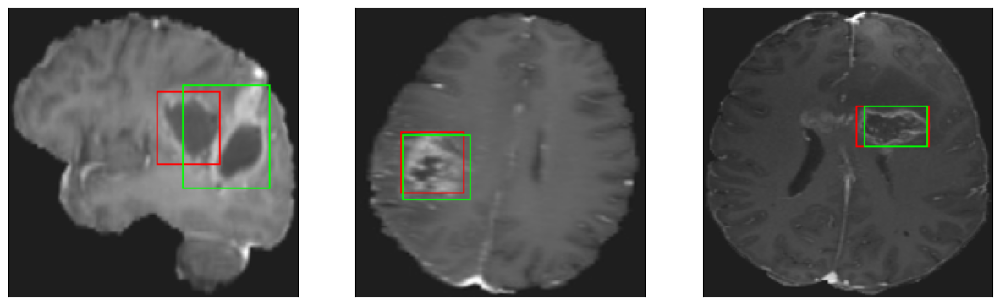

52/52 [==============================] - 7s 133ms/step - loss: 2.1486 - IoU: 0.7928 - val_loss: 4.7802 - val_IoU: 0.6899
Epoch 134/200
52/52 [==============================] - ETA: 0s - loss: 2.1777 - IoU: 0.8013
Epoch 134: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


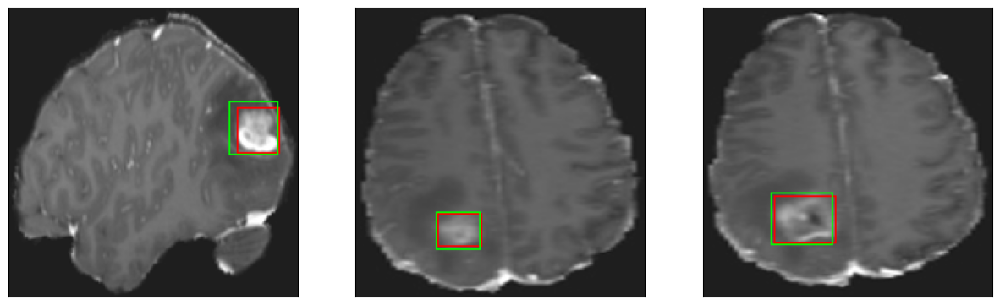

52/52 [==============================] - 8s 154ms/step - loss: 2.1777 - IoU: 0.8013 - val_loss: 4.5503 - val_IoU: 0.7203
Epoch 135/200
52/52 [==============================] - ETA: 0s - loss: 2.0739 - IoU: 0.8081
Epoch 135: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


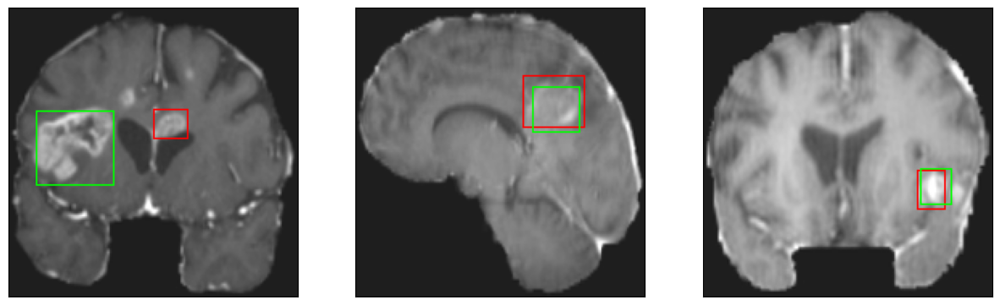

52/52 [==============================] - 7s 129ms/step - loss: 2.0739 - IoU: 0.8081 - val_loss: 4.7301 - val_IoU: 0.6881
Epoch 136/200
52/52 [==============================] - ETA: 0s - loss: 2.0550 - IoU: 0.8091
Epoch 136: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


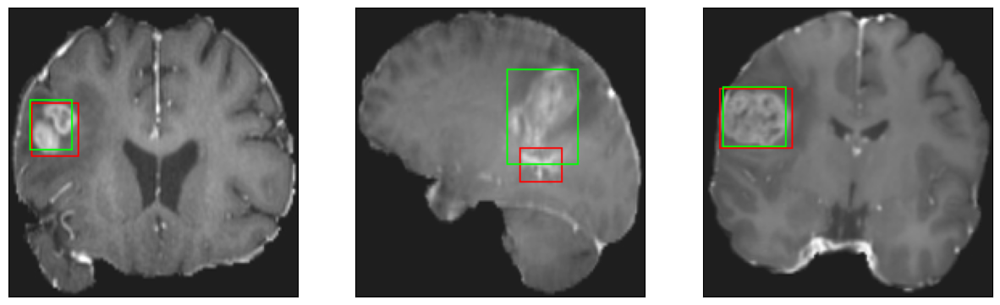

52/52 [==============================] - 7s 127ms/step - loss: 2.0550 - IoU: 0.8091 - val_loss: 4.6939 - val_IoU: 0.6915
Epoch 137/200
52/52 [==============================] - ETA: 0s - loss: 2.0841 - IoU: 0.8073
Epoch 137: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 33ms/step


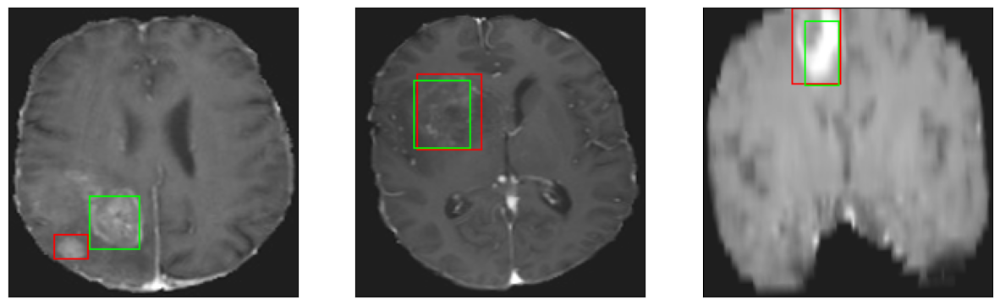

52/52 [==============================] - 7s 135ms/step - loss: 2.0841 - IoU: 0.8073 - val_loss: 4.7164 - val_IoU: 0.7061
Epoch 138/200
52/52 [==============================] - ETA: 0s - loss: 2.1357 - IoU: 0.8047
Epoch 138: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


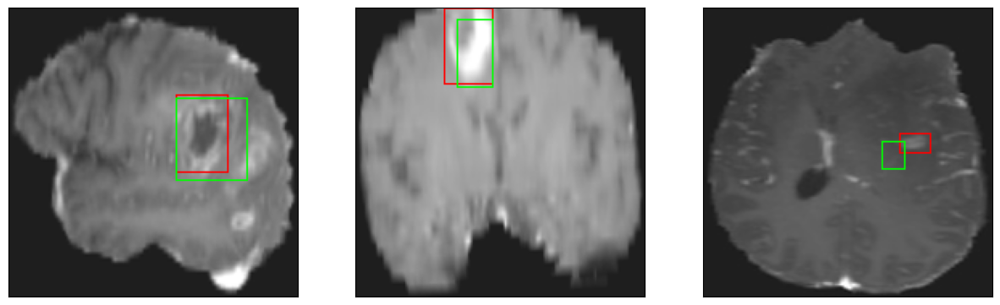

52/52 [==============================] - 7s 126ms/step - loss: 2.1357 - IoU: 0.8047 - val_loss: 4.5479 - val_IoU: 0.7139
Epoch 139/200
52/52 [==============================] - ETA: 0s - loss: 2.0487 - IoU: 0.8113
Epoch 139: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


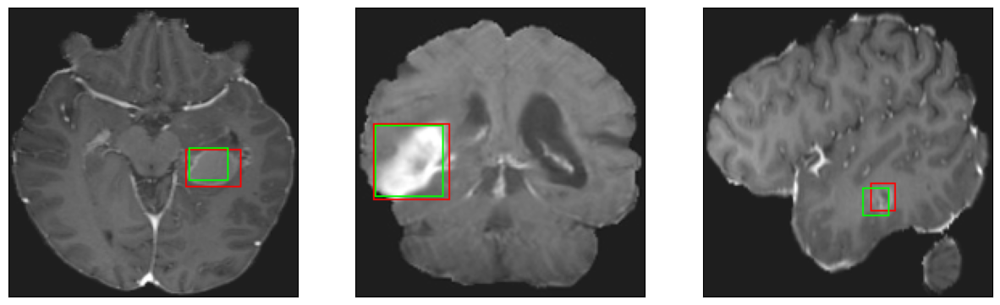

52/52 [==============================] - 7s 133ms/step - loss: 2.0487 - IoU: 0.8113 - val_loss: 4.6103 - val_IoU: 0.7166
Epoch 140/200
52/52 [==============================] - ETA: 0s - loss: 2.0339 - IoU: 0.8110
Epoch 140: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 32ms/step


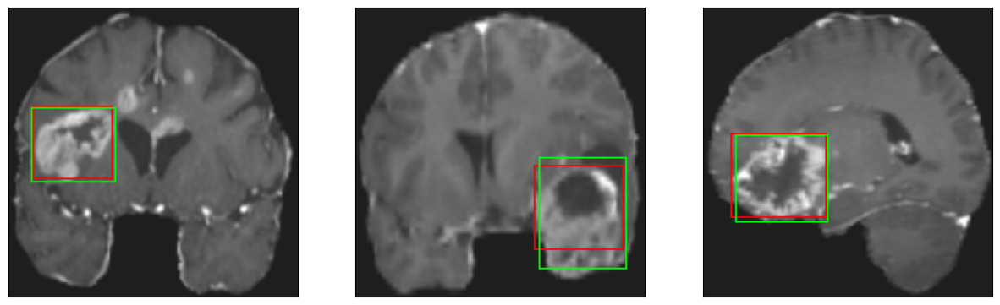

52/52 [==============================] - 7s 137ms/step - loss: 2.0339 - IoU: 0.8110 - val_loss: 4.4884 - val_IoU: 0.7172
Epoch 141/200
52/52 [==============================] - ETA: 0s - loss: 2.1174 - IoU: 0.8059
Epoch 141: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 30ms/step


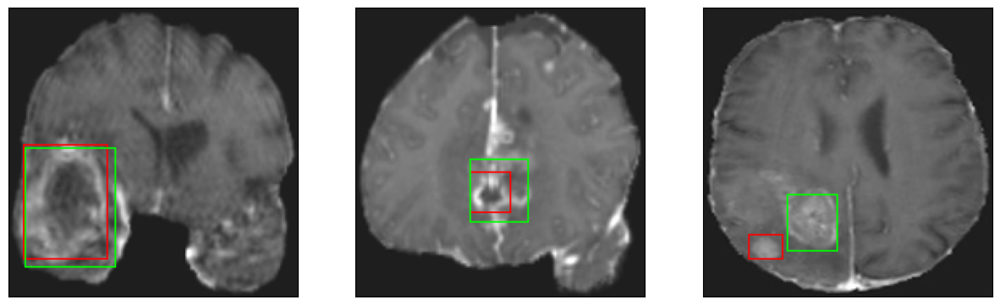

52/52 [==============================] - 7s 134ms/step - loss: 2.1174 - IoU: 0.8059 - val_loss: 4.5527 - val_IoU: 0.7194
Epoch 142/200
52/52 [==============================] - ETA: 0s - loss: 2.1035 - IoU: 0.8047
Epoch 142: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 41ms/step


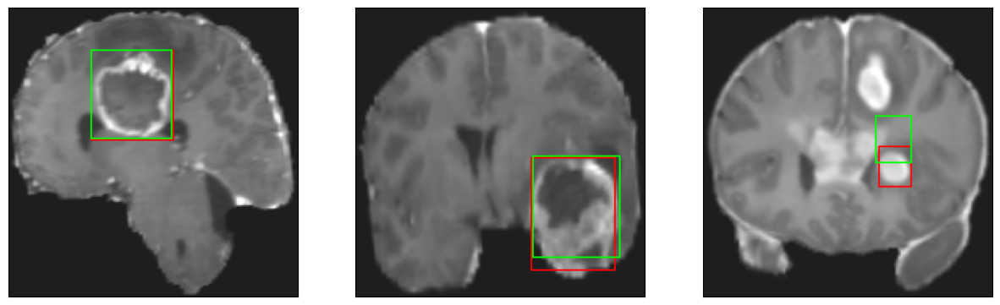

52/52 [==============================] - 10s 199ms/step - loss: 2.1035 - IoU: 0.8047 - val_loss: 4.6961 - val_IoU: 0.7087
Epoch 143/200
52/52 [==============================] - ETA: 0s - loss: 2.1791 - IoU: 0.7992
Epoch 143: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


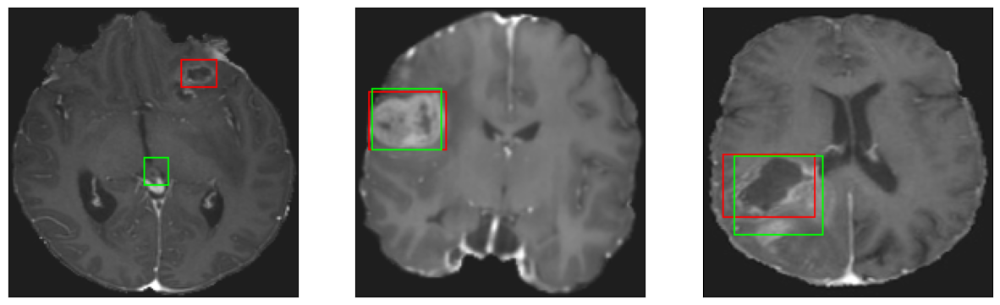

52/52 [==============================] - 7s 129ms/step - loss: 2.1791 - IoU: 0.7992 - val_loss: 4.6546 - val_IoU: 0.6978
Epoch 144/200
52/52 [==============================] - ETA: 0s - loss: 2.1069 - IoU: 0.7981
Epoch 144: val_loss did not improve from 4.48707
8/8 [==============================] - 0s 31ms/step


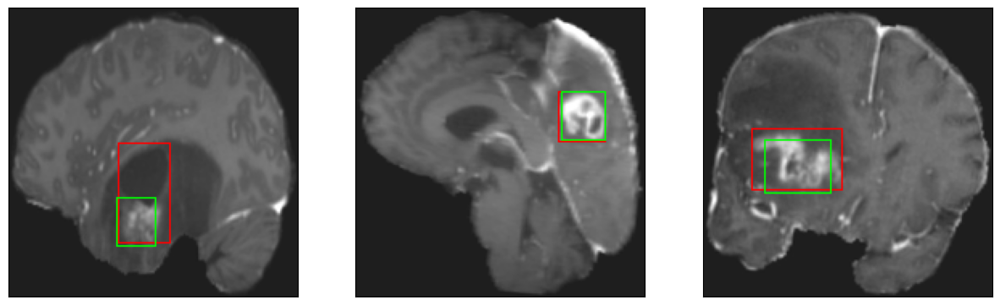

52/52 [==============================] - 7s 144ms/step - loss: 2.1069 - IoU: 0.7981 - val_loss: 4.6100 - val_IoU: 0.7035
Epoch 145/200
52/52 [==============================] - ETA: 0s - loss: 2.0941 - IoU: 0.8064
Epoch 145: val_loss improved from 4.48707 to 4.46389, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


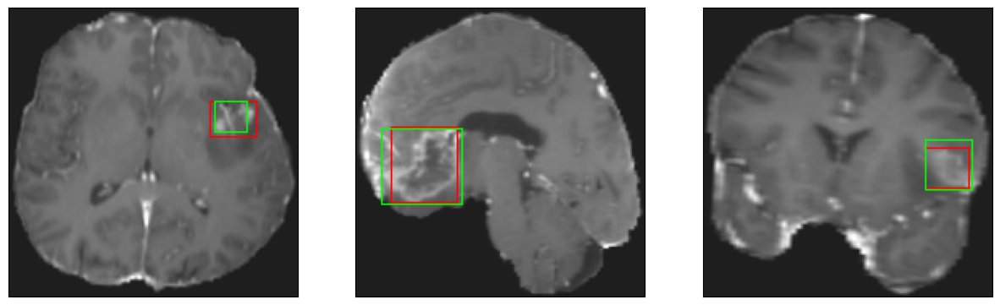

52/52 [==============================] - 9s 182ms/step - loss: 2.0941 - IoU: 0.8064 - val_loss: 4.4639 - val_IoU: 0.7057
Epoch 146/200
52/52 [==============================] - ETA: 0s - loss: 2.1417 - IoU: 0.8068
Epoch 146: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 33ms/step


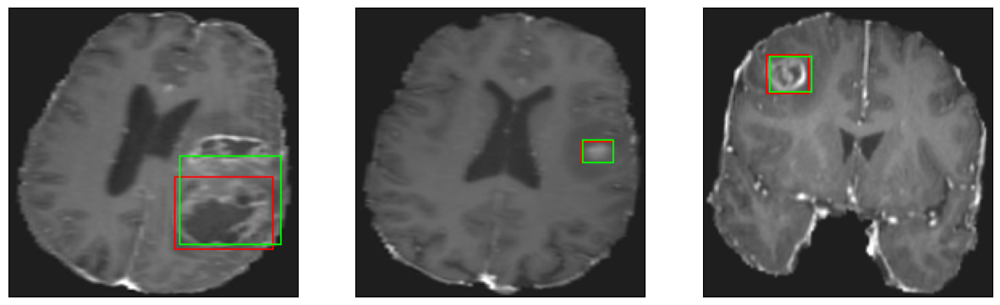

52/52 [==============================] - 7s 137ms/step - loss: 2.1417 - IoU: 0.8068 - val_loss: 4.8499 - val_IoU: 0.6911
Epoch 147/200
52/52 [==============================] - ETA: 0s - loss: 2.0610 - IoU: 0.8072
Epoch 147: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 33ms/step


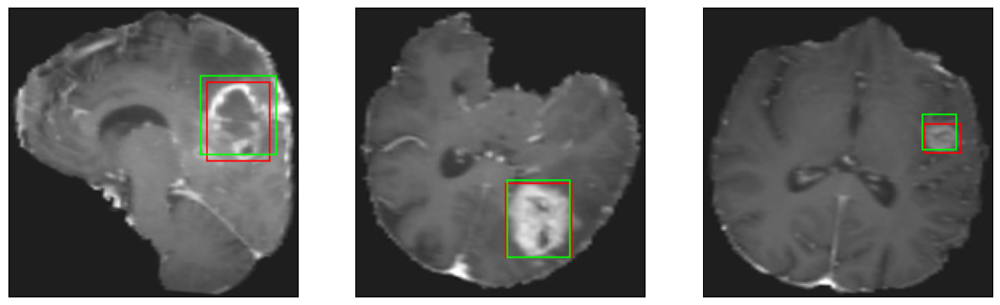

52/52 [==============================] - 7s 140ms/step - loss: 2.0610 - IoU: 0.8072 - val_loss: 4.5898 - val_IoU: 0.7041
Epoch 148/200
52/52 [==============================] - ETA: 0s - loss: 2.0715 - IoU: 0.8064
Epoch 148: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


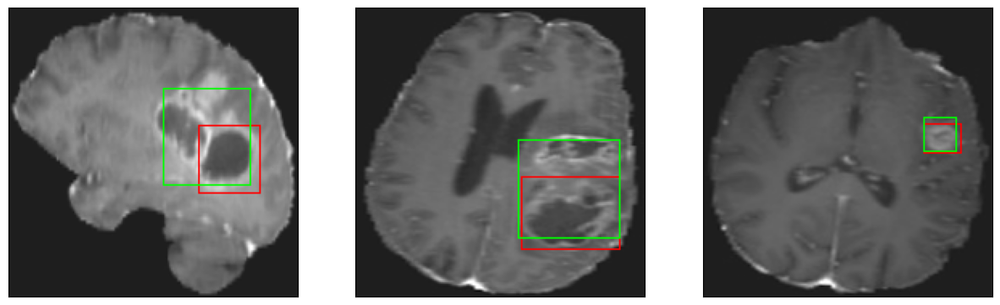

52/52 [==============================] - 7s 126ms/step - loss: 2.0715 - IoU: 0.8064 - val_loss: 4.8173 - val_IoU: 0.6907
Epoch 149/200
52/52 [==============================] - ETA: 0s - loss: 2.1086 - IoU: 0.8057
Epoch 149: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 30ms/step


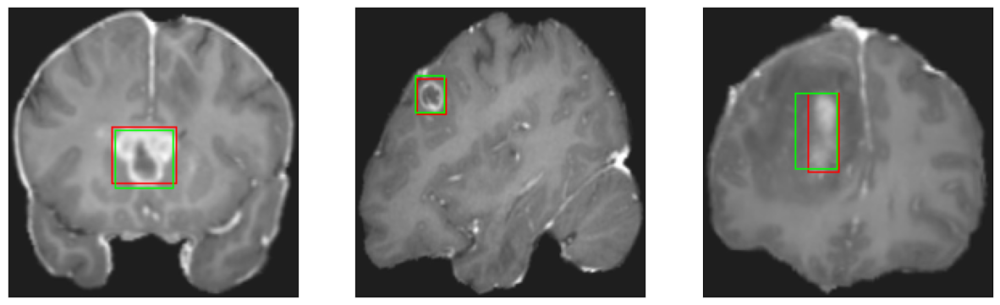

52/52 [==============================] - 7s 138ms/step - loss: 2.1086 - IoU: 0.8057 - val_loss: 4.6979 - val_IoU: 0.6940
Epoch 150/200
52/52 [==============================] - ETA: 0s - loss: 2.0280 - IoU: 0.8134
Epoch 150: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 34ms/step


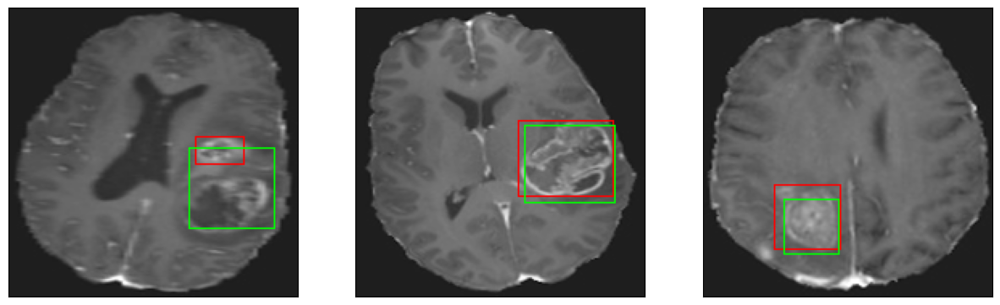

52/52 [==============================] - 7s 132ms/step - loss: 2.0280 - IoU: 0.8134 - val_loss: 4.7219 - val_IoU: 0.7031
Epoch 151/200
52/52 [==============================] - ETA: 0s - loss: 1.9872 - IoU: 0.8176
Epoch 151: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


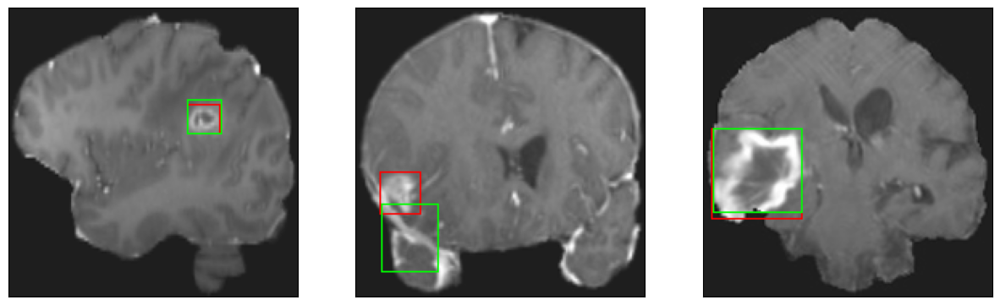

52/52 [==============================] - 7s 141ms/step - loss: 1.9872 - IoU: 0.8176 - val_loss: 4.6847 - val_IoU: 0.7064
Epoch 152/200
52/52 [==============================] - ETA: 0s - loss: 2.0181 - IoU: 0.8154
Epoch 152: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


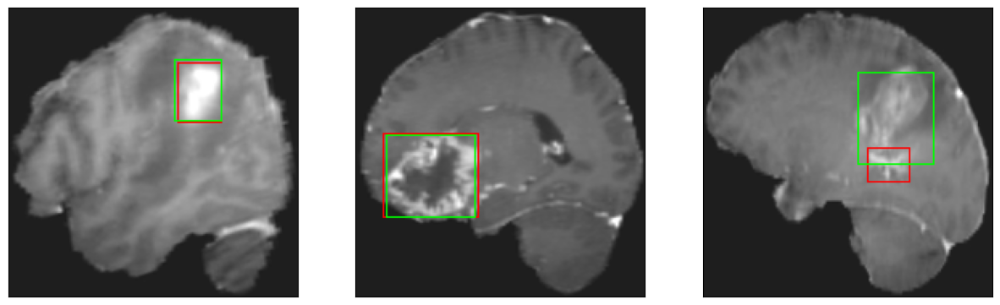

52/52 [==============================] - 7s 129ms/step - loss: 2.0181 - IoU: 0.8154 - val_loss: 4.8180 - val_IoU: 0.6996
Epoch 153/200
52/52 [==============================] - ETA: 0s - loss: 2.0231 - IoU: 0.8151
Epoch 153: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


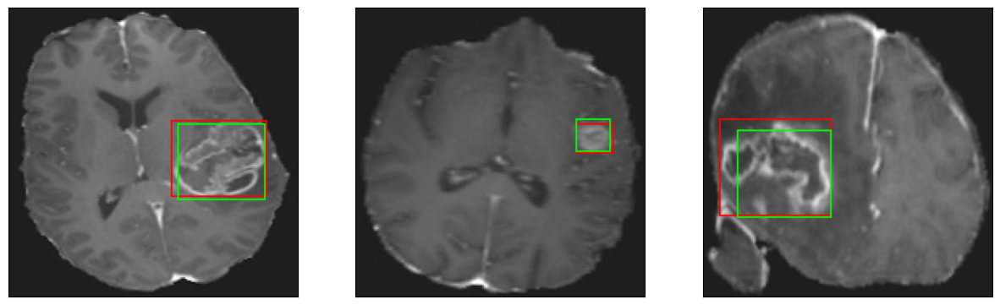

52/52 [==============================] - 9s 169ms/step - loss: 2.0231 - IoU: 0.8151 - val_loss: 4.4715 - val_IoU: 0.7284
Epoch 154/200
52/52 [==============================] - ETA: 0s - loss: 2.0103 - IoU: 0.8148
Epoch 154: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 32ms/step


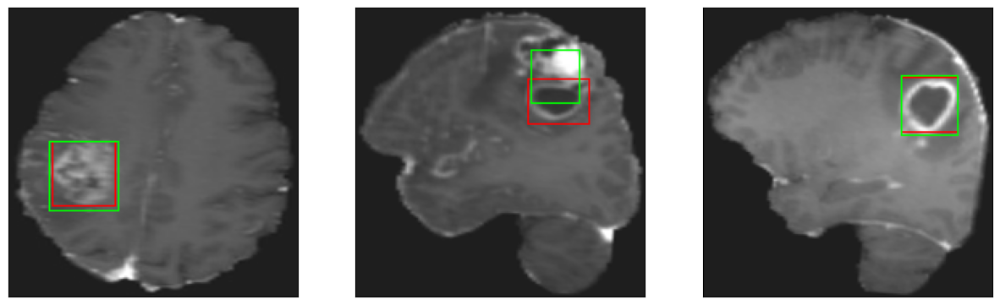

52/52 [==============================] - 7s 132ms/step - loss: 2.0103 - IoU: 0.8148 - val_loss: 4.6803 - val_IoU: 0.7055
Epoch 155/200
52/52 [==============================] - ETA: 0s - loss: 2.1118 - IoU: 0.7955
Epoch 155: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


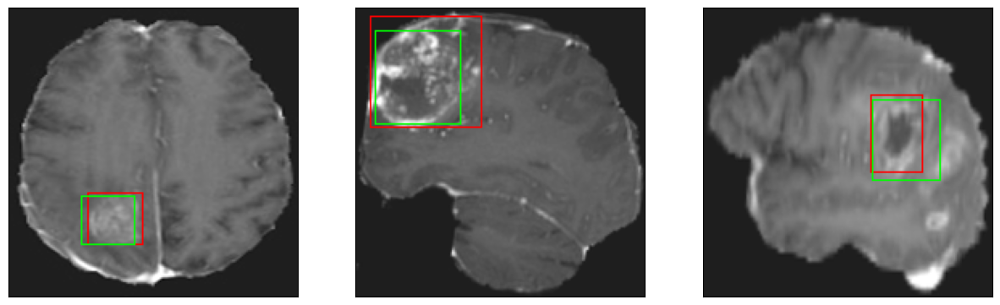

52/52 [==============================] - 7s 141ms/step - loss: 2.1118 - IoU: 0.7955 - val_loss: 4.5732 - val_IoU: 0.7121
Epoch 156/200
52/52 [==============================] - ETA: 0s - loss: 2.0429 - IoU: 0.8115
Epoch 156: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


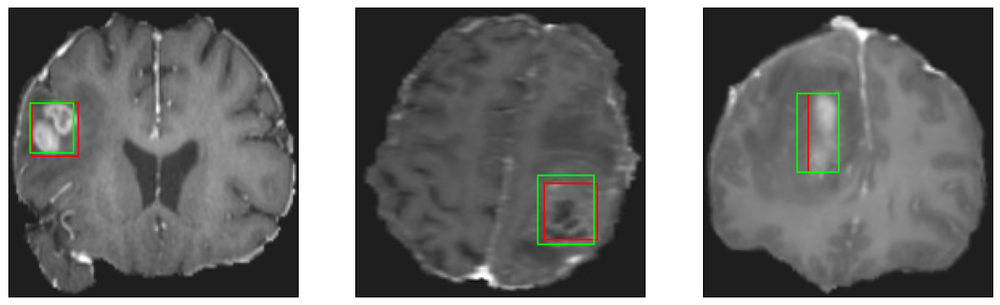

52/52 [==============================] - 7s 132ms/step - loss: 2.0429 - IoU: 0.8115 - val_loss: 4.6285 - val_IoU: 0.7086
Epoch 157/200
52/52 [==============================] - ETA: 0s - loss: 2.1129 - IoU: 0.7994
Epoch 157: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 30ms/step


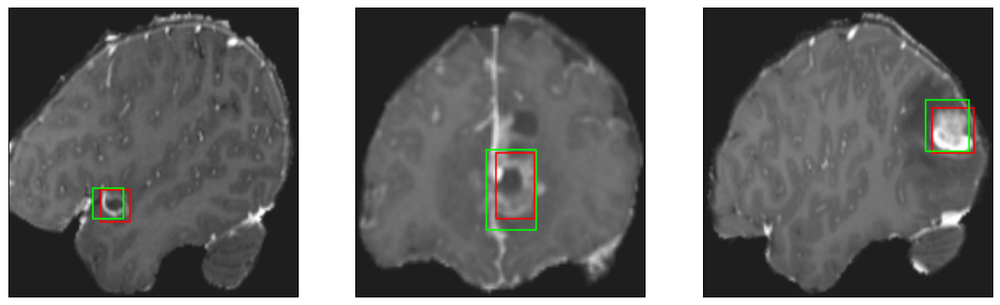

52/52 [==============================] - 6s 124ms/step - loss: 2.1129 - IoU: 0.7994 - val_loss: 4.6974 - val_IoU: 0.6961
Epoch 158/200
52/52 [==============================] - ETA: 0s - loss: 2.0619 - IoU: 0.8136
Epoch 158: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


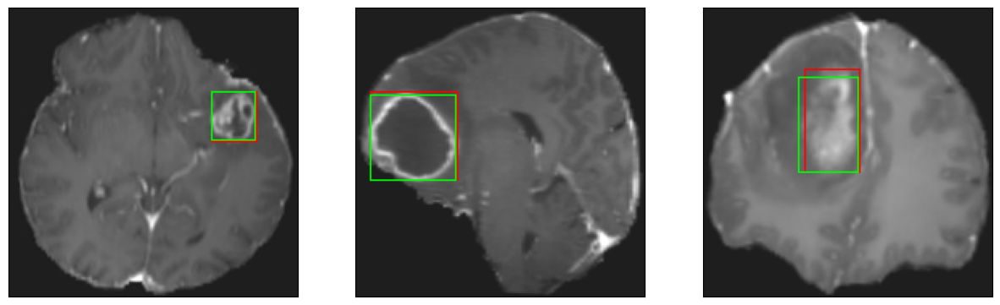

52/52 [==============================] - 7s 140ms/step - loss: 2.0619 - IoU: 0.8136 - val_loss: 4.6515 - val_IoU: 0.7212
Epoch 159/200
52/52 [==============================] - ETA: 0s - loss: 1.9630 - IoU: 0.8177
Epoch 159: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


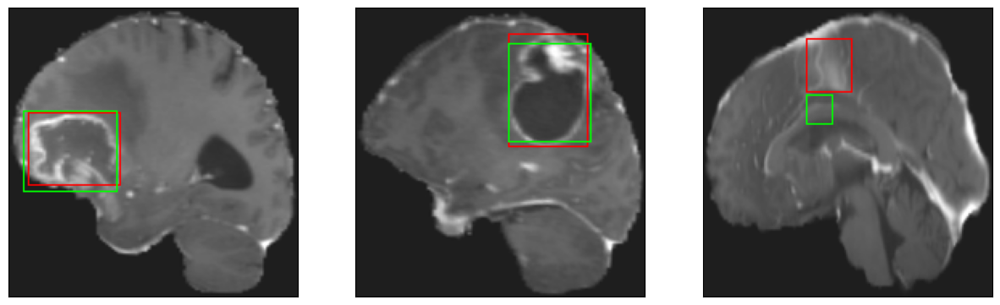

52/52 [==============================] - 7s 126ms/step - loss: 1.9630 - IoU: 0.8177 - val_loss: 4.8879 - val_IoU: 0.6990
Epoch 160/200
52/52 [==============================] - ETA: 0s - loss: 2.0173 - IoU: 0.8109
Epoch 160: val_loss did not improve from 4.46389
8/8 [==============================] - 0s 31ms/step


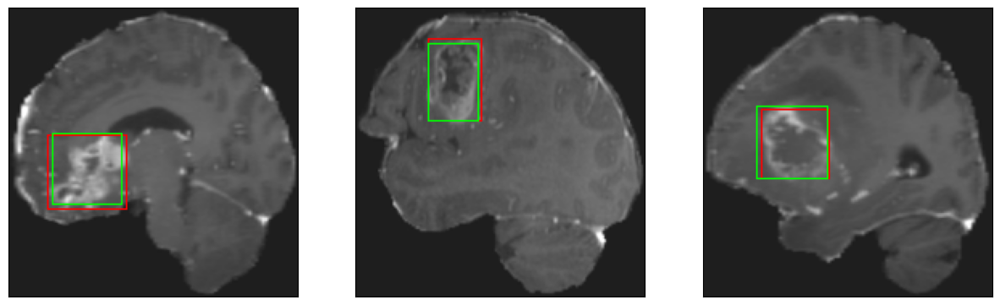

52/52 [==============================] - 6s 122ms/step - loss: 2.0173 - IoU: 0.8109 - val_loss: 4.6420 - val_IoU: 0.7067
Epoch 161/200
52/52 [==============================] - ETA: 0s - loss: 2.0148 - IoU: 0.8149
Epoch 161: val_loss improved from 4.46389 to 4.46104, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


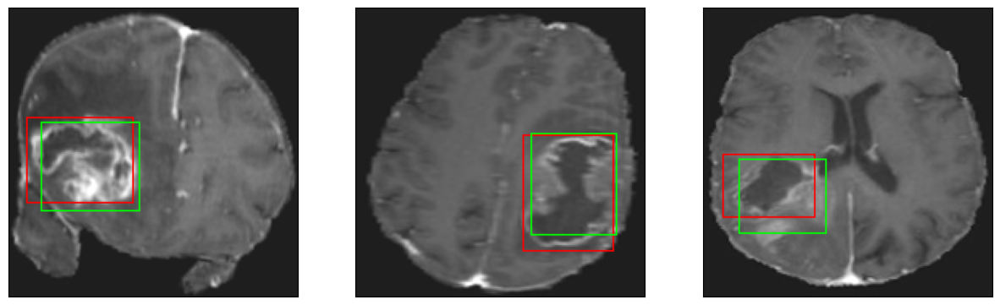

52/52 [==============================] - 10s 189ms/step - loss: 2.0148 - IoU: 0.8149 - val_loss: 4.4610 - val_IoU: 0.7178
Epoch 162/200
52/52 [==============================] - ETA: 0s - loss: 2.0427 - IoU: 0.8114
Epoch 162: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


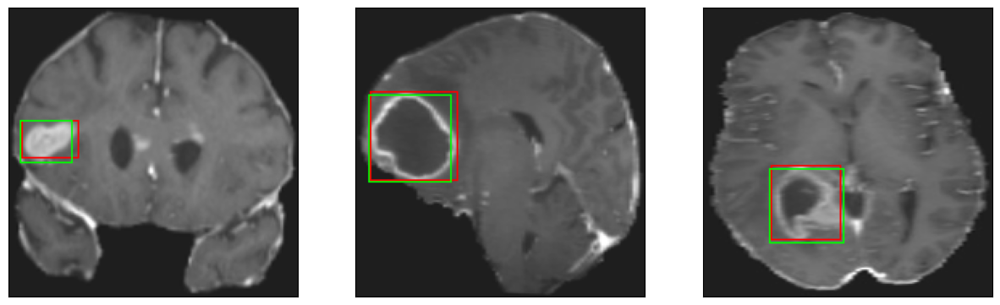

52/52 [==============================] - 7s 127ms/step - loss: 2.0427 - IoU: 0.8114 - val_loss: 4.7115 - val_IoU: 0.7067
Epoch 163/200
52/52 [==============================] - ETA: 0s - loss: 2.0186 - IoU: 0.8083
Epoch 163: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


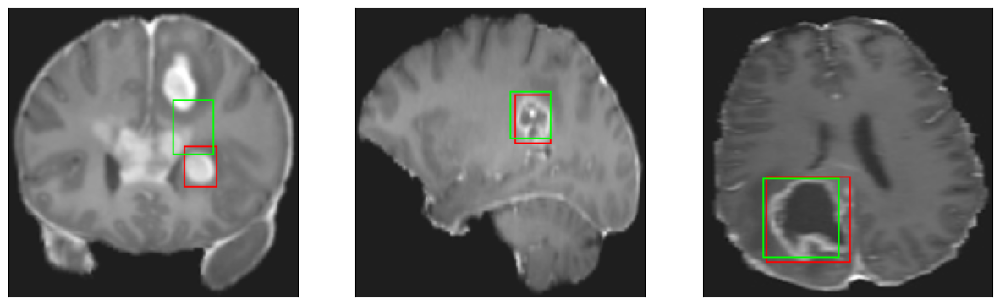

52/52 [==============================] - 8s 147ms/step - loss: 2.0186 - IoU: 0.8083 - val_loss: 4.8000 - val_IoU: 0.7027
Epoch 164/200
52/52 [==============================] - ETA: 0s - loss: 2.0067 - IoU: 0.8143
Epoch 164: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


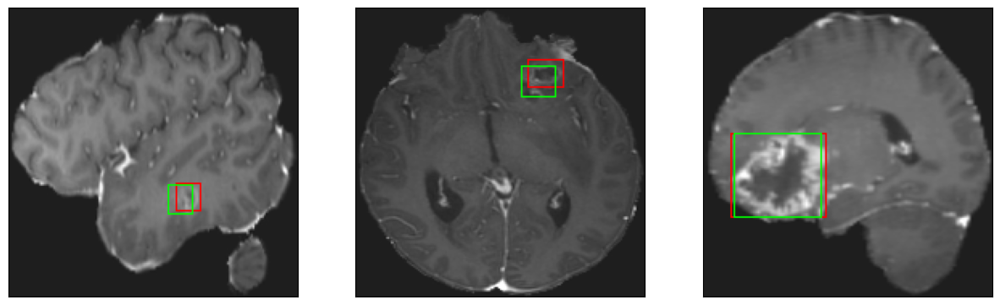

52/52 [==============================] - 7s 131ms/step - loss: 2.0067 - IoU: 0.8143 - val_loss: 4.7597 - val_IoU: 0.7028
Epoch 165/200
52/52 [==============================] - ETA: 0s - loss: 2.1320 - IoU: 0.8047
Epoch 165: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 33ms/step


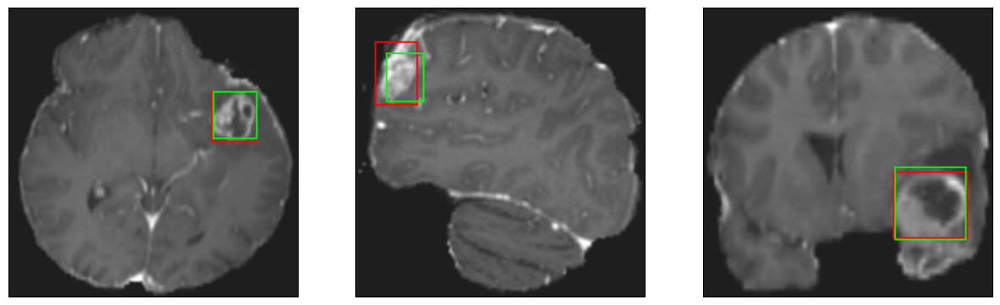

52/52 [==============================] - 7s 136ms/step - loss: 2.1320 - IoU: 0.8047 - val_loss: 4.7581 - val_IoU: 0.7001
Epoch 166/200
52/52 [==============================] - ETA: 0s - loss: 1.9293 - IoU: 0.8204
Epoch 166: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 30ms/step


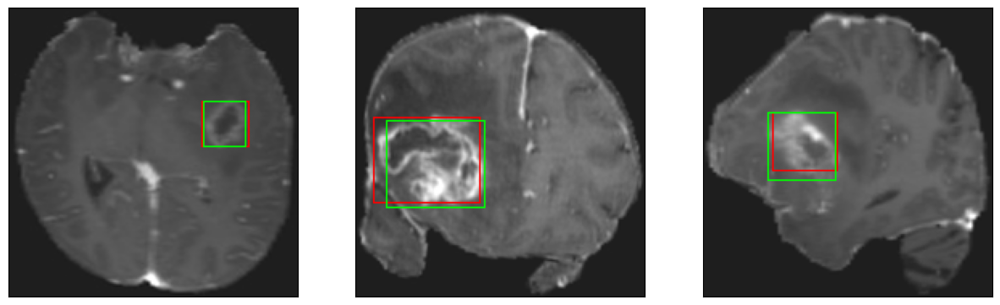

52/52 [==============================] - 6s 125ms/step - loss: 1.9293 - IoU: 0.8204 - val_loss: 4.6675 - val_IoU: 0.7118
Epoch 167/200
52/52 [==============================] - ETA: 0s - loss: 1.9942 - IoU: 0.8142
Epoch 167: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


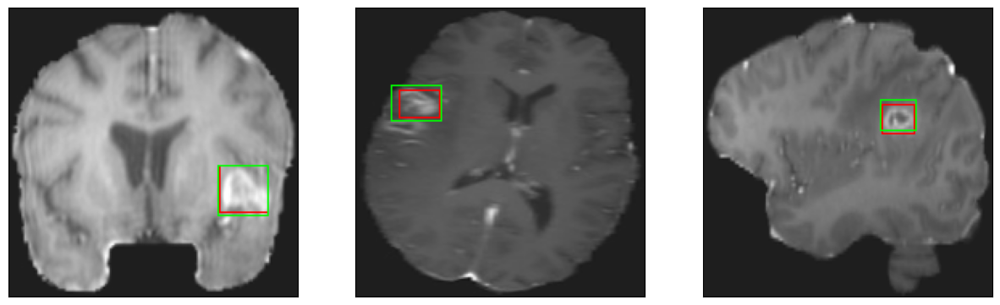

52/52 [==============================] - 7s 132ms/step - loss: 1.9942 - IoU: 0.8142 - val_loss: 4.7180 - val_IoU: 0.7044
Epoch 168/200
52/52 [==============================] - ETA: 0s - loss: 1.9345 - IoU: 0.8183
Epoch 168: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 34ms/step


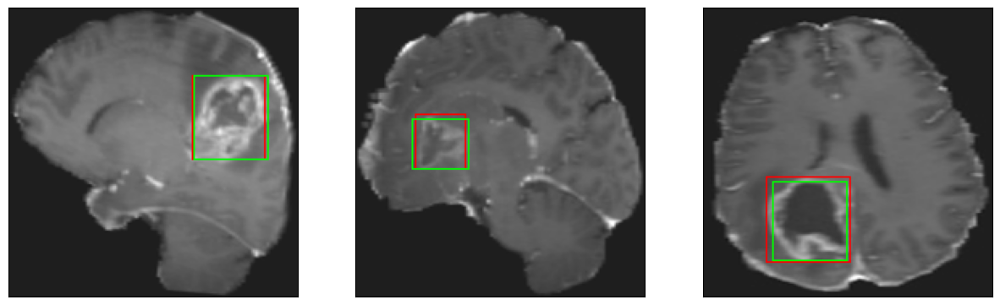

52/52 [==============================] - 7s 135ms/step - loss: 1.9345 - IoU: 0.8183 - val_loss: 4.5473 - val_IoU: 0.6939
Epoch 169/200
52/52 [==============================] - ETA: 0s - loss: 1.9043 - IoU: 0.8206
Epoch 169: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


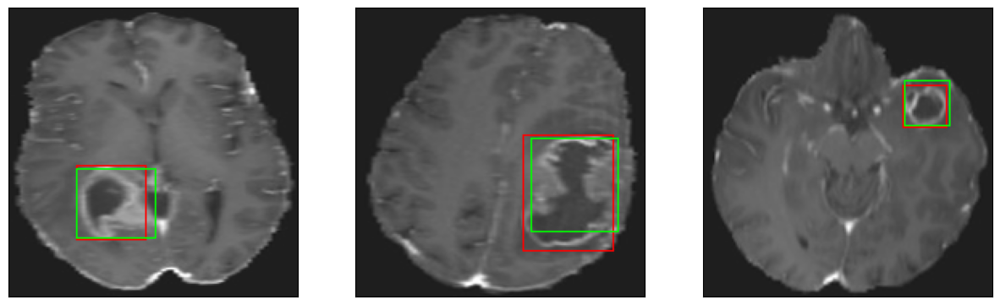

52/52 [==============================] - 7s 135ms/step - loss: 1.9043 - IoU: 0.8206 - val_loss: 4.5733 - val_IoU: 0.7110
Epoch 170/200
52/52 [==============================] - ETA: 0s - loss: 2.0271 - IoU: 0.8036
Epoch 170: val_loss did not improve from 4.46104
8/8 [==============================] - 0s 31ms/step


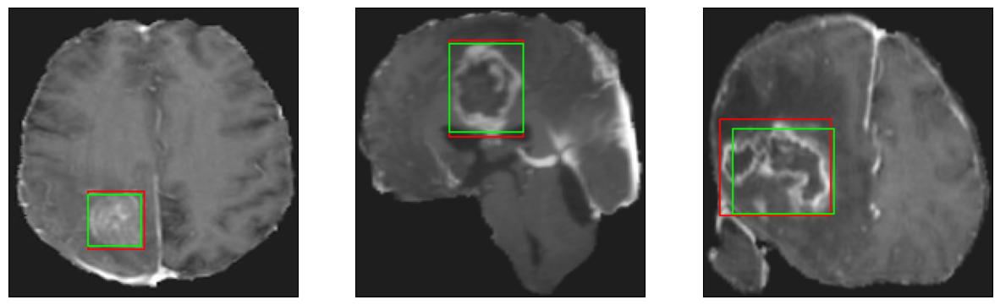

52/52 [==============================] - 7s 129ms/step - loss: 2.0271 - IoU: 0.8036 - val_loss: 4.5627 - val_IoU: 0.7042
Epoch 171/200
52/52 [==============================] - ETA: 0s - loss: 1.9415 - IoU: 0.8225
Epoch 171: val_loss improved from 4.46104 to 4.44106, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 32ms/step


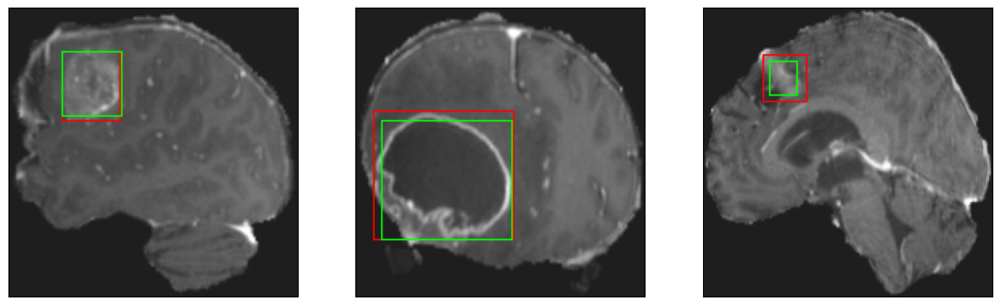

52/52 [==============================] - 10s 191ms/step - loss: 1.9415 - IoU: 0.8225 - val_loss: 4.4411 - val_IoU: 0.7218
Epoch 172/200
52/52 [==============================] - ETA: 0s - loss: 1.9425 - IoU: 0.8192
Epoch 172: val_loss improved from 4.44106 to 4.43686, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 34ms/step


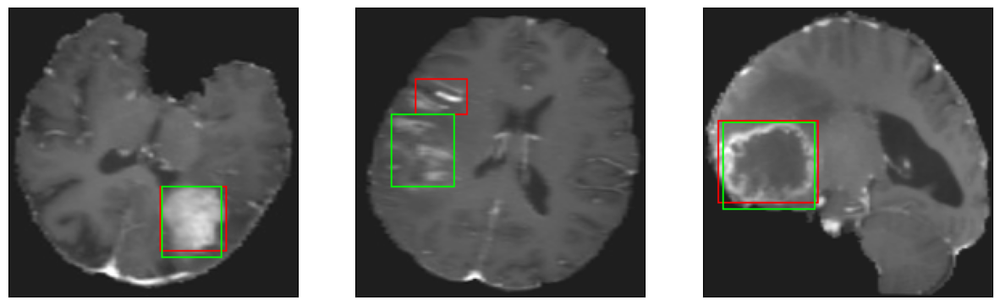

52/52 [==============================] - 9s 171ms/step - loss: 1.9425 - IoU: 0.8192 - val_loss: 4.4369 - val_IoU: 0.7109
Epoch 173/200
52/52 [==============================] - ETA: 0s - loss: 1.9291 - IoU: 0.8232
Epoch 173: val_loss did not improve from 4.43686
8/8 [==============================] - 0s 33ms/step


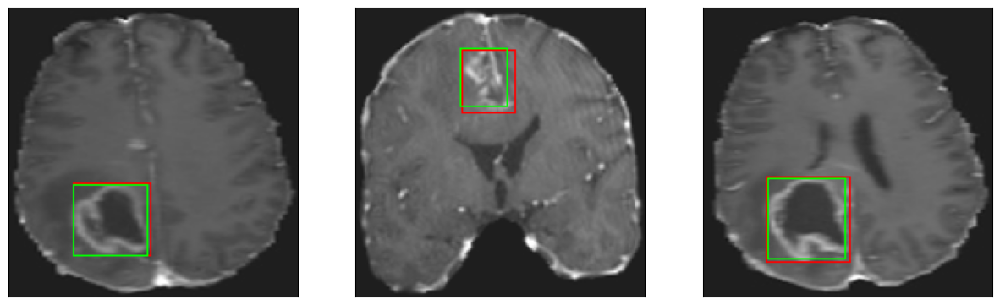

52/52 [==============================] - 7s 136ms/step - loss: 1.9291 - IoU: 0.8232 - val_loss: 4.6554 - val_IoU: 0.7012
Epoch 174/200
52/52 [==============================] - ETA: 0s - loss: 1.9750 - IoU: 0.8181
Epoch 174: val_loss did not improve from 4.43686
8/8 [==============================] - 0s 32ms/step


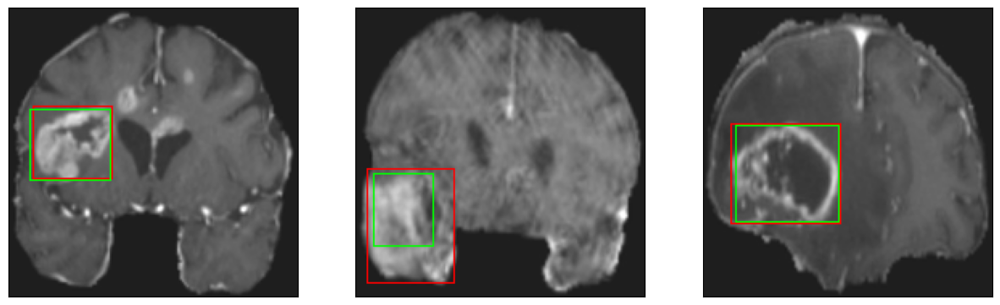

52/52 [==============================] - 7s 137ms/step - loss: 1.9750 - IoU: 0.8181 - val_loss: 4.7856 - val_IoU: 0.6887
Epoch 175/200
52/52 [==============================] - ETA: 0s - loss: 1.9724 - IoU: 0.8196
Epoch 175: val_loss did not improve from 4.43686
8/8 [==============================] - 0s 31ms/step


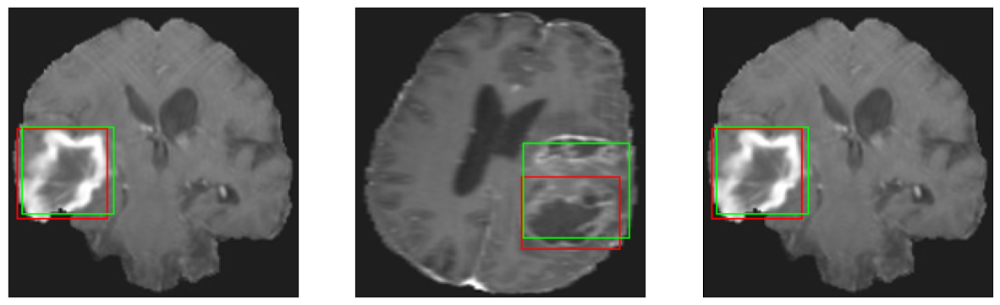

52/52 [==============================] - 7s 129ms/step - loss: 1.9724 - IoU: 0.8196 - val_loss: 4.5834 - val_IoU: 0.7133
Epoch 176/200
52/52 [==============================] - ETA: 0s - loss: 1.9441 - IoU: 0.8199
Epoch 176: val_loss improved from 4.43686 to 4.40528, saving model to ./model_checkpoint_EFFNET/model_EFFNET.h5
8/8 [==============================] - 0s 31ms/step


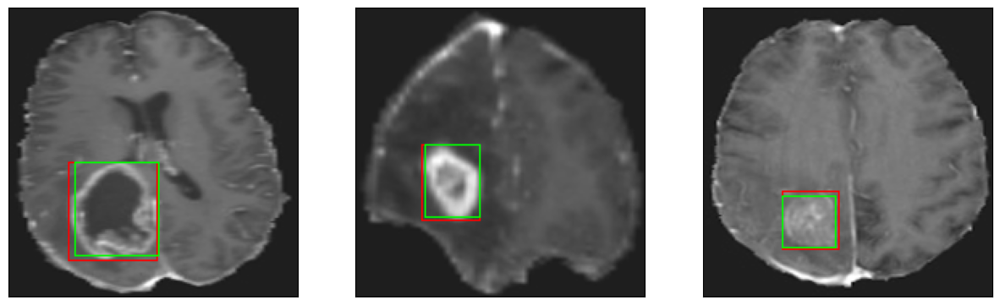

52/52 [==============================] - 10s 189ms/step - loss: 1.9441 - IoU: 0.8199 - val_loss: 4.4053 - val_IoU: 0.7215
Epoch 177/200
52/52 [==============================] - ETA: 0s - loss: 1.9580 - IoU: 0.8177
Epoch 177: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 32ms/step


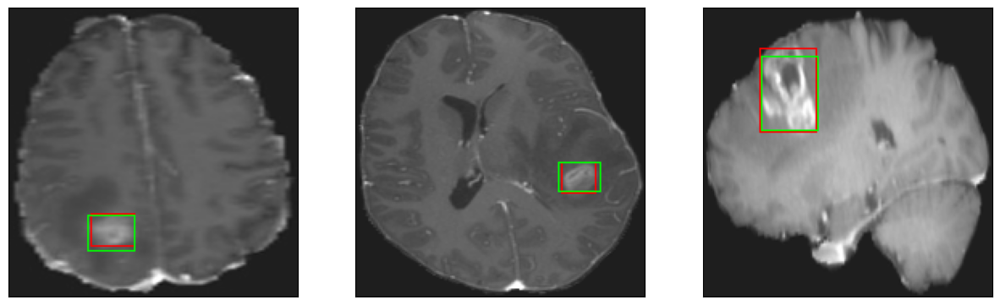

52/52 [==============================] - 7s 137ms/step - loss: 1.9580 - IoU: 0.8177 - val_loss: 4.9243 - val_IoU: 0.7018
Epoch 178/200
52/52 [==============================] - ETA: 0s - loss: 1.9892 - IoU: 0.8088
Epoch 178: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


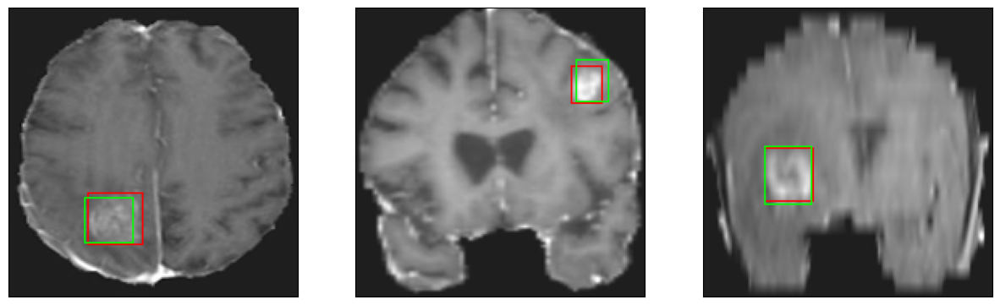

52/52 [==============================] - 7s 131ms/step - loss: 1.9892 - IoU: 0.8088 - val_loss: 4.7846 - val_IoU: 0.6848
Epoch 179/200
52/52 [==============================] - ETA: 0s - loss: 2.0245 - IoU: 0.8130
Epoch 179: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 30ms/step


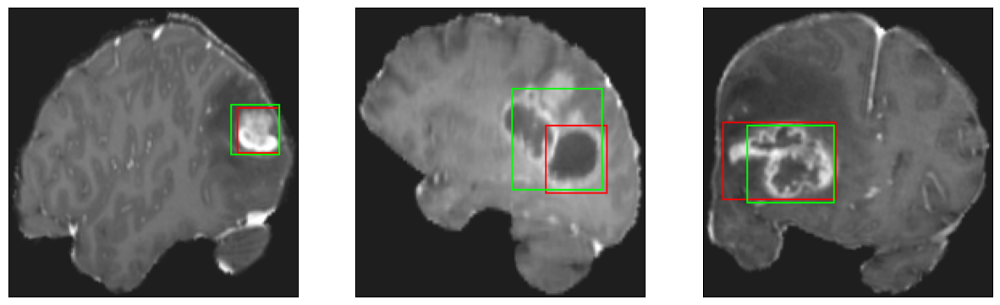

52/52 [==============================] - 7s 140ms/step - loss: 2.0245 - IoU: 0.8130 - val_loss: 4.5066 - val_IoU: 0.7155
Epoch 180/200
52/52 [==============================] - ETA: 0s - loss: 1.8618 - IoU: 0.8276
Epoch 180: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


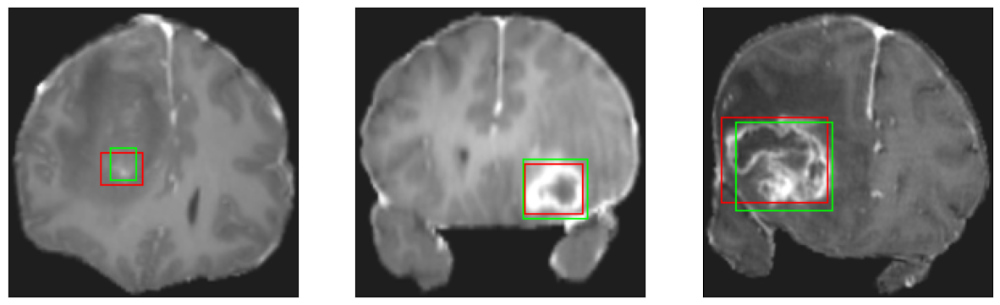

52/52 [==============================] - 7s 130ms/step - loss: 1.8618 - IoU: 0.8276 - val_loss: 4.5800 - val_IoU: 0.7086
Epoch 181/200
52/52 [==============================] - ETA: 0s - loss: 2.0071 - IoU: 0.8051
Epoch 181: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 30ms/step


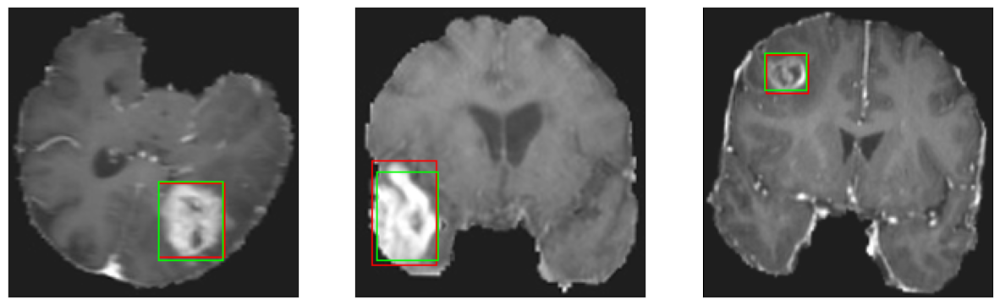

52/52 [==============================] - 8s 147ms/step - loss: 2.0071 - IoU: 0.8051 - val_loss: 4.6349 - val_IoU: 0.7041
Epoch 182/200
52/52 [==============================] - ETA: 0s - loss: 1.8604 - IoU: 0.8252
Epoch 182: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


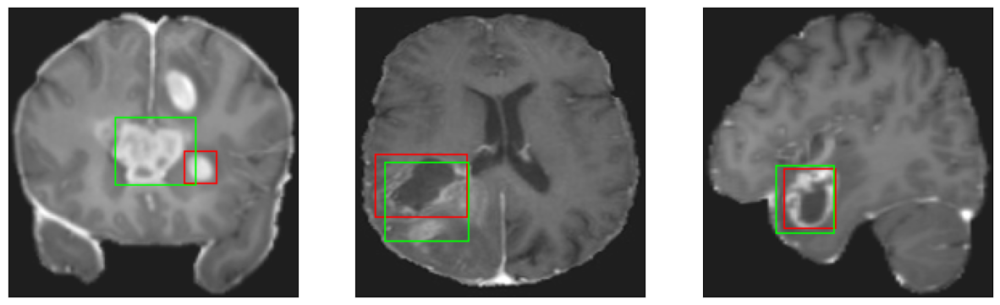

52/52 [==============================] - 7s 129ms/step - loss: 1.8604 - IoU: 0.8252 - val_loss: 4.6953 - val_IoU: 0.7043
Epoch 183/200
52/52 [==============================] - ETA: 0s - loss: 1.9071 - IoU: 0.8196
Epoch 183: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


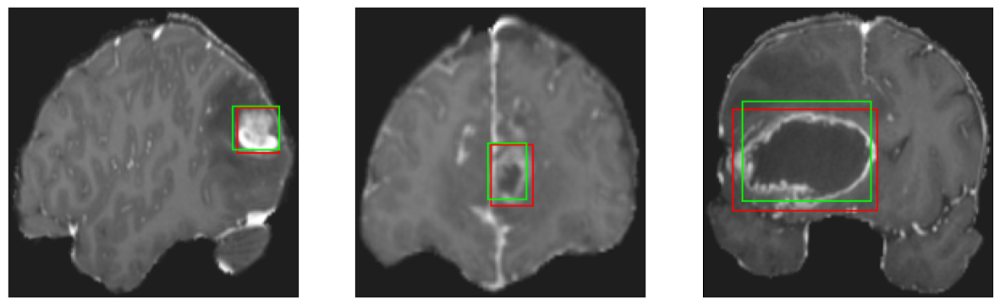

52/52 [==============================] - 7s 129ms/step - loss: 1.9071 - IoU: 0.8196 - val_loss: 4.8064 - val_IoU: 0.7007
Epoch 184/200
52/52 [==============================] - ETA: 0s - loss: 1.8534 - IoU: 0.8230
Epoch 184: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 34ms/step


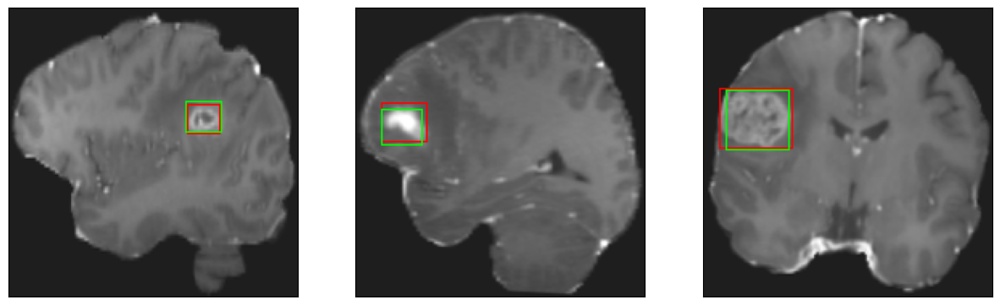

52/52 [==============================] - 7s 134ms/step - loss: 1.8534 - IoU: 0.8230 - val_loss: 4.6463 - val_IoU: 0.7132
Epoch 185/200
52/52 [==============================] - ETA: 0s - loss: 1.9409 - IoU: 0.8146
Epoch 185: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


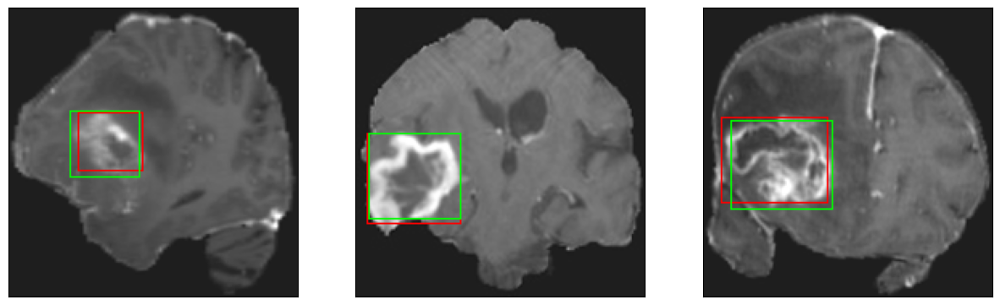

52/52 [==============================] - 8s 148ms/step - loss: 1.9409 - IoU: 0.8146 - val_loss: 4.6692 - val_IoU: 0.7140
Epoch 186/200
52/52 [==============================] - ETA: 0s - loss: 1.9246 - IoU: 0.8165
Epoch 186: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


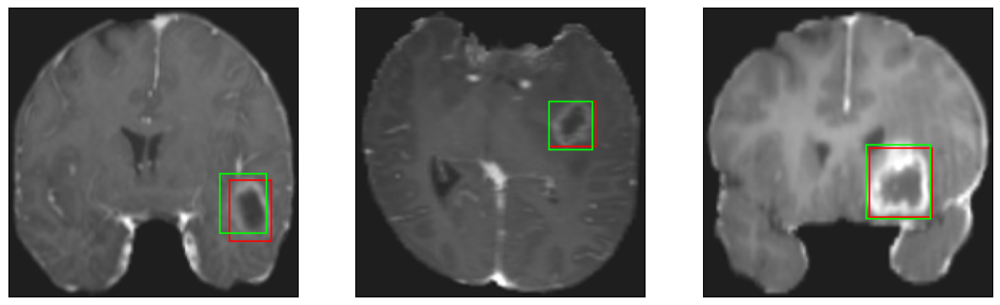

52/52 [==============================] - 7s 129ms/step - loss: 1.9246 - IoU: 0.8165 - val_loss: 4.5452 - val_IoU: 0.7215
Epoch 187/200
52/52 [==============================] - ETA: 0s - loss: 1.8881 - IoU: 0.8241
Epoch 187: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


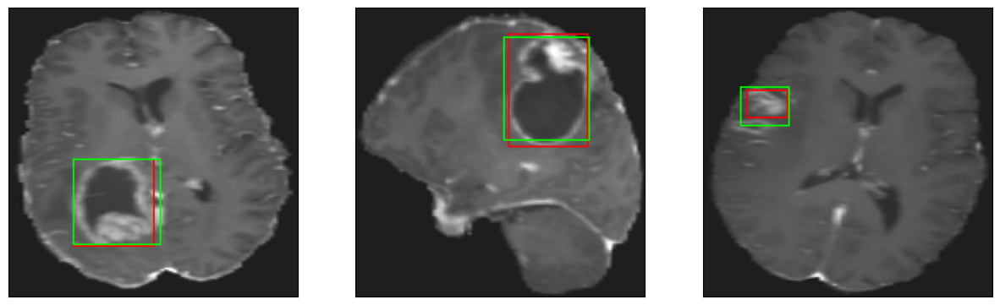

52/52 [==============================] - 6s 124ms/step - loss: 1.8881 - IoU: 0.8241 - val_loss: 4.7721 - val_IoU: 0.7022
Epoch 188/200
52/52 [==============================] - ETA: 0s - loss: 1.9551 - IoU: 0.8145
Epoch 188: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 30ms/step


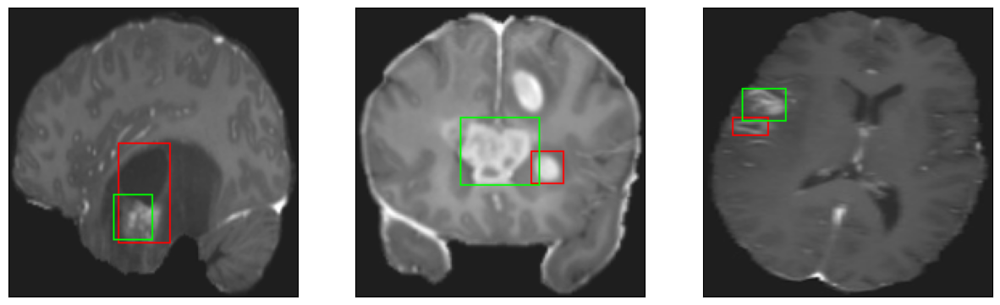

52/52 [==============================] - 7s 132ms/step - loss: 1.9551 - IoU: 0.8145 - val_loss: 4.8171 - val_IoU: 0.6869
Epoch 189/200
52/52 [==============================] - ETA: 0s - loss: 2.0217 - IoU: 0.8063
Epoch 189: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


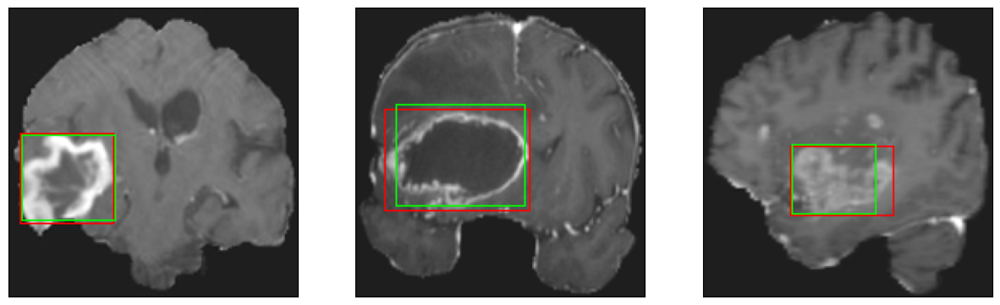

52/52 [==============================] - 7s 141ms/step - loss: 2.0217 - IoU: 0.8063 - val_loss: 4.8492 - val_IoU: 0.6950
Epoch 190/200
52/52 [==============================] - ETA: 0s - loss: 1.9587 - IoU: 0.8189
Epoch 190: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 30ms/step


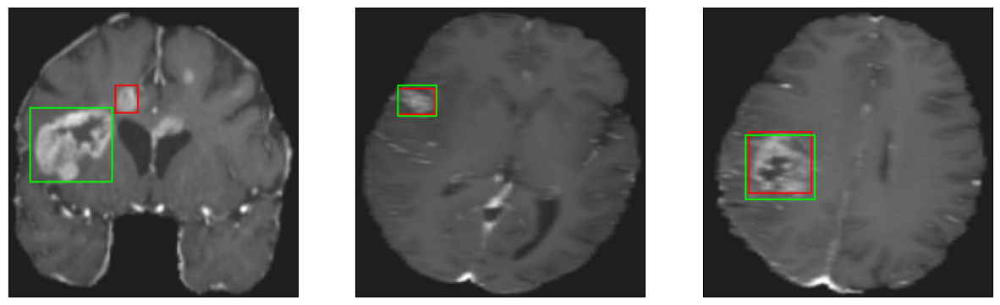

52/52 [==============================] - 7s 132ms/step - loss: 1.9587 - IoU: 0.8189 - val_loss: 5.1397 - val_IoU: 0.6726
Epoch 191/200
52/52 [==============================] - ETA: 0s - loss: 1.9530 - IoU: 0.8126
Epoch 191: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


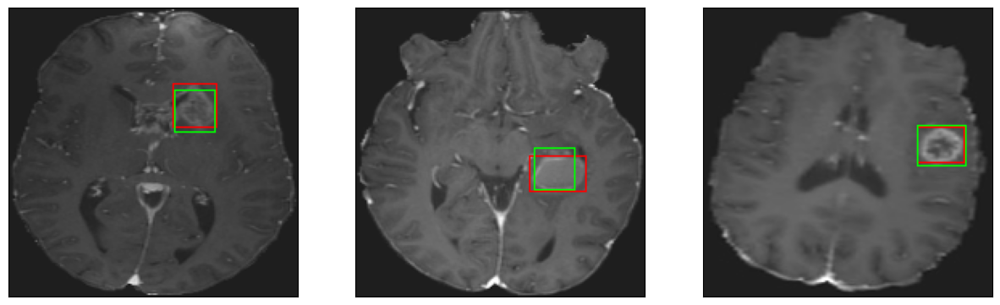

52/52 [==============================] - 8s 147ms/step - loss: 1.9530 - IoU: 0.8126 - val_loss: 4.6659 - val_IoU: 0.7153
Epoch 192/200
52/52 [==============================] - ETA: 0s - loss: 1.8579 - IoU: 0.8292
Epoch 192: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


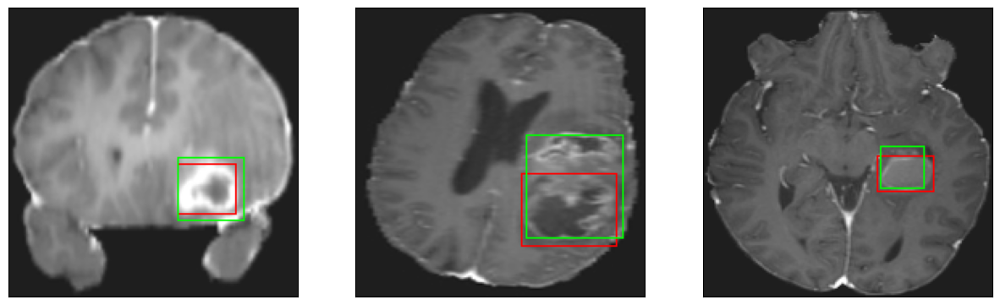

52/52 [==============================] - 7s 131ms/step - loss: 1.8579 - IoU: 0.8292 - val_loss: 4.6661 - val_IoU: 0.7015
Epoch 193/200
52/52 [==============================] - ETA: 0s - loss: 1.8961 - IoU: 0.8227
Epoch 193: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 32ms/step


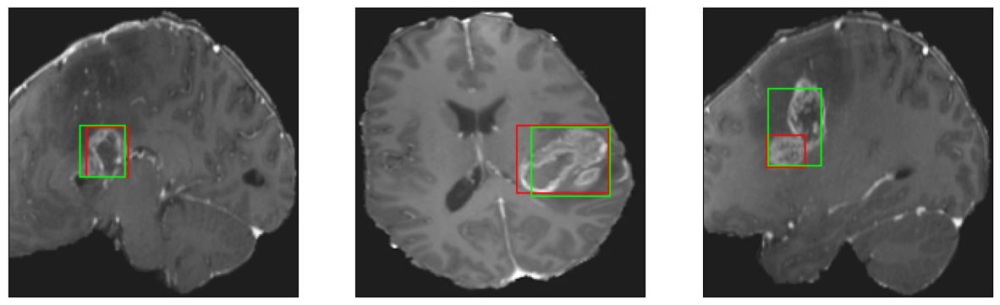

52/52 [==============================] - 8s 158ms/step - loss: 1.8961 - IoU: 0.8227 - val_loss: 4.6808 - val_IoU: 0.7071
Epoch 194/200
52/52 [==============================] - ETA: 0s - loss: 1.8807 - IoU: 0.8232
Epoch 194: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


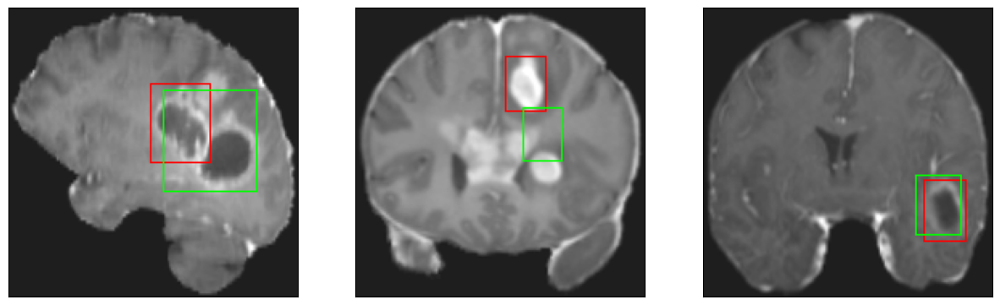

52/52 [==============================] - 7s 127ms/step - loss: 1.8807 - IoU: 0.8232 - val_loss: 4.4606 - val_IoU: 0.7277
Epoch 195/200
52/52 [==============================] - ETA: 0s - loss: 1.7550 - IoU: 0.8376
Epoch 195: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 30ms/step


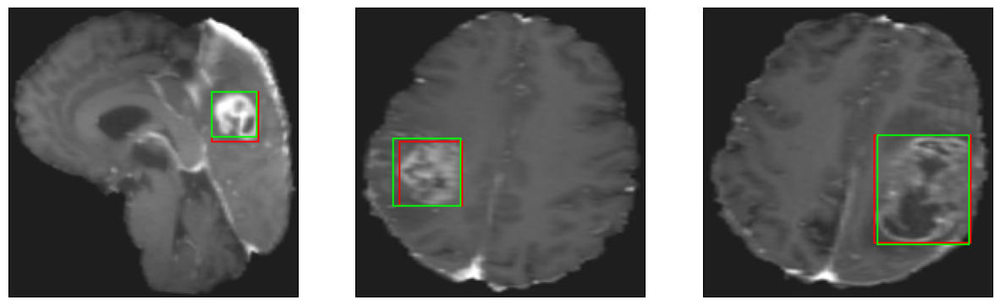

52/52 [==============================] - 7s 135ms/step - loss: 1.7550 - IoU: 0.8376 - val_loss: 4.4889 - val_IoU: 0.7169
Epoch 196/200
52/52 [==============================] - ETA: 0s - loss: 1.7929 - IoU: 0.8342
Epoch 196: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


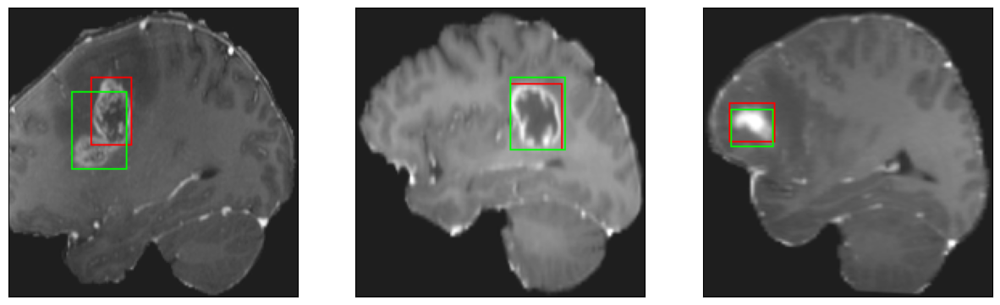

52/52 [==============================] - 7s 131ms/step - loss: 1.7929 - IoU: 0.8342 - val_loss: 4.8743 - val_IoU: 0.6984
Epoch 197/200
52/52 [==============================] - ETA: 0s - loss: 1.7867 - IoU: 0.8343
Epoch 197: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


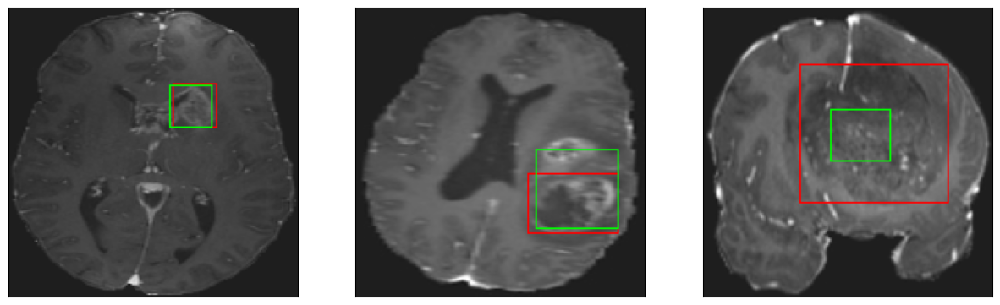

52/52 [==============================] - 7s 144ms/step - loss: 1.7867 - IoU: 0.8343 - val_loss: 4.4208 - val_IoU: 0.7247
Epoch 198/200
52/52 [==============================] - ETA: 0s - loss: 1.8679 - IoU: 0.8265
Epoch 198: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


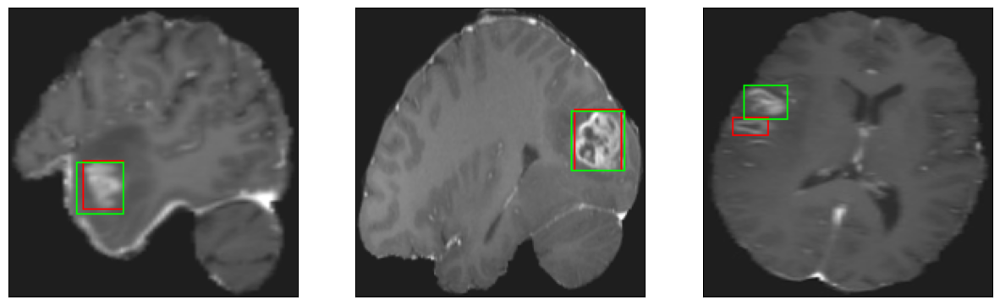

52/52 [==============================] - 7s 133ms/step - loss: 1.8679 - IoU: 0.8265 - val_loss: 4.5710 - val_IoU: 0.7117
Epoch 199/200
52/52 [==============================] - ETA: 0s - loss: 1.8423 - IoU: 0.8284
Epoch 199: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 31ms/step


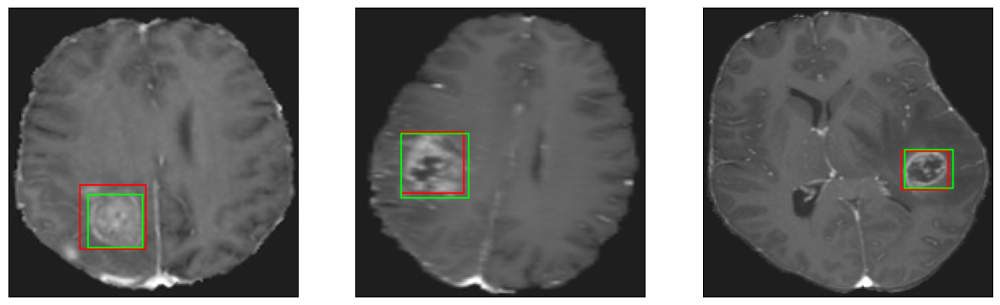

52/52 [==============================] - 8s 147ms/step - loss: 1.8423 - IoU: 0.8284 - val_loss: 4.4502 - val_IoU: 0.7119
Epoch 200/200
52/52 [==============================] - ETA: 0s - loss: 1.8630 - IoU: 0.8268
Epoch 200: val_loss did not improve from 4.40528
8/8 [==============================] - 0s 33ms/step


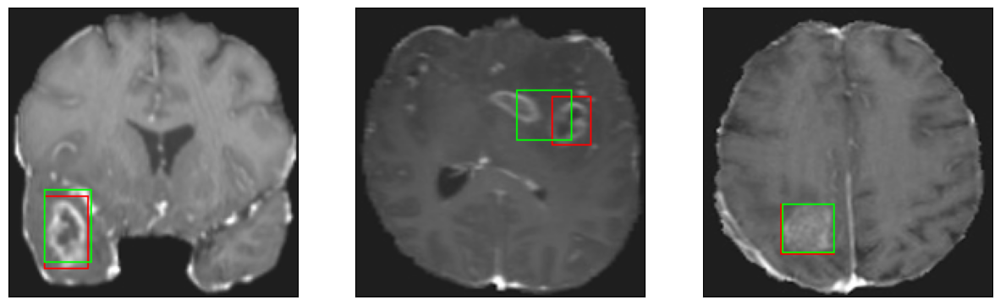

52/52 [==============================] - 7s 135ms/step - loss: 1.8630 - IoU: 0.8268 - val_loss: 4.4253 - val_IoU: 0.7209


In [26]:
model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [27]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
        
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])


In [32]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_EFFNET/model_EFFNET.h5',compile = False)

In [33]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [34]:
model.evaluate(test_dataset)

15/15 [==============================] - 5s 42ms/step - loss: 4.4975 - IoU: 0.6911


[4.497518539428711, 0.6910569071769714]

In [31]:
model.history